# Use spectra of CTIO Data in June 2017 to do atmospheric studies
==================================================================================================
## Look at equivalent width

- author : Sylvie Dagoret-Campagne
- date   : July 5th 2017

This notebook is supposed to perform an atmospheric properties measurement on spectra

In [437]:
%%javascript
var kernel = IPython.notebook.kernel;
var thename = window.document.getElementById("notebook_name").innerHTML;
var command = "theNotebook = " + "'"+thename+"'";
kernel.execute(command);

<IPython.core.display.Javascript object>

In [438]:
print theNotebook

AnaEqWdtCalibSpectrum


In [439]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import matplotlib as mpl
from astropy.modeling import models
from astropy import units as u
from astropy import nddata
from astropy.io import fits
import re
import os
import pandas as pd

In [440]:
from matplotlib.backends.backend_pdf import PdfPages

In [441]:
import ccdproc
print 'ccdproc version',ccdproc.__version__

from astropy.modeling import models

ccdproc version 1.0.1


In [442]:
from scipy import stats  
from scipy import ndimage
from datetime import datetime, timedelta
from mpl_toolkits.mplot3d import Axes3D
import scipy.signal
from scipy.interpolate import interp1d

In [443]:
from scipy.optimize import curve_fit

In [444]:
import bottleneck as bn  # numpy's masked median is slow...really slow (in version 1.8.1 and lower)
print 'bottleneck version',bn.__version__

bottleneck version 1.2.0


In [445]:
import photutils
from astropy.stats import sigma_clipped_stats
from photutils import daofind
from photutils import CircularAperture
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
#from photutils.background import Background2D
from photutils import Background2D, SigmaClip, MedianBackground

In [446]:
import sys
sys.path.append("../../common_tools/")
from holo_specs import *

In [447]:
%load_ext Cython

The Cython extension is already loaded. To reload it, use:
  %reload_ext Cython


In [448]:
from IPython.display import Image, display

In [449]:
import matplotlib
matplotlib.rc('xtick', labelsize=20) 
matplotlib.rc('ytick', labelsize=20) 

In [450]:
# to enlarge the sizes
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (10, 10),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

In [451]:
%config InlineBackend.rc = {}
matplotlib.rc_file("../../templates/matplotlibrc")

In [452]:
from scipy.interpolate import interp1d

In [453]:
import datetime
from dateutil import parser  # very usefull time format smart parser

In [454]:
from matplotlib.dates import MonthLocator, WeekdayLocator,DateFormatter
from matplotlib.dates import MONDAY

In [455]:
mondays = WeekdayLocator(MONDAY)
months = MonthLocator(range(1, 13), bymonthday=1, interval=1)
monthsFmt = DateFormatter("%b '%y")

In [456]:
import matplotlib.dates as mdates

years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
days=mdates.DayLocator()  # every day
hour=mdates.HourLocator()  # every day
yearsFmt = mdates.DateFormatter('%Y')

In [457]:
# to enlarge the sizes
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (4, 4),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

In [458]:
############################################################################
def ensure_dir(f):
    d = os.path.dirname(f)
    if not os.path.exists(f):
        os.makedirs(f)
#########################################################################

## Config

In [459]:
inputdir="./spectrum_calibspec"
MIN_IMGNUMBER=144
MAX_IMGNUMBER=357
object_name='HD205905 Jun 08th 2017'
object_name_sim='HD205905_Jun_08th'
SelectTagRe='^calibSpectra_20170608_([0-9]+).fits$' # regular expression to select the file
SearchTagRe='^calibSpectra_20170608_[0-9]+.fits$'
NBIMGPERROW=2

### Input sim files

In [460]:
inputsimfitsfile='AllSimSpectra_'+object_name_sim+'.fits'

### Output files

In [461]:
outputdir="./spectrum_eqwana"

In [462]:
ensure_dir(outputdir)

In [463]:
output_file='AnaEqWdtFromSpectra_'+object_name_sim+'.csv'

In [464]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images

In [465]:
ensure_dir(dir_top_images) # create that directory

## Location of calibrated spectra and Simulations
----------------------------------

### Input simulation files

In [466]:
hdu_list=fits.open(inputsimfitsfile)
header=hdu_list[0].header
print header
simspectra_data=hdu_list[0].data

SIMPLE  =                    T / conforms to FITS standard                      BITPIX  =                  -64 / array data type                                NAXIS   =                    2 / number of array dimensions                     NAXIS1  =                 4839                                                  NAXIS2  =                   54                                                  EXTEND  =                    T                                                  END                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                     

In [467]:
print simspectra_data.shape

(54, 4839)


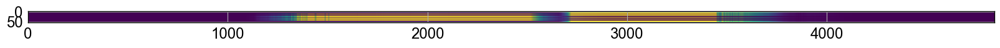

In [468]:
plt.figure(figsize=(20,20))
plt.imshow(simspectra_data[:,:],vmin=0,vmax=1e-12)
plt.xmin=(0.,10000.)

### Make tables

In [469]:
allspectra_sim=simspectra_data[1:,:]
thewl_sim=simspectra_data[0,:]

In [470]:
NBSPECSIM=allspectra_sim.shape[0]

In [471]:
allwl_sim = [thewl_sim for _ in range(NBSPECSIM)]

In [472]:
allwl_sim =np.array(allwl_sim )

In [473]:
allwl_sim=allwl_sim/10.

In [474]:
print NBSPECSIM

53


(0.0, 1000.0)

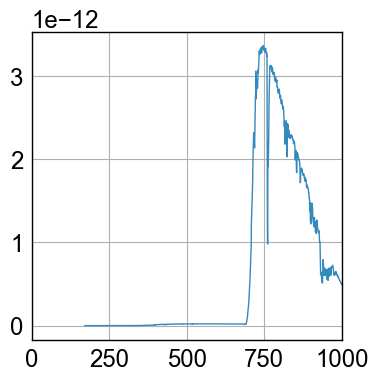

In [475]:
sel=1
plt.plot(allwl_sim[sel],allspectra_sim[sel])
plt.xlim(0.,1000.)

### Input data files

In [476]:
input_filelist=os.listdir(inputdir) 

In [477]:
if '.DS_Store' in input_filelist:
    input_filelist.remove('.DS_Store')
input_filelist=np.array(input_filelist)

In [478]:
print input_filelist[0:5]

['calibSpectra_20170608_155.fits' 'calibSpectra_20170608_159.fits'
 'calibSpectra_20170608_160.fits' 'calibSpectra_20170608_161.fits'
 'calibSpectra_20170608_162.fits']


In [479]:
indexes_files= [] # global list
filelist_fitsimages= []  # global list

In [480]:
#%%cython

import numpy as np
import re

def MakeFileList(inputdir,input_filelist):
    """
    MakeFileList : Make The List of files to open
    =============
    """
    
#    import numpy as np
#    import re
    indexes_files= [] # global list
    filelist_fitsimages= []  # global list
    
    for file in input_filelist: # loop on directories, one per image       
            filename=inputdir+'/'+file 
            
            if re.search('.*fits$',filename):  #example of filename filter
                
                num_str=re.findall(SelectTagRe,file)[0]
               
                index=int(num_str)
                filelist_fitsimages.append(filename)
                indexes_files.append(index)   
                
                
    return indexes_files, filelist_fitsimages

In [481]:
indexes_files, filelist_fitsimages=MakeFileList(inputdir,input_filelist)   # filter to select fits file only

In [482]:
# transform into numpy arrays
indexes_files=np.array(indexes_files)
filelist_fitsimages=np.array(filelist_fitsimages)

In [483]:
print indexes_files

[155 159 160 161 162 165 167 173 176 183 185 189 190 193 196 197 198 209
 213 215 221 226 231 242 244 246 247 251 254 256 258 262 263 274 275 276
 283 286 289 296 297 298 302 318 319 321 322 323 327 336 346 348 357]


In [484]:
sorted_indexes=np.argsort(indexes_files) # sort the file indexes

In [485]:
sorted_numbers=indexes_files[sorted_indexes]

In [486]:
print sorted_indexes

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49
 50 51 52]


In [487]:
#sorted_files= [filelist_fitsimages[index] for index in sorted_indexes] # sort files
sorted_files=filelist_fitsimages[sorted_indexes]

In [488]:
sorted_files[0:5]

array(['./spectrum_calibspec/calibSpectra_20170608_155.fits',
       './spectrum_calibspec/calibSpectra_20170608_159.fits',
       './spectrum_calibspec/calibSpectra_20170608_160.fits',
       './spectrum_calibspec/calibSpectra_20170608_161.fits',
       './spectrum_calibspec/calibSpectra_20170608_162.fits'], 
      dtype='|S51')

## Build full filename
----------------------------

In [489]:
sorted_filenames=[]
for file in sorted_files:
    #fullfilename=os.path.join(inputdir,file)
    fullfilename=file
    sorted_filenames.append(fullfilename)

In [490]:
#sorted_filenames=np.array(sorted_filenames)
sorted_filenames=np.copy(sorted_files)

In [491]:
print sorted_filenames.shape

(53,)


## Acces to spectrum data
----------------------------------

In [492]:
%%cython

import numpy as np
from astropy.io import fits

def BuildCalibSpec(sorted_filenames,sorted_numbers,object_name):
    """
    BuildRawSpec
    ===============
    """

    all_dates = []
    all_airmass = []
    all_leftspectra_data = []
    all_rightspectra_data = []
    all_totleftspectra_data = []
    all_totrightspectra_data = []
    all_leftspectra_data_staterr = []
    all_rightspectra_data_staterr = []
    
    all_leftspectra_wl = []
    all_rightspectra_wl = []
    
    all_titles = []
    all_header = []
    all_expo = []
    all_filt= []
    all_filt1= []
    all_filt2= []
    all_hum = []
    
    all_elecgain = []
    
    NBFILES=sorted_filenames.shape[0]

    for idx in range(NBFILES):  
        
        file=sorted_filenames[idx]    
        
        hdu_list=fits.open(file)
        
        #hdu_list.info()
        
        header=hdu_list[0].header
        #print header
        date_obs = header['DATE-OBS']
        airmass = header['AIRMASS']
        expo = header['EXPTIME']
        num=sorted_numbers[idx]
        title=object_name+" z= {:3.2f} Nb={}".format(float(airmass),num)
        filters = header['FILTERS'].split(' ')[1]
        filters1= header['FILTER1']
        filters2= header['FILTER2']
        filters= filters1 + ' + ' + filters2
        hum= float(header['OUTHUM'])
        gain = 0.25*(float(header['GTGAIN11'])+float(header['GTGAIN12'])+float(header['GTGAIN21'])+float(header['GTGAIN22']))
        
        # now reads the spectra
        
        table_data=hdu_list[1].data
        
        if idx==0:
            cols = hdu_list[1].columns
            cols.info()
            print hdu_list[1].columns
            cols.names
     
    
        left_spectrum_wl=table_data.field('CalibLeftSpecWL')
        left_spectrum_data=table_data.field('CalibLeftSpec')
        left_totspectrum_data=table_data.field('CalibTotLeftSpec')
        left_spectrum_data_staterr=table_data.field('CalibStatErrorLeftSpec')
        
        right_spectrum_wl=table_data.field('CalibRightSpecWL')
        right_spectrum_data=table_data.field('CalibRightSpec')
        right_totspectrum_data=table_data.field('CalibTotRightSpec')
        right_spectrum_data_staterr=table_data.field('CalibStatErrorRightSpec')
        
       
        
        all_dates.append(date_obs)
        all_airmass.append(float(airmass))
        
        all_leftspectra_data.append(left_spectrum_data)
        all_rightspectra_data.append(right_spectrum_data)
        
        all_totleftspectra_data.append(left_totspectrum_data)
        all_totrightspectra_data.append(right_totspectrum_data)
        
        all_leftspectra_data_staterr.append(left_spectrum_data_staterr)
        all_rightspectra_data_staterr.append(right_spectrum_data_staterr)
        
        all_leftspectra_wl.append(left_spectrum_wl)
        all_rightspectra_wl.append(right_spectrum_wl)
        
       
        
        all_titles.append(title)
        all_header.append(header)
        all_expo.append(expo)
        
        all_filt.append(filters)
        all_filt1.append(filters1)
        all_filt2.append(filters2)
        all_hum.append(hum)
        all_elecgain.append(gain)
        
            
        hdu_list.close()
        
        
        
        
    return all_dates,all_airmass,all_titles,all_header,all_expo, all_leftspectra_data,all_rightspectra_data,all_totleftspectra_data,all_totrightspectra_data, all_leftspectra_data_staterr,all_rightspectra_data_staterr,all_leftspectra_wl,all_rightspectra_wl,all_filt,all_filt1,all_filt2,all_hum,all_elecgain

In [493]:
all_dates,all_airmass,all_titles,all_header,all_expo,all_leftspectra_data,all_rightspectra_data,all_totleftspectra_data,all_totrightspectra_data,all_leftspectra_data_staterr,all_rightspectra_data_staterr,all_leftspectra_wl,all_rightspectra_wl,all_filt,all_filt1,all_filt2,all_hum,all_gainelec=BuildCalibSpec(sorted_files,sorted_numbers,object_name)

name:
    ['CalibLeftSpecWL', 'CalibLeftSpec', 'CalibTotLeftSpec', 'CalibRightSpecWL', 'CalibRightSpec', 'CalibTotRightSpec', 'CalibStatErrorLeftSpec', 'CalibStatErrorRightSpec']
format:
    ['E', 'E', 'E', 'E', 'E', 'E', 'E', 'E']
unit:
    ['', '', '', '', '', '', '', '']
null:
    ['', '', '', '', '', '', '', '']
bscale:
    ['', '', '', '', '', '', '', '']
bzero:
    ['', '', '', '', '', '', '', '']
disp:
    ['', '', '', '', '', '', '', '']
start:
    ['', '', '', '', '', '', '', '']
dim:
    ['', '', '', '', '', '', '', '']
ColDefs(
    name = 'CalibLeftSpecWL'; format = 'E'
    name = 'CalibLeftSpec'; format = 'E'
    name = 'CalibTotLeftSpec'; format = 'E'
    name = 'CalibRightSpecWL'; format = 'E'
    name = 'CalibRightSpec'; format = 'E'
    name = 'CalibTotRightSpec'; format = 'E'
    name = 'CalibStatErrorLeftSpec'; format = 'E'
    name = 'CalibStatErrorRightSpec'; format = 'E'
)


In [494]:
NDATA=len(all_dates)

In [495]:
print NDATA

53


In [496]:
all_dt=all_dates

In [497]:
Thor300_index=np.where(np.array(all_filt2) == 'Thor300')[0]
Ron400_index=np.where(np.array(all_filt2) == 'Ron400')[0]
Ron200_index=np.where(np.array(all_filt2) == 'Ron200')[0]
HoloPhP_index=np.where(np.array(all_filt2) == 'HoloPhP')[0]
HoloPhAg_index=np.where(np.array(all_filt2) == 'HoloPhAg')[0]
HoloAmAg_index=np.where(np.array(all_filt2) == 'HoloAmAg')[0]

In [498]:
print Thor300_index
print Ron400_index
print Ron200_index
print HoloPhP_index
print HoloPhAg_index
print HoloAmAg_index

[ 6  8 14 15 21 25 26 29 35 37 39 40 48 49 50 52]
[]
[ 0  5 10 19 24 28 33 34]
[ 1 11 16 17 30 38 41 43 44 51]
[ 2  3 12 20 22 27 45]
[ 4  7  9 13 18 23 31 32 36 42 46 47]


In [499]:
print all_expo


[15.0, 15.0, 30.0, 30.0, 30.0, 15.0, 15.0, 30.0, 15.0, 30.0, 15.0, 15.0, 30.0, 30.0, 15.0, 15.0, 15.0, 15.0, 30.0, 15.0, 30.0, 15.0, 30.0, 30.0, 15.0, 15.0, 15.0, 30.0, 15.0, 15.0, 15.0, 30.0, 30.0, 15.0, 15.0, 15.0, 30.0, 15.0, 15.0, 15.0, 15.0, 15.0, 30.0, 15.0, 15.0, 30.0, 30.0, 30.0, 15.0, 15.0, 15.0, 15.0, 15.0]


In [500]:
print all_filt1

['RG715', 'RG715', 'FGB37', 'RG715', 'FGB37', 'RG715', 'RG715', 'RG715', 'FGB37', 'RG715', 'RG715', 'RG715', 'FGB37', 'RG715', 'FGB37', 'RG715', 'FGB37', 'RG715', 'RG715', 'RG715', 'RG715', 'FGB37', 'RG715', 'FGB37', 'FGB37', 'FGB37', 'RG715', 'RG715', 'FGB37', 'FGB37', 'FGB37', 'FGB37', 'RG715', 'FGB37', 'RG715', 'FGB37', 'RG715', 'FGB37', 'RG715', 'FGB37', 'RG715', 'FGB37', 'FGB37', 'FGB37', 'RG715', 'RG715', 'FGB37', 'RG715', 'RG715', 'FGB37', 'FGB37', 'FGB37', 'RG715']


In [501]:
print all_filt2

['Ron200', 'HoloPhP', 'HoloPhAg', 'HoloPhAg', 'HoloAmAg', 'Ron200', 'Thor300', 'HoloAmAg', 'Thor300', 'HoloAmAg', 'Ron200', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'Thor300', 'HoloPhP', 'HoloPhP', 'HoloAmAg', 'Ron200', 'HoloPhAg', 'Thor300', 'HoloPhAg', 'HoloAmAg', 'Ron200', 'Thor300', 'Thor300', 'HoloPhAg', 'Ron200', 'Thor300', 'HoloPhP', 'HoloAmAg', 'HoloAmAg', 'Ron200', 'Ron200', 'Thor300', 'HoloAmAg', 'Thor300', 'HoloPhP', 'Thor300', 'Thor300', 'HoloPhP', 'HoloAmAg', 'HoloPhP', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'HoloAmAg', 'Thor300', 'Thor300', 'Thor300', 'HoloPhP', 'Thor300']


In [502]:
print all_filt

['RG715 + Ron200', 'RG715 + HoloPhP', 'FGB37 + HoloPhAg', 'RG715 + HoloPhAg', 'FGB37 + HoloAmAg', 'RG715 + Ron200', 'RG715 + Thor300', 'RG715 + HoloAmAg', 'FGB37 + Thor300', 'RG715 + HoloAmAg', 'RG715 + Ron200', 'RG715 + HoloPhP', 'FGB37 + HoloPhAg', 'RG715 + HoloAmAg', 'FGB37 + Thor300', 'RG715 + Thor300', 'FGB37 + HoloPhP', 'RG715 + HoloPhP', 'RG715 + HoloAmAg', 'RG715 + Ron200', 'RG715 + HoloPhAg', 'FGB37 + Thor300', 'RG715 + HoloPhAg', 'FGB37 + HoloAmAg', 'FGB37 + Ron200', 'FGB37 + Thor300', 'RG715 + Thor300', 'RG715 + HoloPhAg', 'FGB37 + Ron200', 'FGB37 + Thor300', 'FGB37 + HoloPhP', 'FGB37 + HoloAmAg', 'RG715 + HoloAmAg', 'FGB37 + Ron200', 'RG715 + Ron200', 'FGB37 + Thor300', 'RG715 + HoloAmAg', 'FGB37 + Thor300', 'RG715 + HoloPhP', 'FGB37 + Thor300', 'RG715 + Thor300', 'FGB37 + HoloPhP', 'FGB37 + HoloAmAg', 'FGB37 + HoloPhP', 'RG715 + HoloPhP', 'RG715 + HoloPhAg', 'FGB37 + HoloAmAg', 'RG715 + HoloAmAg', 'RG715 + Thor300', 'FGB37 + Thor300', 'FGB37 + Thor300', 'FGB37 + HoloPhP', 

## Airmasses

In [503]:
NDATA=len(all_rightspectra_data)
all_dt= [ parser.parse(all_dates[i]) for i in range(NDATA)]

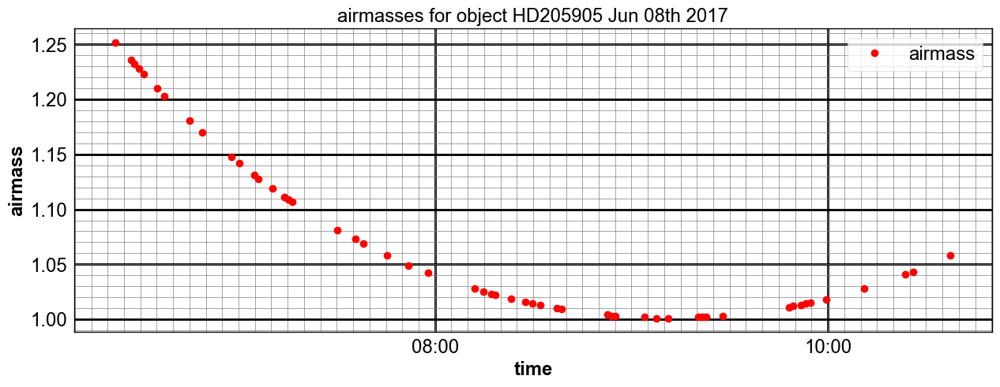

In [504]:
fig=plt.figure(figsize=(15,5))

ax=fig.add_subplot(1,1,1)
ax.plot_date(all_dt, all_airmass,marker='o',color='red',lw=0,label='airmass',linewidth=3)
#ax.plot_date(all_dt, am,marker='.',color='blue',lw=0,label='relative airmass',linewidth=3)

#ax.set_ylim(0.,2)

date_range = all_dt[NDATA-1] - all_dt[0]

if date_range > datetime.timedelta(days = 1):
    ax.xaxis.set_major_locator(mdates.DayLocator(bymonthday=range(1,32), interval=1))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    ax.get_xaxis().set_minor_locator(mdates.HourLocator(byhour=range(0,24,2)))
    #ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
else:
    ax.xaxis.set_major_locator(mdates.HourLocator(byhour=range(0,24,2)))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
    #ax.get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    ax.get_xaxis().set_minor_locator(mdates.MinuteLocator(byminute=range(0,60,5)))
    
ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())

ax.grid(b=True, which='major', color='k', linewidth=2.0)
ax.grid(b=True, which='minor', color='grey', linewidth=0.5)
ax.set_ylabel('airmass')
ax.set_xlabel('time')


title='airmasses for object {}'.format(object_name)

plt.title(title)
plt.legend(loc='best')

figfilename=os.path.join(dir_top_images,'airmass_vs_time.pdf')
fig.savefig(figfilename)

## Dispersers

In [505]:
ListOfDisperserNames=['Ron200', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg']

## Show Spectra
-----------------------

In [506]:
%%cython
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import math as m
import os

from matplotlib.backends.backend_pdf import PdfPages
    
def ShowSpectrawithBG(all_spectra,all_totspectra,all_wl,all_titles,object_name,all_filt,all_filt1,dir_top_img):
    """
    ShowSpectra: Show the raw images without background subtraction
    ==============
    """
    NBSPEC=len(all_spectra)
    NBIMGPERROW=2
    MAXIMGROW=max(2,m.ceil(NBSPEC/NBIMGPERROW))
    #MAXIMGROW=int(MAXIMGROW)
        
    
     # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    
    figfilename=os.path.join(dir_top_img,'intput_calibrated_spectra_withBG.pdf')
    pp = PdfPages(figfilename) # create a pdf file
    
    title='Calibrated spectra for {}'.format(object_name)
         
    thex0 = []  # container of central position   
        
    
    for index in np.arange(0,NBSPEC):
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20,fontweight='bold')
            
        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        
        spectrum=all_spectra[index]
        spectrum2=all_totspectra[index]
       
        wl=all_wl[index]
        axarr[iy,ix].plot(wl,spectrum,'r-',lw=2,label='data')
        axarr[iy,ix].plot(wl,spectrum2,'k:',lw=2,label='data with BG')
        
        
        max_y_to_plot=spectrum[:].max()*1.2
        axarr[iy,ix].set_ylim(0.,max_y_to_plot)
        
        axarr[iy,ix].text(0.,max_y_to_plot*1.1/1.2, all_filt[index],verticalalignment='top', horizontalalignment='left',color='blue',fontweight='bold', fontsize=20)
       
        axarr[iy,ix].set_title(all_titles[index])
        #axarr[iy,ix].set_title(all_filt[index])
        axarr[iy,ix].set_xlabel("wavelength (nm)")
        
        axarr[iy,ix].get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
        axarr[iy,ix].get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
        axarr[iy,ix].grid(b=True, which='major', color='k', linewidth=2.0)
        axarr[iy,ix].grid(b=True, which='minor', color='grey', linewidth=0.5)
      
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
        
          
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()
    

In [507]:
%%cython
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import math as m
import os,re

from matplotlib.backends.backend_pdf import PdfPages
 
#NormSpecRange= [790,810] # range where to normalize

NormSpecRange2= [790,810] # range where to normalize
NormSpecRange1= [590,610] # range where to normalize

def ShowSpectra(all_spectra,all_wl,all_titles,object_name,all_filt,all_filt1,dir_top_img,sim_data):
    """
    ShowSpectra: Show the raw images without background subtraction
    ==============
    """
    NBSPEC=len(all_spectra)
    NBIMGPERROW=2
    MAXIMGROW=max(2,m.ceil(NBSPEC/NBIMGPERROW))
    #MAXIMGROW=int(MAXIMGROW)
        

    calibdatasimfactor = []    
        
        
     # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    
    figfilename=os.path.join(dir_top_img,'intput_calibrated_spectra.pdf')
    pp = PdfPages(figfilename) # create a pdf file
    
    title='Calibrated spectra for {}'.format(object_name)
         
    thex0 = []  # container of central position   
    wl_sim=sim_data[0]/10.
    
    for index in np.arange(0,NBSPEC):
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20,fontweight='bold')
 
  


        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        wl=all_wl[index]  # wavelength in data
        
        spectrum=all_spectra[index]   # data
        
        #maxdata_in_range=np.max(spectrum[np.where(np.logical_and(wl>NormSpecRange[0],wl<NormSpecRange[1]))]) # max in data in selected wl range
        
        
        spectrum_sim=sim_data[index+1] # sim
        
        if re.search('.* RG175.*',all_filt1[index]):
            print 'found RG175 : ',all_filt1[index]
            maxdata_in_range=np.max(spectrum[np.where(np.logical_and(wl>NormSpecRange2[0],wl<NormSpecRange2[1]))]) # max in data in selected wl range
            maxsim_in_range=np.max(spectrum_sim[np.where(np.logical_and(wl_sim>NormSpecRange2[0],wl_sim<NormSpecRange2[1]))]) # max in sim in selected wl range
        elif all_filt1[index]=='RG175':
            print 'found RG175 : ',all_filt1[index]
            maxdata_in_range=np.max(spectrum[np.where(np.logical_and(wl>NormSpecRange2[0],wl<NormSpecRange2[1]))]) # max in data in selected wl range
            maxsim_in_range=np.max(spectrum_sim[np.where(np.logical_and(wl_sim>NormSpecRange2[0],wl_sim<NormSpecRange2[1]))]) # max in sim in selected wl range
        elif re.search('.* FGB37.*',all_filt1[index]):
            print 'found FGB37 : ',all_filt1[index]
            maxdata_in_range=np.max(spectrum[np.where(np.logical_and(wl>NormSpecRange1[0],wl<NormSpecRange1[1]))]) # max in data in selected wl range
            maxsim_in_range=np.max(spectrum_sim[np.where(np.logical_and(wl_sim>NormSpecRange1[0],wl_sim<NormSpecRange1[1]))]) # max in sim in selected wl range
        elif all_filt1[index]=='FGB37':
            print 'found FGB37 : ',all_filt1[index]
            maxdata_in_range=np.max(spectrum[np.where(np.logical_and(wl>NormSpecRange1[0],wl<NormSpecRange1[1]))]) # max in data in selected wl range
            maxsim_in_range=np.max(spectrum_sim[np.where(np.logical_and(wl_sim>NormSpecRange1[0],wl_sim<NormSpecRange1[1]))]) # max in sim in selected wl range
        else:
            print 'Filter Not found ::', all_filt1[index]
            maxdata_in_range=np.max(spectrum[np.where(np.logical_and(wl>NormSpecRange2[0],wl<NormSpecRange2[1]))]) # max in data in selected wl range
            maxsim_in_range=np.max(spectrum_sim[np.where(np.logical_and(wl_sim>NormSpecRange2[0],wl_sim<NormSpecRange2[1]))]) # max in sim in selected wl range
        
        #maxsim_in_range=np.max(spectrum_sim[np.where(np.logical_and(wl_sim>NormSpecRange[0],wl_sim<NormSpecRange[1]))]) # max in sim in selected wl range
        
        calibfactor=maxdata_in_range/maxsim_in_range   # calib factor data/sim in wl range
        
        calibdatasimfactor.append(calibfactor) # for later analysis
        
       
        axarr[iy,ix].plot(wl,spectrum,'r-',lw=2,label='data') # plot data
        
        
        spectrum_sim=spectrum_sim*calibfactor  # renormalize the sim to data units
        
        axarr[iy,ix].plot(wl_sim,spectrum_sim,'b-',lw=2,label='sim')
        
        max_y_to_plot=spectrum[:].max()*1.4
        axarr[iy,ix].set_ylim(0.,max_y_to_plot)
       
        axarr[iy,ix].set_xlim(0.,1200.)
        axarr[iy,ix].text(0.,max_y_to_plot*1.1/1.4, all_filt[index],verticalalignment='top', horizontalalignment='left',color='blue',fontweight='bold', fontsize=20)
       
        axarr[iy,ix].set_title(all_titles[index])
        #axarr[iy,ix].set_title(all_filt[index])
        axarr[iy,ix].set_xlabel("wavelength (nm)")
        
        axarr[iy,ix].get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
        axarr[iy,ix].get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
        axarr[iy,ix].grid(b=True, which='major', color='k', linewidth=2.0)
        axarr[iy,ix].grid(b=True, which='minor', color='grey', linewidth=0.5)
      
        axarr[iy,ix].legend()
        
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
            
                
          
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()
    return np.array(calibdatasimfactor)
    

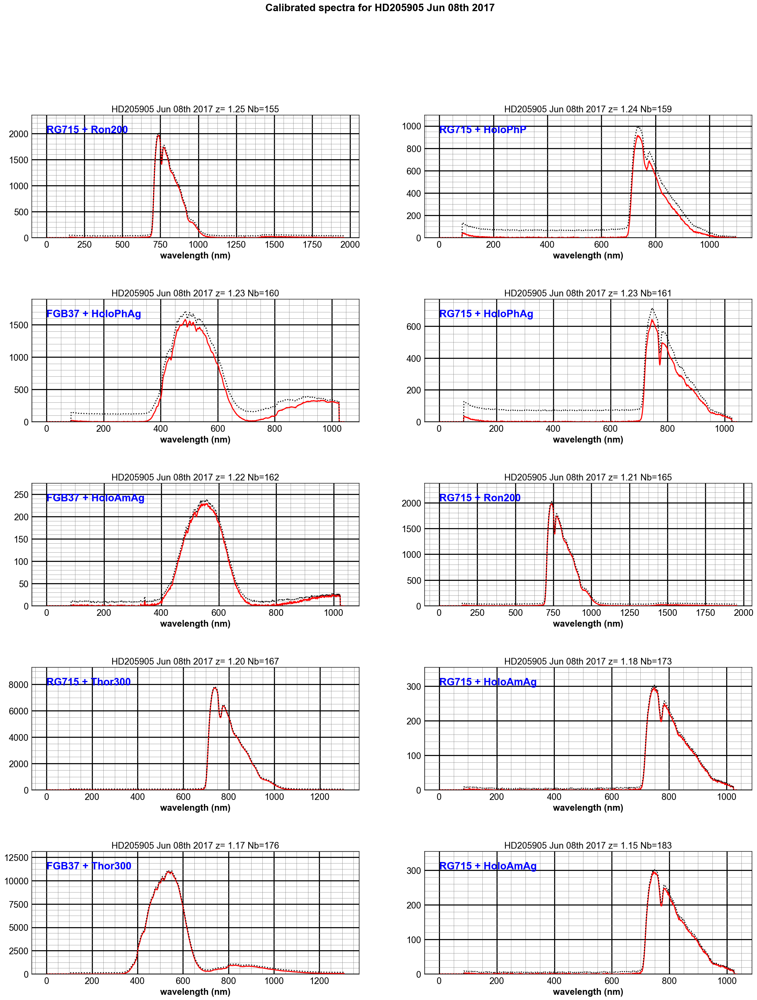

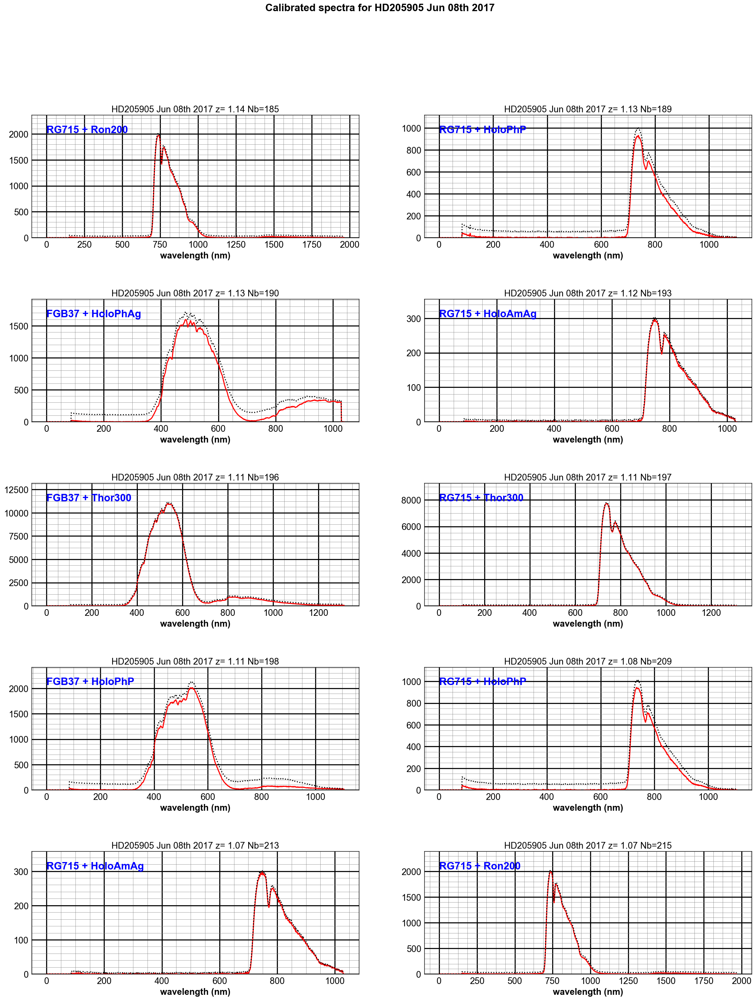

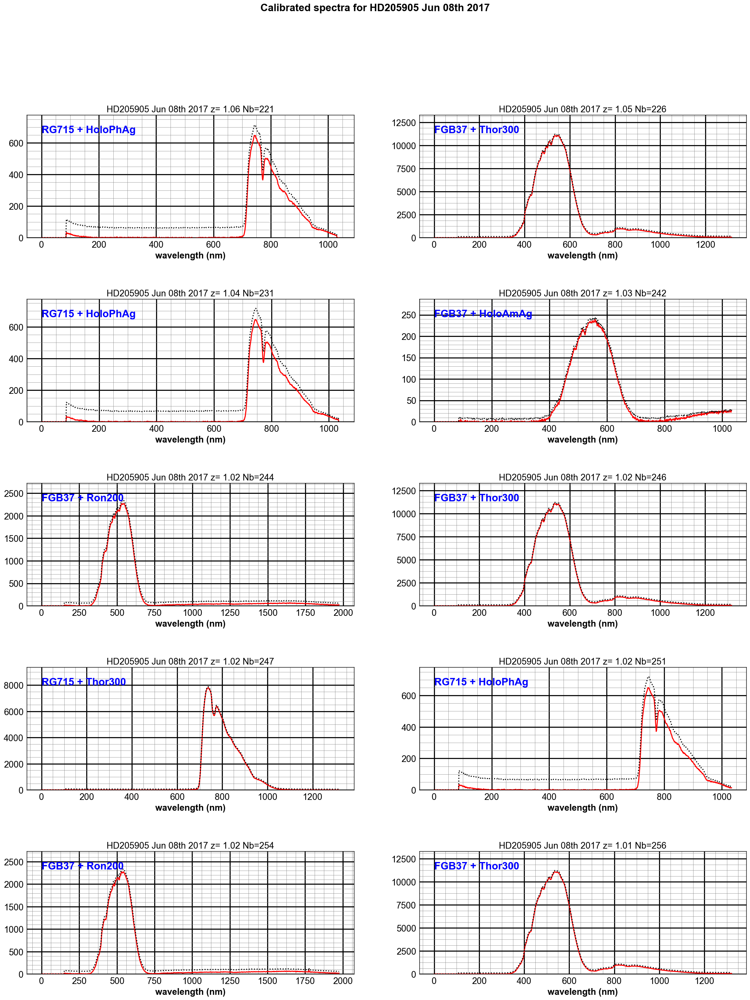

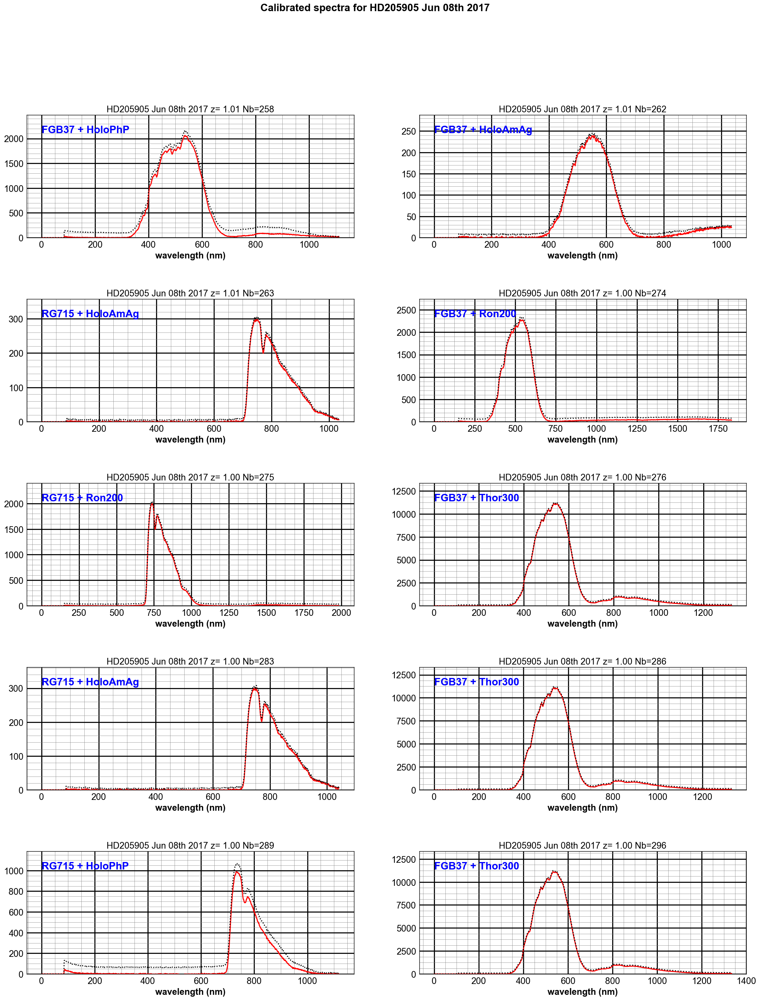

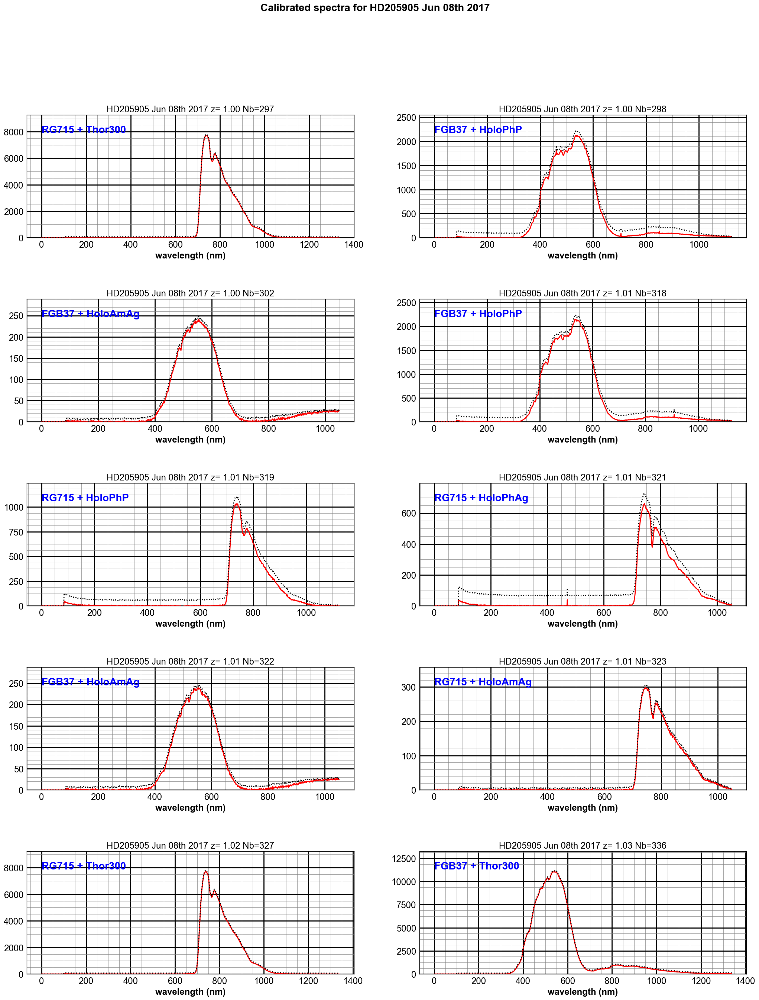

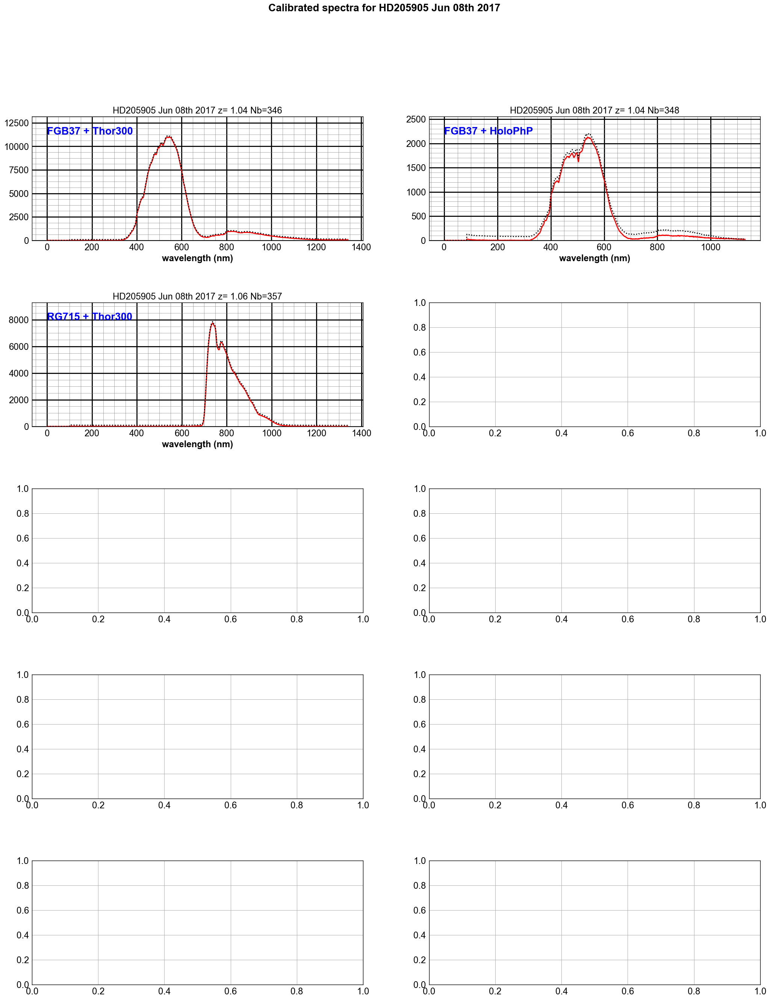

In [508]:
ShowSpectrawithBG(all_rightspectra_data,all_totrightspectra_data,all_rightspectra_wl,all_titles,object_name,all_filt,all_filt1,dir_top_images)

### Work only on right spectra

Filter Not found :: RG715
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
Filter Not found :: RG715
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
Filter Not found :: RG715
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
Filter Not found :: RG715
Filter Not found :: RG715
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
found FGB37 :  FGB37
found FGB37 :  FGB37
Filter Not found :: RG715
Filter Not found :: RG715
found FGB37 :  FGB37
found FGB37 :  FGB37
found FGB37 :  FGB37
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
Filter Not found :: RG715
found FGB37 :  FGB37
fou

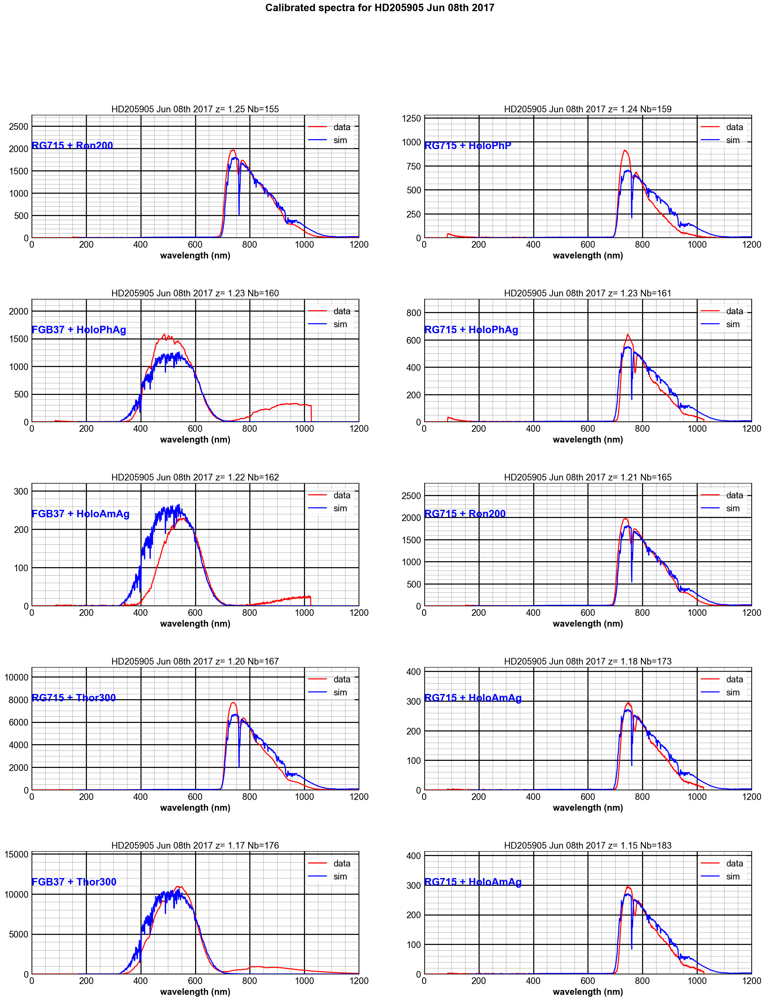

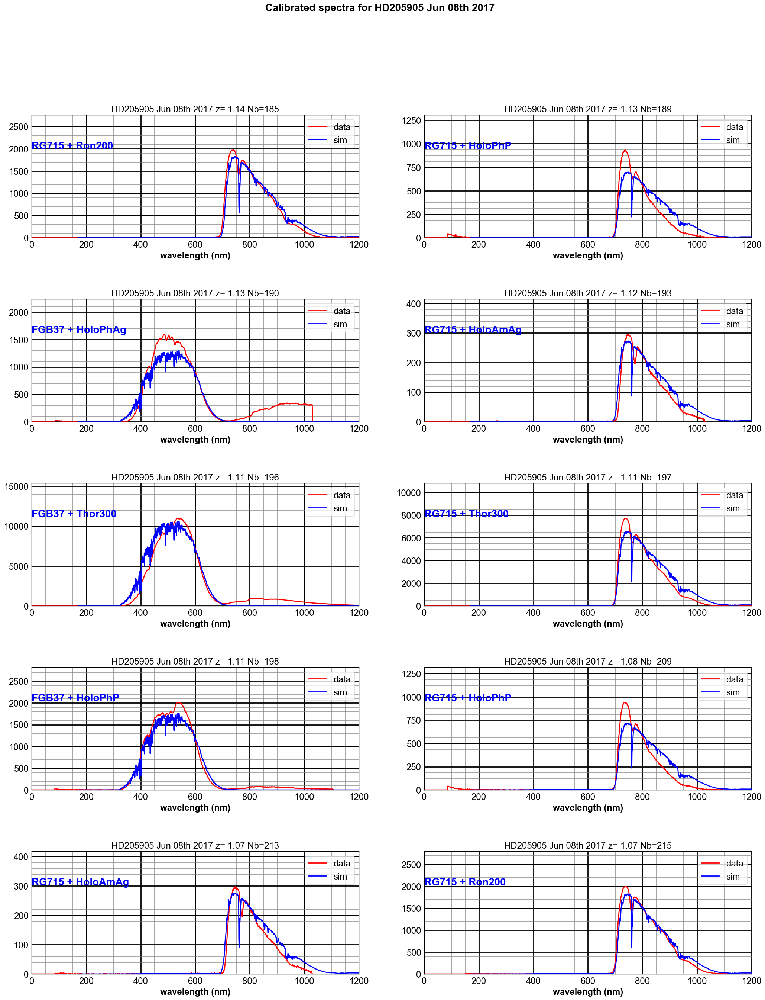

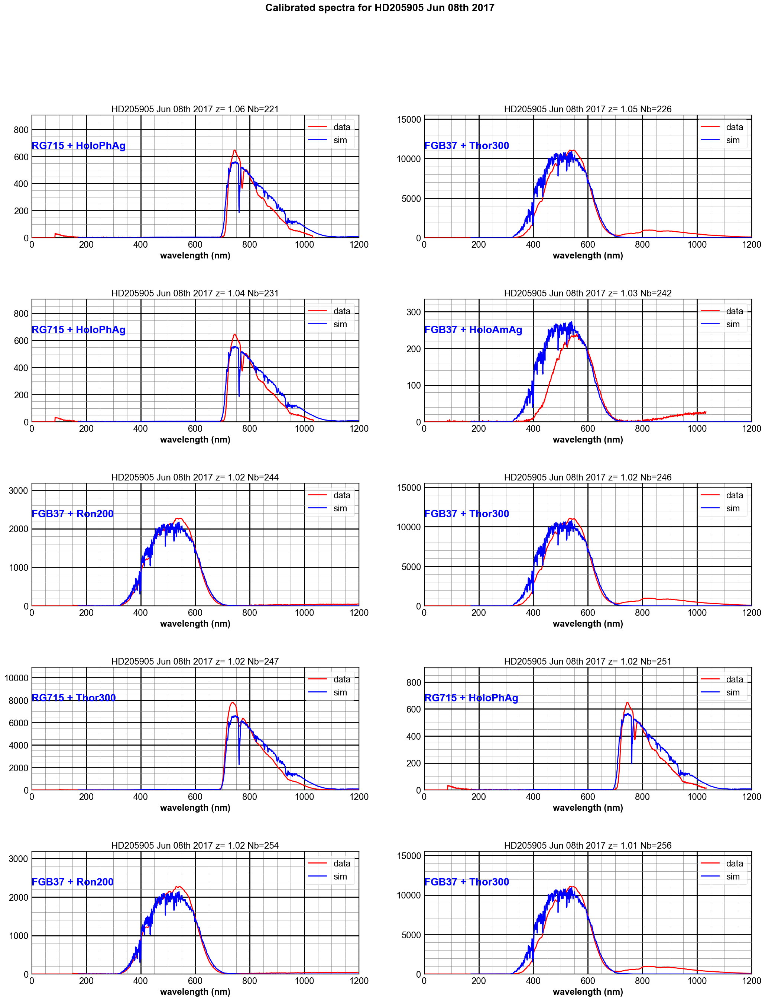

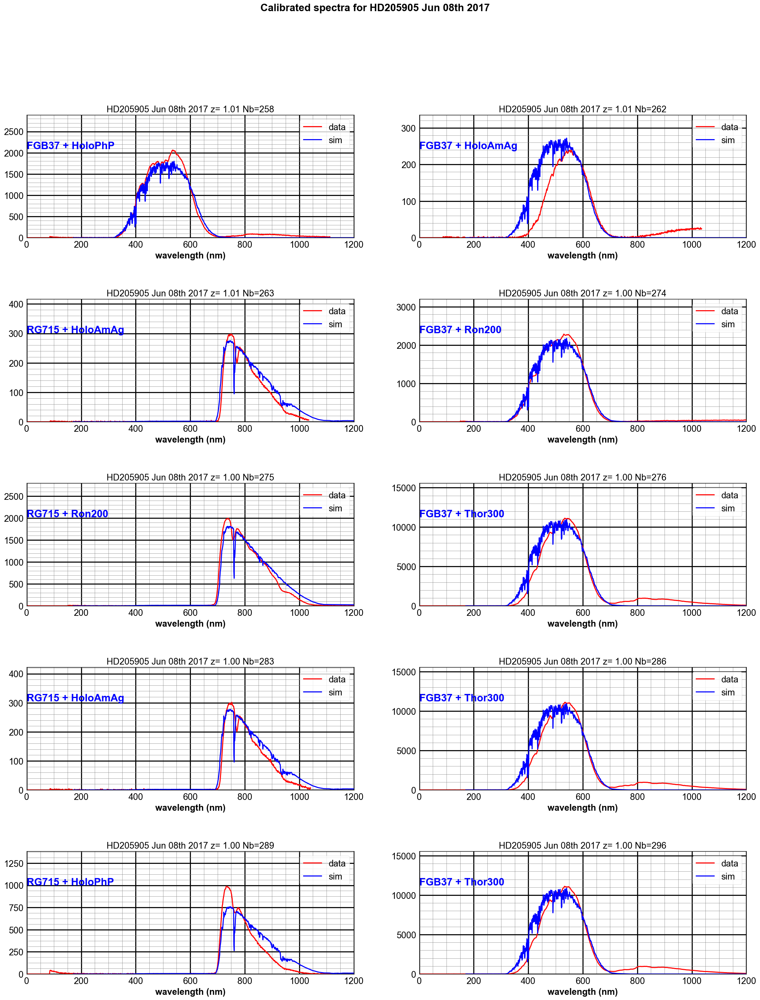

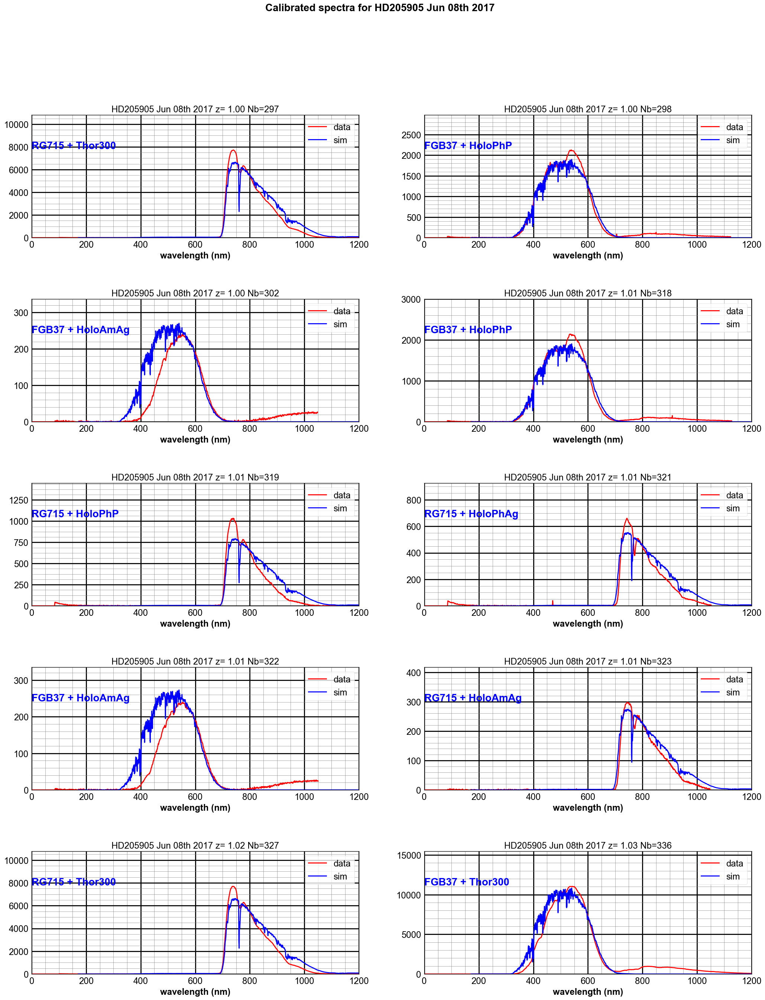

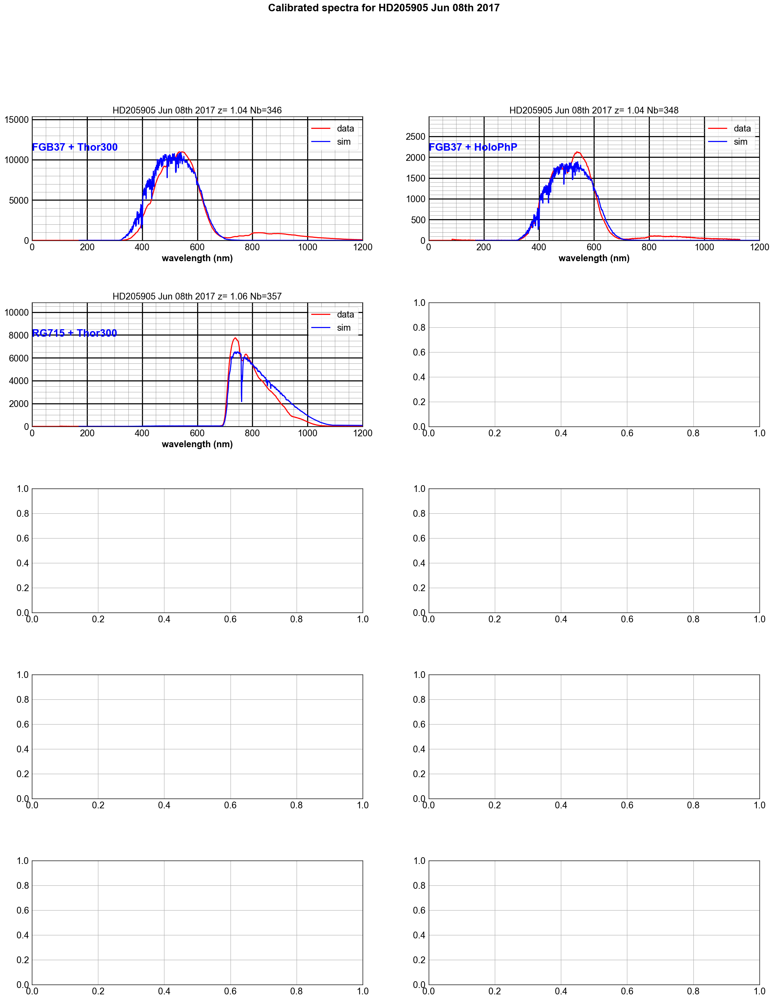

In [509]:
all_calibdatasimfactors=ShowSpectra(all_rightspectra_data,all_rightspectra_wl,all_titles,object_name,all_filt,all_filt1,dir_top_images,simspectra_data)

# Start the analysis

## Few definition

In [510]:
wl_O2Aline=759.37      # Balmer Lines
wl_O2Bline=686.719
wl_Haline=656.281 
wl_Hbline=486.134
wl_Hgline=434.047 
wl_Hdline=410.175
wl_Heline=397.0

In [511]:
def ShowOneSpectrum(sel):
    """
    ShowOneSpectrum
    ================
    """

    # get sim spectrum
    wl_sim=simspectra_data[0]/10.
    spectrum_sim=simspectra_data[sel+1]*all_calibdatasimfactors[sel] # sim
    
    
    # get the data
    thespectrum=all_rightspectra_data[sel]
    thewl=all_rightspectra_wl[sel]
    
    
    
    ymin=thespectrum.min()
    ymax=thespectrum.max()*1.1

    fig, ax = plt.subplots(1, 1, figsize=(15,8))


    ax.plot(thewl,thespectrum,'r-',lw=2,label='data')
    ax.plot(wl_sim,spectrum_sim,'b-',lw=2,label='sim')

    max_y_to_plot=thespectrum[:].max()*1.2
    ax.set_ylim(0.,max_y_to_plot)
    ax.text(0.,max_y_to_plot*1.1/1.2, all_filt[sel],verticalalignment='top', horizontalalignment='left',color='blue',fontweight='bold', fontsize=20)

    ax.set_title(all_titles[sel])
    ax.get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    ax.grid(b=True, which='major', color='k', linewidth=2.0)
    ax.grid(b=True, which='minor', color='grey', linewidth=0.5)

    ax.plot([wl_O2Aline,wl_O2Aline],[ymin,ymax],'b-',label='$O_2(A)$',lw=1)
    ax.plot([wl_O2Bline,wl_O2Bline],[ymin,ymax],'b-',label='$O_2(B)$',lw=1)
    ax.plot([wl_Haline,wl_Haline],[ymin,ymax],'r-',label='$H_{alpha}$',lw=1)
    ax.plot([wl_Hbline,wl_Hbline],[ymin,ymax],'g-',label='$H_{beta}$',lw=1)
    ax.plot([wl_Hgline,wl_Hgline],[ymin,ymax],'c-',label='$H_{gamma}$',lw=1)
    ax.plot([wl_Hdline,wl_Hdline],[ymin,ymax],'k-',label='$H_{delta}$',lw=1)
    ax.plot([wl_Heline,wl_Heline],[ymin,ymax],'y-',label='$H_{delta}$',lw=1)

    ax.legend(loc=3,fontsize=20)
    ax.set_xlim(0,1100)
    ax.set_xlabel("$\lambda$ (nm)")
    
    figfilename=os.path.join(dir_top_images,'one_intput_calibrated_spectra.pdf')
    fig.savefig(figfilename)

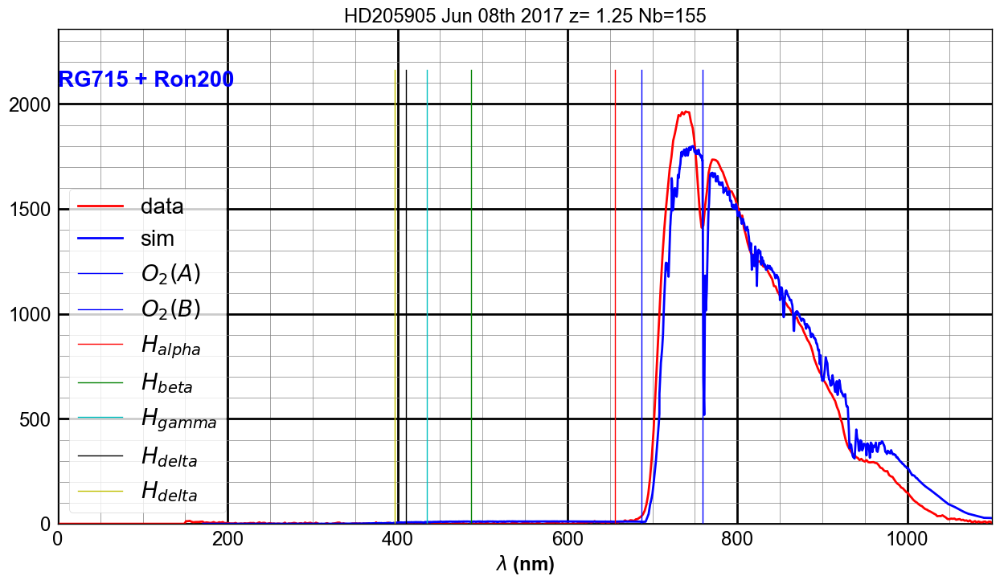

In [512]:
ShowOneSpectrum(0)

In [513]:
def ShowOneSpectrumNextFilt(sel):
    """
    ShowOneSpectrum
    ================
    """

    NBSPECTOPLOT=5
    
    the_spectra= []
    the_wl=[]
    the_max = []
    the_label= []
    
    for i in np.arange(NBSPECTOPLOT):

        the_spectrum=all_rightspectra_data[sel+i]
        thewl=all_rightspectra_wl[sel+i]
        theymin=the_spectrum.min()
        theymax=the_spectrum.max()
        thelabel=all_filt[sel+i]
        
        the_spectra.append(the_spectrum)
        the_wl.append(thewl)
        the_max.append(theymax)
        the_label.append(thelabel)

        
    fig, ax = plt.subplots(1, 1, figsize=(15,8))
    for i in np.arange(NBSPECTOPLOT):        
        ax.plot(the_wl[i],the_spectra[i],lw=3,label=the_label[i])

 
        
    max_y_to_plot=(np.array(the_max)).max()
    ymin=0
    ymax=max_y_to_plot
    ax.set_ylim(0.,max_y_to_plot)
    
    ax.set_title(all_titles[sel])
    ax.get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    ax.grid(b=True, which='major', color='k', linewidth=2.0)
    ax.grid(b=True, which='minor', color='grey', linewidth=0.5)

    ax.plot([wl_O2Aline,wl_O2Aline],[ymin,ymax],'b:',label='$O_2(A)$',lw=3)
    ax.plot([wl_O2Bline,wl_O2Bline],[ymin,ymax],'b:',label='$O_2(B)$',lw=3)
    ax.plot([wl_Haline,wl_Haline],[ymin,ymax],'r:',label='$H_{alpha}$',lw=3)
    ax.plot([wl_Hbline,wl_Hbline],[ymin,ymax],'g:',label='$H_{beta}$',lw=3)
    ax.plot([wl_Hgline,wl_Hgline],[ymin,ymax],'c:',label='$H_{gamma}$',lw=3)
    ax.plot([wl_Hdline,wl_Hdline],[ymin,ymax],'k:',label='$H_{delta}$',lw=3)
    ax.plot([wl_Heline,wl_Heline],[ymin,ymax],'y:',label='$H_{delta}$',lw=3)

    ax.legend(loc='best',fontsize=20)
    ax.set_xlim(0,1100)
    ax.set_xlabel("$\lambda$ (nm)")
    
    figfilename=os.path.join(dir_top_images,'five_intput_calibrated_spectra.pdf')
    fig.savefig(figfilename)

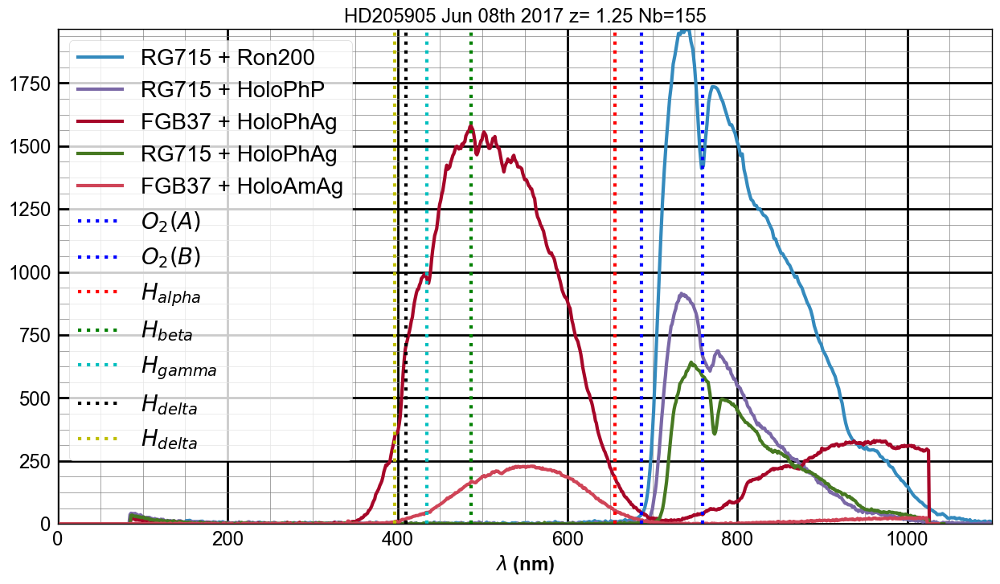

In [514]:
 ShowOneSpectrumNextFilt(0)

# Measurement of Equivalent Width
==============================================

In [515]:
def errorfill(x, y, yerr, color=None, alpha_fill=0.3, ax=None):
    ax = ax if ax is not None else plt.gca()
    if color is None:
        color = ax._get_lines.color_cycle.next()
    if np.isscalar(yerr) or len(yerr) == len(y):
        ymin = y - yerr
        ymax = y + yerr
    elif len(yerr) == 2:
        ymin, ymax = yerr
    ax.plot(x, y, color=color)
    ax.fill_between(x, ymax, ymin, color=color, alpha=alpha_fill)

## Select the spectrum under study

In [516]:
sel=2 # spectrum number

In [517]:
def SelectTheSpectrum(sel):
    thespectrum=all_rightspectra_data[sel]
    thewl=all_rightspectra_wl[sel]
    thelabel=all_filt[sel]
    thespecstaterr=all_rightspectra_data_staterr[sel]
    wl_sim=simspectra_data[0]/10.
    spectrum_sim=simspectra_data[sel+1]*all_calibdatasimfactors[sel] # sim
    return thespectrum,thewl,thelabel,thespecstaterr,wl_sim,spectrum_sim

In [518]:
thespectrum,thewl,thelabel,thespecstaterr,wl_sim,spectrum_sim=SelectTheSpectrum(sel)

(0, 1100.0)

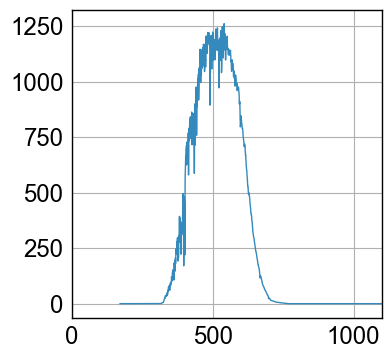

In [519]:
plt.plot(wl_sim,spectrum_sim)
plt.xlim(0,1100.)

## O2 absorption line

In [520]:
O2WL1=732
O2WL2=744
#O2WL1=740
#O2WL2=750
O2WL3=780
O2WL4=790

In [521]:
def ShowEquivalentWidth(wl,spec,wl1,wl2,wl3,wl4):
    """
    ShowEquivalentWidth : show how the equivalent width must be computed
    Notice this fit only order 1
    """
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    ymin=spec_cut.min()
    ymax=spec_cut.max()
    
    plt.figure()
    plt.plot(wl_cut,spec_cut)
    plt.plot([wl2,wl2],[ymin,ymax],'k-.',lw=2)
    plt.plot([wl3,wl3],[ymin,ymax],'k-.',lw=2)
    
    
    # continuum fit
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    z_cont_fit=np.polyfit(x_cont, y_cont,1)
        
    pol_cont_fit=np.poly1d(z_cont_fit)
    
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    
    plt.plot(x_cont,y_cont,'o')
    
    plt.plot(fit_line_x,fit_line_y,'g--',lw=1)
    
    plt.grid(True)
    plt.title('Equivalent width computation')
    
    # compute the ratio spectrum/continuum
    full_continum=pol_cont_fit(wl_cut)    
    ratio=spec_cut/full_continum
    
    plt.figure()
    plt.plot(wl_cut,ratio)
    plt.plot([wl2,wl2],[0,1.2],'k-.',lw=2)
    plt.plot([wl3,wl3],[0,1.2],'k-.',lw=2)
    plt.grid(True)
    
    
    NBBins=len(wl_cut)
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin

    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                       
    # calculation of equivalent width
    
    absorption_band=wl_bin_size*(1-ratio)
    equivalent_width= absorption_band.sum()
    
    
    return equivalent_width

In [522]:

import numpy.core.numeric as NX
from numpy.core import isscalar, abs, finfo, atleast_1d, hstack, dot
from numpy.lib.twodim_base import diag, vander
from numpy.lib.function_base import trim_zeros, sort_complex
from numpy.lib.type_check import iscomplex, real, imag
from numpy.linalg import eigvals, lstsq, inv


In [523]:
def polyfit(x, y, deg, rcond=None, full=False, w=None, cov=False):
    """
    Least squares polynomial fit.
    Fit a polynomial ``p(x) = p[0] * x**deg + ... + p[deg]`` of degree `deg`
    to points `(x, y)`. Returns a vector of coefficients `p` that minimises
    the squared error.
    Parameters
    ----------
    x : array_like, shape (M,)
        x-coordinates of the M sample points ``(x[i], y[i])``.
    y : array_like, shape (M,) or (M, K)
        y-coordinates of the sample points. Several data sets of sample
        points sharing the same x-coordinates can be fitted at once by
        passing in a 2D-array that contains one dataset per column.
    deg : int
        Degree of the fitting polynomial
    rcond : float, optional
        Relative condition number of the fit. Singular values smaller than
        this relative to the largest singular value will be ignored. The
        default value is len(x)*eps, where eps is the relative precision of
        the float type, about 2e-16 in most cases.
    full : bool, optional
        Switch determining nature of return value. When it is False (the
        default) just the coefficients are returned, when True diagnostic
        information from the singular value decomposition is also returned.
    w : array_like, shape (M,), optional
        weights to apply to the y-coordinates of the sample points.
    cov : bool, optional
        Return the estimate and the covariance matrix of the estimate
        If full is True, then cov is not returned.
    Returns
    -------
    p : ndarray, shape (M,) or (M, K)
        Polynomial coefficients, highest power first.  If `y` was 2-D, the
        coefficients for `k`-th data set are in ``p[:,k]``.
    residuals, rank, singular_values, rcond :
        Present only if `full` = True.  Residuals of the least-squares fit,
        the effective rank of the scaled Vandermonde coefficient matrix,
        its singular values, and the specified value of `rcond`. For more
        details, see `linalg.lstsq`.
    V : ndarray, shape (M,M) or (M,M,K)
        Present only if `full` = False and `cov`=True.  The covariance
        matrix of the polynomial coefficient estimates.  The diagonal of
        this matrix are the variance estimates for each coefficient.  If y
        is a 2-D array, then the covariance matrix for the `k`-th data set
        are in ``V[:,:,k]``
    Warns
    -----
    RankWarning
        The rank of the coefficient matrix in the least-squares fit is
        deficient. The warning is only raised if `full` = False.
        The warnings can be turned off by
        >>> import warnings
        >>> warnings.simplefilter('ignore', np.RankWarning)
    See Also
    --------
    polyval : Computes polynomial values.
    linalg.lstsq : Computes a least-squares fit.
    scipy.interpolate.UnivariateSpline : Computes spline fits.
    Notes
    -----
    The solution minimizes the squared error
    .. math ::
        E = \\sum_{j=0}^k |p(x_j) - y_j|^2
    in the equations::
        x[0]**n * p[0] + ... + x[0] * p[n-1] + p[n] = y[0]
        x[1]**n * p[0] + ... + x[1] * p[n-1] + p[n] = y[1]
        ...
        x[k]**n * p[0] + ... + x[k] * p[n-1] + p[n] = y[k]
    The coefficient matrix of the coefficients `p` is a Vandermonde matrix.
    `polyfit` issues a `RankWarning` when the least-squares fit is badly
    conditioned. This implies that the best fit is not well-defined due
    to numerical error. The results may be improved by lowering the polynomial
    degree or by replacing `x` by `x` - `x`.mean(). The `rcond` parameter
    can also be set to a value smaller than its default, but the resulting
    fit may be spurious: including contributions from the small singular
    values can add numerical noise to the result.
    Note that fitting polynomial coefficients is inherently badly conditioned
    when the degree of the polynomial is large or the interval of sample points
    is badly centered. The quality of the fit should always be checked in these
    cases. When polynomial fits are not satisfactory, splines may be a good
    alternative.
    References
    ----------
    .. [1] Wikipedia, "Curve fitting",
           http://en.wikipedia.org/wiki/Curve_fitting
    .. [2] Wikipedia, "Polynomial interpolation",
           http://en.wikipedia.org/wiki/Polynomial_interpolation
    Examples
    --------
    >>> x = np.array([0.0, 1.0, 2.0, 3.0,  4.0,  5.0])
    >>> y = np.array([0.0, 0.8, 0.9, 0.1, -0.8, -1.0])
    >>> z = np.polyfit(x, y, 3)
    >>> z
    array([ 0.08703704, -0.81349206,  1.69312169, -0.03968254])
    It is convenient to use `poly1d` objects for dealing with polynomials:
    >>> p = np.poly1d(z)
    >>> p(0.5)
    0.6143849206349179
    >>> p(3.5)
    -0.34732142857143039
    >>> p(10)
    22.579365079365115
    High-order polynomials may oscillate wildly:
    >>> p30 = np.poly1d(np.polyfit(x, y, 30))
    /... RankWarning: Polyfit may be poorly conditioned...
    >>> p30(4)
    -0.80000000000000204
    >>> p30(5)
    -0.99999999999999445
    >>> p30(4.5)
    -0.10547061179440398
    Illustration:
    >>> import matplotlib.pyplot as plt
    >>> xp = np.linspace(-2, 6, 100)
    >>> _ = plt.plot(x, y, '.', xp, p(xp), '-', xp, p30(xp), '--')
    >>> plt.ylim(-2,2)
    (-2, 2)
    >>> plt.show()
    """
    order = int(deg) + 1
    x = NX.asarray(x) + 0.0
    y = NX.asarray(y) + 0.0

    # check arguments.
    if deg < 0:
        raise ValueError("expected deg >= 0")
    if x.ndim != 1:
        raise TypeError("expected 1D vector for x")
    if x.size == 0:
        raise TypeError("expected non-empty vector for x")
    if y.ndim < 1 or y.ndim > 2:
        raise TypeError("expected 1D or 2D array for y")
    if x.shape[0] != y.shape[0]:
        raise TypeError("expected x and y to have same length")

    # set rcond
    if rcond is None:
        rcond = len(x)*finfo(x.dtype).eps

    # set up least squares equation for powers of x
    lhs = vander(x, order)
    rhs = y

    # apply weighting
    if w is not None:
        w = NX.asarray(w) + 0.0
        if w.ndim != 1:
            raise TypeError("expected a 1-d array for weights")
        if w.shape[0] != y.shape[0]:
            raise TypeError("expected w and y to have the same length")
        lhs *= w[:, NX.newaxis]
        if rhs.ndim == 2:
            rhs *= w[:, NX.newaxis]
        else:
            rhs *= w

    # scale lhs to improve condition number and solve
    scale = NX.sqrt((lhs*lhs).sum(axis=0))
    lhs /= scale
    
    
    print 'MyPolyfit lhs      =   ', lhs
    
    rcond =len(x)*2e-16
    
    c, resids, rank, s = lstsq(lhs, rhs, rcond)
    c = (c.T/scale).T  # broadcast scale coefficients
    
    
    print 'MyPolyfit  c, resids, rank, s   =  ',   c, resids, rank, s
    
    
    

    # warn on rank reduction, which indicates an ill conditioned matrix
    if rank != order and not full:
        msg = "Polyfit may be poorly conditioned"
        warnings.warn(msg, RankWarning)

    if full:
        return c, resids, rank, s, rcond
    elif cov:
        Vbase = inv(dot(lhs.T, lhs))
        Vbase /= NX.outer(scale, scale)
        # Some literature ignores the extra -2.0 factor in the denominator, but
        #  it is included here because the covariance of Multivariate Student-T
        #  (which is implied by a Bayesian uncertainty analysis) includes it.
        #  Plus, it gives a slightly more conservative estimate of uncertainty.
        fac = resids / (len(x) - order - 2.0)
        if y.ndim == 1:
            return c, Vbase * fac
        else:
            return c, Vbase[:,:, NX.newaxis] * fac
    else:
        return c

In [524]:
def ShowEquivalentWidthwthStatErr(wl,spec,specerr,wl1,wl2,wl3,wl4,ndeg=3,thelabel='ShowEquivalentWidthwthStatErr'):
    """
    ******************************************************************************
    ShowEquivalentWidthwthStatErr : show how the equivalent width must be computed
    
    - with errors
    - with non linear method
    
    *********************************************************************************
    """
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    spec_cut_err=specerr[selected_indexes]
    
    ymin=spec_cut.min()
    ymax=spec_cut.max()
    
    #############
    ### Figure 1
    #############
    plt.figure()
    
    plt.plot(wl_cut,spec_cut,'b-')
    plt.errorbar(wl_cut,spec_cut,yerr=spec_cut_err,color='red',fmt='.')
    
    # vertical bars
    plt.plot([wl2,wl2],[ymin,ymax],'k-.',lw=2)
    plt.plot([wl3,wl3],[ymin,ymax],'k-.',lw=2)
    
    
    # continuum fit
    #------------------
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))

    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    y_cont_err=specerr[continuum_indexes]
    y_w=1./y_cont_err
    y_w[np.where(y_cont==0)]=0. # erase the empty bins
   
    
    popt_p , pcov_p= np.polyfit(x_cont, y_cont,ndeg,w=y_w,full=False,cov=True,rcond=2.0e-16*len(x_cont)) #rcond mandatory    
    z_cont_fit=popt_p
      

    pol_cont_fit=np.poly1d(z_cont_fit)
    
    # fitted curve with its error
    #---------------------------------
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    fit_line_y_err = []
    for thex in fit_line_x:
        dfdx = [ thex**thepow for thepow in np.arange(ndeg,-1,-1)]
        dfdx=np.array(dfdx)
        propagated_error=np.dot(dfdx.T,np.dot(pcov_p,dfdx))
        fit_line_y_err.append(propagated_error)
    fit_line_y_err=np.array(fit_line_y_err)
    
    errorfill(fit_line_x,fit_line_y,fit_line_y_err, color='grey',ax=plt)
    plt.errorbar(x_cont,y_cont,yerr=y_cont_err,fmt='.',color='blue')
    plt.plot(fit_line_x,fit_line_y,'g--',lw=1)
    plt.xlabel(' wavelength (nm)')
    plt.ylabel(' ADU per second')
    
    plt.grid(True)
    plt.title(thelabel)
    
    # compute the ratio spectrum/continuum
    #-------------------------------------
    full_continum=pol_cont_fit(wl_cut)    
    
    full_continum_err= []
    for wl in wl_cut:
        dfdx = [ wl**thepow for thepow in np.arange(ndeg,-1,-1)]
        dfdx=np.array(dfdx)
        propagated_error=np.dot(dfdx.T,np.dot(pcov_p,dfdx))
        full_continum_err.append(propagated_error)
    full_continum_err=np.array(full_continum_err)
    
    
    ratio=spec_cut/full_continum
    # error not correlated    
    ratio_err=ratio*np.sqrt( (spec_cut_err/spec_cut)**2+ (full_continum_err/full_continum)**2)
    
    
    
    
    ###################
    ### Second figure
    #################
    plt.figure()
    plt.plot(wl_cut,ratio,lw=2,color='blue')
    plt.errorbar(wl_cut,ratio,yerr=ratio_err,fmt='.',lw=2,color='red')
    plt.plot([wl2,wl2],[0,1.2],'k-.',lw=2)
    plt.plot([wl3,wl3],[0,1.2],'k-.',lw=2)
    plt.grid(True)
    plt.ylim(0.8*ratio.min(),1.2*ratio.max())
    plt.xlabel(' wavelength (nm)')
    plt.ylabel(' no unit')
    plt.title(thelabel)
    
    # Compute now the equavalent width
    #--------------------------------
    NBBins=len(wl_cut)
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin in wavelength

    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                       
    # calculation of equivalent width and its error
    #-------------------------------------------------
    absorption_band=wl_bin_size*(1-ratio)
    absorption_band_error=wl_bin_size*ratio_err
    
    equivalent_width= absorption_band.sum()
    
    # quadratic sum of errors for each wl bin
    equivalend_width_error=np.sqrt((absorption_band_error*absorption_band_error).sum() )
    
    return equivalent_width,equivalend_width_error

In [525]:
def ShowEquivalentWidthNonLinear(wl,spec,wl1,wl2,wl3,wl4,ndeg=3,thelabel='ShowEquivalentWidthNonLinear'):
    """
    ShowEquivalentWidthNonLinear : show how the equivalent width must be computed
    Do not use stats, for simulation by exammple
    """
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
   
    
    ymin=spec_cut.min()
    ymax=spec_cut.max()
    
    plt.figure()
    plt.plot(wl_cut,spec_cut,'r-')
    plt.plot([wl2,wl2],[ymin,ymax],'k-.',lw=2)
    plt.plot([wl3,wl3],[ymin,ymax],'k-.',lw=2)
    
    
    # continuum fit
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    z_cont_fit=np.polyfit(x_cont, y_cont,ndeg,rcond=2.0e-16*len(x_cont))
        
    pol_cont_fit=np.poly1d(z_cont_fit)
    
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    
    plt.plot(x_cont,y_cont,marker='.',color='blue',lw=0)
    plt.plot(fit_line_x,fit_line_y,'g--',lw=2)
    
    plt.grid(True)
    plt.xlabel(' wavelength (nm)')
    plt.ylabel(' ADU per second')
    plt.title(thelabel)
    
    # compute the ratio spectrum/continuum
    full_continum=pol_cont_fit(wl_cut)    
    ratio=spec_cut/full_continum
    
    plt.figure()
    plt.plot(wl_cut,ratio,'b-')
    plt.plot([wl2,wl2],[0,1.2],'k-.',lw=2)
    plt.plot([wl3,wl3],[0,1.2],'k-.',lw=2)
    plt.grid(True)
    plt.xlabel(' wavelength (nm)')
    plt.ylabel(' No unit')
    plt.ylim(0.8*ratio.min(),1.2*ratio.max())
    plt.title(thelabel)
    
    NBBins=len(wl_cut)
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin

    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                       
    # calculation of equivalent width
    
    absorption_band=wl_bin_size*(1-ratio)
    equivalent_width= absorption_band.sum()
    
    
    return equivalent_width

In [526]:
O2WL1_Ron200=730
O2WL2_Ron200=744
O2WL3_Ron200=780
O2WL4_Ron200=790

In [527]:
O2WL1_Thor300=735
O2WL2_Thor300=744
O2WL3_Thor300=780
O2WL4_Thor300=790

In [528]:
O2WL1_HoloPhP=732
O2WL2_HoloPhP=744
O2WL3_HoloPhP=780
O2WL4_HoloPhP=790

In [529]:
O2WL1_HoloPhAg=745
O2WL2_HoloPhAg=760
O2WL3_HoloPhAg=780
O2WL4_HoloPhAg=790

In [530]:
O2WL1_HoloAmAg=745
O2WL2_HoloAmAg=760
O2WL3_HoloAmAg=780
O2WL4_HoloAmAg=790

In [531]:
O2WL1=O2WL1_Ron200
O2WL2=O2WL2_Ron200
O2WL3=O2WL3_Ron200
O2WL4=O2WL4_Ron200

In [532]:
O2WL1_SIM=732
O2WL2_SIM=744
O2WL3_SIM=780
O2WL4_SIM=790

In [533]:
sel=10
thespectrum,thewl,thelabel,thespecstaterr,wl_sim,spectrum_sim=SelectTheSpectrum(sel)

 EQW_DATA =  3.53947  +/-  0.274116752984  nm


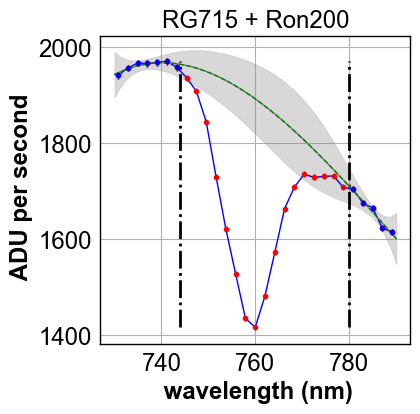

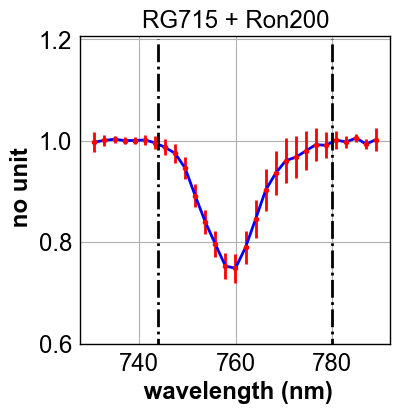

In [534]:
EQW_DATA, EQW_DATA_ERR= ShowEquivalentWidthwthStatErr(thewl,thespectrum,thespecstaterr,O2WL1,O2WL2,O2WL3,O2WL4,ndeg=3,thelabel=thelabel)
print ' EQW_DATA = ',EQW_DATA,' +/- ', EQW_DATA_ERR,' nm'

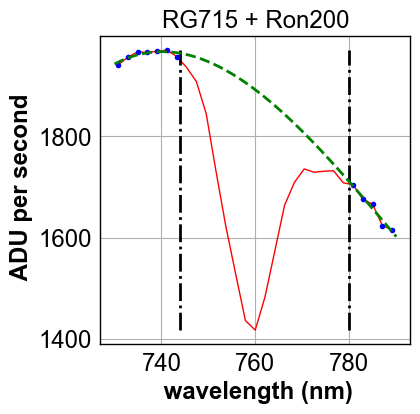

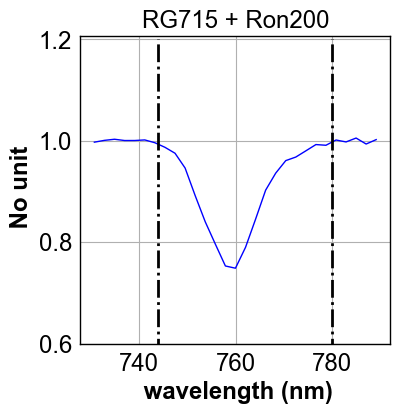

In [535]:
EQW_DATA = ShowEquivalentWidthNonLinear(thewl,thespectrum,O2WL1,O2WL2,O2WL3,O2WL4,ndeg=3,thelabel=thelabel)

 EQW_DATA =  3.50221  nm


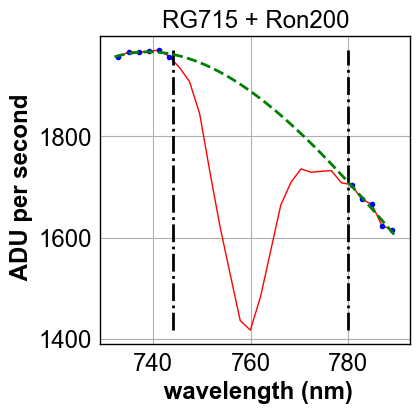

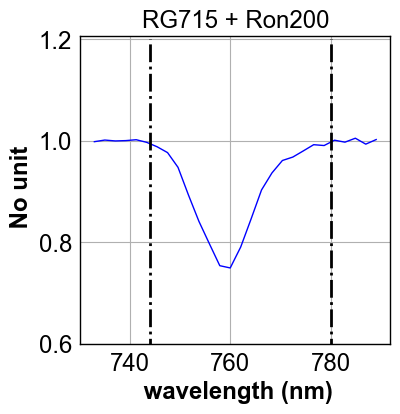

In [536]:
EQW_DATA = ShowEquivalentWidthNonLinear(thewl,thespectrum,O2WL1_SIM,O2WL2_SIM,O2WL3_SIM,O2WL4_SIM,ndeg=3,thelabel=thelabel)
print ' EQW_DATA = ',EQW_DATA,' nm'

EQW_SIM =  2.79058146532  nm


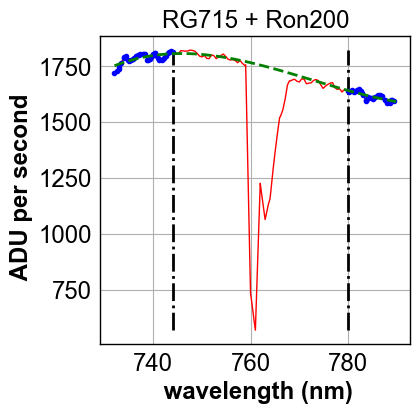

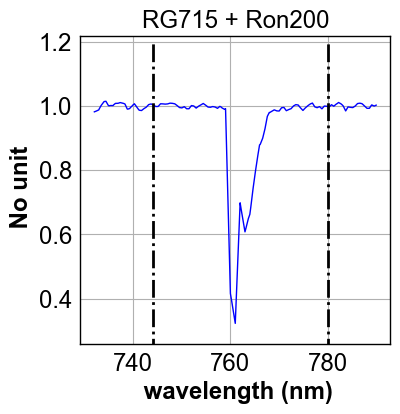

In [537]:
EQW_SIM = ShowEquivalentWidthNonLinear(wl_sim,spectrum_sim,O2WL1_SIM,O2WL2_SIM,O2WL3_SIM,O2WL4_SIM,ndeg=3,thelabel=thelabel)
print 'EQW_SIM = ', EQW_SIM, ' nm'

In [538]:
def ComputeEquivalentWidthNonLinear(wl,spec,wl1,wl2,wl3,wl4,ndeg=3):
    """
    ComputeEquivalentWidth : compute the equivalent width must be computed
    """
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    ymin=spec_cut.min()
    ymax=spec_cut.max()
     
    # continuum fit
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    z_cont_fit=np.polyfit(x_cont, y_cont,ndeg,rcond=2.0e-16*len(x_cont))
        
    pol_cont_fit=np.poly1d(z_cont_fit)
    
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    
    
    # compute the ratio spectrum/continuum
    full_continum=pol_cont_fit(wl_cut)    
    ratio=spec_cut/full_continum
    

    # compute bin size in the band
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                                  
    
    # calculation of equivalent width    
    absorption_band=wl_bin_size*(1-ratio)
    equivalent_width= absorption_band.sum()    
    
    return equivalent_width

In [539]:
def ComputeEquivalentWidthNonLinearwthStatErr(wl,spec,specerr,wl1,wl2,wl3,wl4,ndeg=3):
    """
    ************************************************************************************
    ComputeEquivalentWidthNonLinearwthStatErr : compute the equivalent width must be computed
    
    *************************************************************************************
    """
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
    
    # extract
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    spec_cut_err=specerr[selected_indexes]
    
    
    ymin=spec_cut.min()
    ymax=spec_cut.max()
     
    # continuum fit
    #---------------
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    y_cont_err=specerr[continuum_indexes]
    
    y_w=1./y_cont_err
    y_w[np.where(y_cont==0)]=0. # erase the empty bins
   
    
    popt_p , pcov_p= np.polyfit(x_cont, y_cont,ndeg,w=y_w,full=False,cov=True,rcond=2.0e-16*len(x_cont)) #rcond mandatory    
    z_cont_fit=popt_p
    
    
    
    z_cont_fit=np.polyfit(x_cont, y_cont,ndeg)
        
    pol_cont_fit=np.poly1d(z_cont_fit)
    
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    fit_line_y_err = []
    for thex in fit_line_x:
        dfdx = [ thex**thepow for thepow in np.arange(ndeg,-1,-1)]
        dfdx=np.array(dfdx)
        propagated_error=np.dot(dfdx.T,np.dot(pcov_p,dfdx))
        fit_line_y_err.append(propagated_error)
    fit_line_y_err=np.array(fit_line_y_err)
    
    
    # compute the ratio spectrum/continuum and its error
    full_continum=pol_cont_fit(wl_cut)    
    
    full_continum_err= []
    for wl in wl_cut:
        dfdx = [ wl**thepow for thepow in np.arange(ndeg,-1,-1)]
        dfdx=np.array(dfdx)
        propagated_error=np.dot(dfdx.T,np.dot(pcov_p,dfdx))
        full_continum_err.append(propagated_error)
    full_continum_err=np.array(full_continum_err)
    
    
    ratio=spec_cut/full_continum
    # error not correlated    
    ratio_err=ratio*np.sqrt( (spec_cut_err/spec_cut)**2+ (full_continum_err/full_continum)**2)
    
    

    # compute bin size in the band
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
    
    
    
    # calculation of equivalent width    
    absorption_band=wl_bin_size*(1-ratio)
    equivalent_width= absorption_band.sum() 
    
    # return equavalent width error
    absorption_band_error=wl_bin_size*ratio_err
    # quadratic sum of errors for each wl bin
    equivalend_width_error=np.sqrt((absorption_band_error*absorption_band_error).sum() )
    
    return equivalent_width,equivalend_width_error

In [540]:
def ShowEquivalentWidth2(wl,spec,wl1,wl2,wl3,wl4,label='absortion line'):
    """
    ShowEquivalentWidth : show how the equivalent width must be computed
    """
    
    f, axarr = plt.subplots(1,2,figsize=(12,4))
    
    #############
    ## Figure 1
    ############
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    ymin=spec_cut.min()
    ymax=spec_cut.max()
    
    axarr[0].plot(wl_cut,spec_cut)
    axarr[0].plot([wl2,wl2],[ymin,ymax],'k-.',lw=2)
    axarr[0].plot([wl3,wl3],[ymin,ymax],'k-.',lw=2)
    
    # continuum fit
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    z_cont_fit=np.polyfit(x_cont, y_cont,1)
        
    pol_cont_fit=np.poly1d(z_cont_fit)
    
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    
    
    axarr[0].plot(x_cont,y_cont,'o')
    axarr[0].plot(fit_line_x,fit_line_y,'g--',lw=1)
    
    axarr[0].grid(True)
    axarr[0].set_xlabel('$\lambda$ (nm)')
    
    # compute the ratio spectrum/continuum
    full_continum=pol_cont_fit(wl_cut)    
    ratio=spec_cut/full_continum
    
    # Figure 2
    #-----------
    axarr[1].plot(wl_cut,ratio)
    axarr[1].plot([wl2,wl2],[0,1.2],'r-.',lw=2)
    axarr[1].plot([wl3,wl3],[0,1.2],'r-.',lw=2)
    axarr[1].grid(True)
    axarr[1].ylim(0.8*ratio.min(),1.2*ratio.max())
    
    axarr[1].set_xlabel('$\lambda$ (nm)')
    
    NBBins=len(wl_cut)
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin

    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                       
    # calculation of equivalent width
    
    absorption_band=wl_bin_size*(1-ratio)
    equivalent_width= absorption_band.sum()
    
    
    title = 'Equivalent width computation for {}'.format(label)
    f.suptitle(title)
    
    return equivalent_width

In [541]:
def ShowEquivalentWidth2NonLinear(wl,spec,wl1,wl2,wl3,wl4,label='absortion line',ndeg=3):
    """
    ShowEquivalentWidth : show how the equivalent width must be computed
    """
    
    f, axarr = plt.subplots(1,2,figsize=(12,4))
    
    ################
    ## Figure 1
    #################
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    ymin=spec_cut.min()
    ymax=spec_cut.max()
    
    axarr[0].plot(wl_cut,spec_cut,marker='.',color='red')
    axarr[0].plot([wl2,wl2],[ymin,ymax],'k-.',lw=2)
    axarr[0].plot([wl3,wl3],[ymin,ymax],'k-.',lw=2)
    
    # continuum fit
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    z_cont_fit=np.polyfit(x_cont, y_cont,ndeg)
        
    pol_cont_fit=np.poly1d(z_cont_fit)
    
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    
    
    axarr[0].plot(x_cont,y_cont,marker='.',color='blue',lw=0)
    axarr[0].plot(fit_line_x,fit_line_y,'g--',lw=2)
    
    axarr[0].grid(True)
    axarr[0].set_xlabel('$\lambda$ (nm)')
    axarr[0].set_ylabel('ADU per second')
    
    # compute the ratio spectrum/continuum
    full_continum=pol_cont_fit(wl_cut)    
    ratio=spec_cut/full_continum
    
    external_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    
    
    ############
    # Figure 2
    ###########
    
    axarr[1].plot(wl_cut,ratio,marker='.',color='red')
    axarr[1].plot(wl_cut[external_indexes],ratio[external_indexes],marker='.',color='blue',lw=0)
    
    axarr[1].plot([wl2,wl2],[0,1.2],'k-.',lw=2)
    axarr[1].plot([wl3,wl3],[0,1.2],'k-.',lw=2)
    axarr[1].grid(True)
    axarr[1].set_ylim(0.8*ratio.min(),1.2*ratio.max())
    
    axarr[1].set_xlabel('$\lambda$ (nm)')
    axarr[1].set_ylabel('No unit')
    
    NBBins=len(wl_cut)
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin

    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                       
    # calculation of equivalent width
    
    absorption_band=wl_bin_size*(1-ratio)
    equivalent_width= absorption_band.sum()
    
    
    title = 'Equivalent width computation for {}'.format(label)
    f.suptitle(title)
    
    return equivalent_width

In [542]:
def ShowEquivalentWidth2NonLinearwthStatErr(wl,spec,specerr,wl1,wl2,wl3,wl4,label='absortion line',ndeg=3):
    """
    ***********************************************************************
    ShowEquivalentWidth2NonLinearwthStatErr : 
    
    Fit equivalent width:
    - Non linear
    - with errors
    
    ************************************************************************
    """
    
    f, axarr = plt.subplots(1,2,figsize=(12,4))
    
    order=ndeg+1
    
    #######################
    ## Figure 1
    #########################
    selected_indexes=np.where(np.logical_and(wl>=wl1,wl<=wl4))
        
    wl_cut=wl[selected_indexes]
    spec_cut=spec[selected_indexes]
    spec_cut_err=specerr[selected_indexes]
    
    
    ymin=spec_cut.min()
    ymax=spec_cut.max()
    
    # plot points
    #axarr[0].plot(wl_cut,spec_cut,'b-')
    axarr[0].errorbar(wl_cut,spec_cut,yerr=spec_cut_err,color='red',fmt='.',lw=1)
    axarr[0].plot(wl_cut,spec_cut,'r-',lw=1)
    # plot vertical bars
    axarr[0].plot([wl2,wl2],[ymin,ymax],'k-.',lw=2)
    axarr[0].plot([wl3,wl3],[ymin,ymax],'k-.',lw=2)
    
    # continuum fit
    #----------------
    continuum_indexes=np.where(np.logical_or(np.logical_and(wl>=wl1,wl<=wl2),np.logical_and(wl>=wl3,wl<wl4)))
    x_cont=wl[continuum_indexes]
    y_cont=spec[continuum_indexes]
    

    # error for continum
    y_cont_err=specerr[continuum_indexes]
    y_w=1./y_cont_err
    y_w[np.where(y_cont==0)]=0. # erase the empty bins
    
    popt_p , pcov_p= np.polyfit(x_cont, y_cont,ndeg,w=y_w,full=False,cov=True,rcond=2.0e-16*len(x_cont)) #rcond mandatory
    
    z_cont_fit=popt_p
      
   
    pol_cont_fit=np.poly1d(z_cont_fit)
    

    # compute the fit and propagate the error
    fit_line_x=np.linspace(wl1,wl4,50)
    fit_line_y=pol_cont_fit(fit_line_x)
    
    fit_line_y_err = []
    for thex in fit_line_x:
        dfdx = [ thex**thepow for thepow in np.arange(ndeg,-1,-1)]
        dfdx=np.array(dfdx)
        propagated_error=np.dot(dfdx.T,np.dot(pcov_p,dfdx))
        fit_line_y_err.append(propagated_error)
    fit_line_y_err=np.array(fit_line_y_err)
    
    
    errorfill(fit_line_x,fit_line_y,fit_line_y_err,color='grey',ax=axarr[0])
    axarr[0].errorbar(x_cont,y_cont,yerr=y_cont_err,fmt='.',color='blue')
    
       
    axarr[0].grid(True)
    axarr[0].set_xlabel('$\lambda$ (nm)')
    axarr[0].set_ylabel('ADU per second')
    
    # compute the ratio spectrum/continuum and its error
    # -------------------------------------
    full_continum=pol_cont_fit(wl_cut)  
    
    full_continum_err= []
    external_indexes = []
    idx=0
    for wl in wl_cut:
        if wl<wl2 or wl>wl3:
            external_indexes.append(idx)
        idx+=1
        dfdx = [ wl**thepow for thepow in np.arange(ndeg,-1,-1)]
        dfdx=np.array(dfdx)
        propagated_error=np.dot(dfdx.T,np.dot(pcov_p,dfdx))
        full_continum_err.append(propagated_error)
    full_continum_err=np.array(full_continum_err)
    
    
    ratio=spec_cut/full_continum
    # error not correlated    
    ratio_err=ratio*np.sqrt( (spec_cut_err/spec_cut)**2+ (full_continum_err/full_continum)**2)
    
    
    
    
    
    ##################
    # Figure 2
    ###################
    
    axarr[1].plot(wl_cut,ratio,lw=1,color='red')
    axarr[1].errorbar(wl_cut,ratio,yerr=ratio_err,fmt='.',lw=2,color='red')
    axarr[1].errorbar(wl_cut[external_indexes],ratio[external_indexes],yerr=ratio_err[external_indexes],fmt='.',lw=0,color='blue')
    
    
    axarr[1].plot([wl2,wl2],[0,1.2],'k-.',lw=2)
    axarr[1].plot([wl3,wl3],[0,1.2],'k-.',lw=2)
    axarr[1].grid(True)
    axarr[1].set_ylim(0.8*ratio.min(),1.2*ratio.max())
    axarr[1].set_xlabel('$\lambda$ (nm)')
    axarr[1].set_ylabel('ratio : no unit')
    
    
    #compute the equivalent width
    #-----------------------------
    NBBins=len(wl_cut)
    wl_shift_right=np.roll(wl_cut,1)
    wl_shift_left=np.roll(wl_cut,-1)
    wl_bin_size=(wl_shift_left-wl_shift_right)/2. # size of each bin

    
    outside_band_indexes=np.where(np.logical_or(wl_cut<wl2,wl_cut>wl3))
    wl_bin_size[outside_band_indexes]=0  # erase bin width outside the band
                       
    # calculation of equivalent width and its error (units nm because wl in nm)
    # ----------------------------------------------
    absorption_band=wl_bin_size*(1-ratio)
    absorption_band_error=wl_bin_size*ratio_err
    equivalent_width= absorption_band.sum()
    equivalent_width_err=np.sqrt((absorption_band_error**2).sum())
    
    
    title = 'Equivalent width computation for {}'.format(label)
    f.suptitle(title)
    
    return equivalent_width,equivalent_width_err

In [543]:
sel=0
thespectrum,thewl,thelabel,thespecstaterr,wl_sim,spectrum_sim=SelectTheSpectrum(sel)

In [544]:
thetitle='$O_2$ abs line (data) for {}'.format(thelabel)

In [545]:
O2WL1=O2WL1_Ron200
O2WL2=O2WL2_Ron200
O2WL3=O2WL3_Ron200
O2WL4=O2WL4_Ron200

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned


EQW_DATA =  3.65341  nm


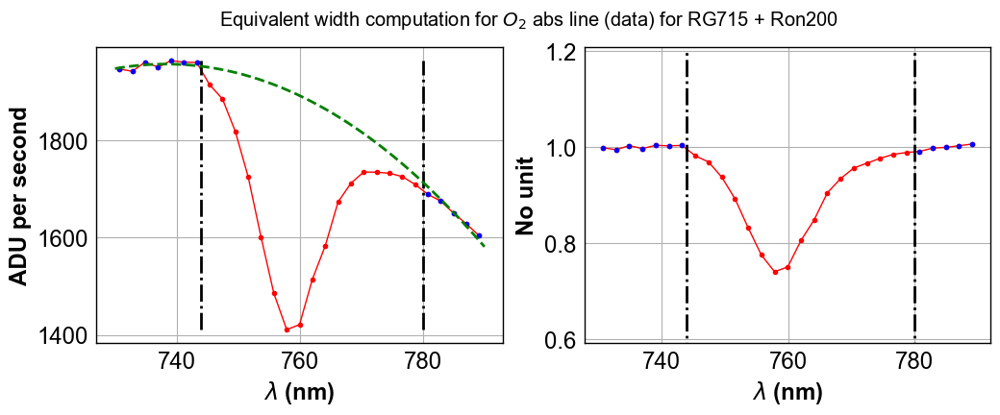

In [546]:
EQW_DATA = ShowEquivalentWidth2NonLinear(thewl,thespectrum,O2WL1,O2WL2,O2WL3,O2WL4,thetitle,ndeg=3)
print 'EQW_DATA = ',EQW_DATA,' nm'

(3.4899554, 0.16779882856085768)

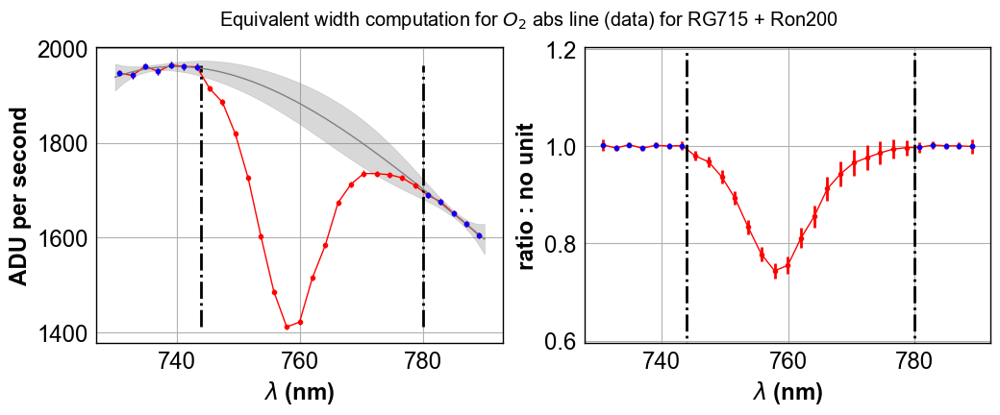

In [547]:
ShowEquivalentWidth2NonLinearwthStatErr(thewl,thespectrum,thespecstaterr,O2WL1,O2WL2,O2WL3,O2WL4,thetitle,ndeg=3)

In [548]:
print EQW_DATA

3.65341


In [549]:
print ComputeEquivalentWidthNonLinear(thewl,thespectrum,O2WL1,O2WL2,O2WL3,O2WL4,ndeg=3)

3.49234


 EQW_SIM =  2.92982154517  nm


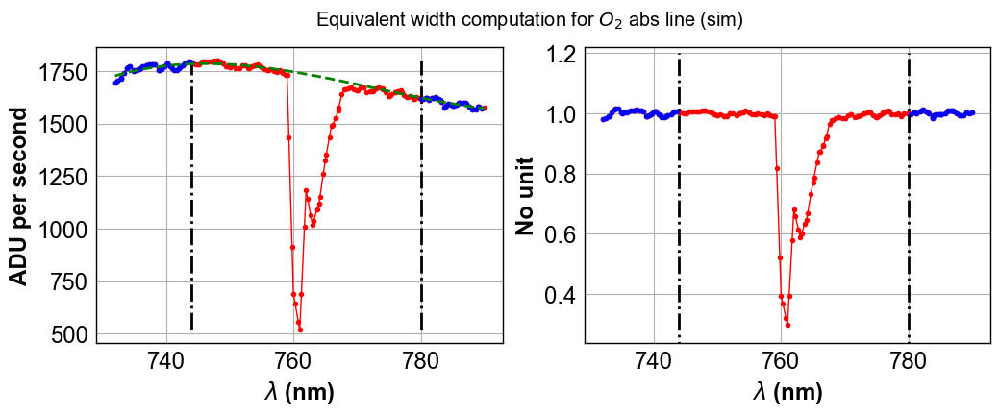

In [550]:
EQW_SIM = ShowEquivalentWidth2NonLinear(wl_sim,spectrum_sim,O2WL1_SIM,O2WL2_SIM,O2WL3_SIM,O2WL4_SIM,'$O_2$ abs line (sim)',ndeg=3)
print ' EQW_SIM = ',EQW_SIM,' nm'

## A) O2 absorption line
-------------------------------

In [551]:
def ShowAllEquivalentWidth(all_wl,all_spec,label='absorption line',absline='O2'):
        
    NBSPECTRA=len(all_spec)
    
    for index in np.arange(0,NBSPECTRA):        
        spectrum=all_spec[index]
        wl=all_wl[index]
        disperser=all_filt2[index]
        
        
        if index in  Thor300_index:
            wl1=O2WL1_Thor300
            wl2=O2WL2_Thor300
            wl3=O2WL3_Thor300
            wl4=O2WL4_Thor300
        elif index in  Ron200_index:
            wl1=O2WL1_Ron200
            wl2=O2WL2_Ron200
            wl3=O2WL3_Ron200
            wl4=O2WL4_Ron200
        elif index in  Ron400_index:
            wl1=O2WL1_Ron400
            wl2=O2WL2_Ron400
            wl3=O2WL3_Ron400
            wl4=O2WL4_Ron400
        elif index in HoloPhP_index:
            wl1=O2WL1_HoloPhP
            wl2=O2WL2_HoloPhP
            wl3=O2WL3_HoloPhP
            wl4=O2WL4_HoloPhP        
        elif index in HoloPhAg_index:
            wl1=O2WL1_HoloPhAg
            wl2=O2WL2_HoloPhAg
            wl3=O2WL3_HoloPhAg
            wl4=O2WL4_HoloPhAg
        elif index in HoloAmAg_index:
            wl1=O2WL1_HoloAmAg
            wl2=O2WL2_HoloAmAg
            wl3=O2WL3_HoloAmAg
            wl4=O2WL4_HoloAmAg
        else:
            print ' disperser ',disperser, ' not found'
        
       
        if absline=='simO2':
            wl1=O2WL1_SIM
            wl2=O2WL2_SIM
            wl3=O2WL3_SIM
            wl4=O2WL4_SIM
            
        if absline =='H2O':
            wl1=WL1_H2O_DATA
            wl2=WL2_H2O_DATA
            wl3=WL3_H2O_DATA
            wl4=WL4_H2O_DATA
        if absline =='simH2O':
            wl1=WL1_H2O_SIM
            wl2=WL2_H2O_SIM
            wl3=WL3_H2O_SIM
            wl4=WL4_H2O_SIM
        
        newlabel = label+ ' for img {} with disp {}'.format(index,all_filt[index]) 
        
        ShowEquivalentWidth2(wl,spectrum,wl1,wl2,wl3,wl4,label=newlabel)


In [552]:
def ShowAllEquivalentWidthNonLinear(all_wl,all_spec,label='absorption line',ndeg=3,absline='O2'):
        
    NBSPECTRA=len(all_spec)
    
    for index in np.arange(0,NBSPECTRA):        
        spectrum=all_spec[index]
        wl=all_wl[index]
        disperser=all_filt2[index]
        
        if index in  Thor300_index:
            wl1=O2WL1_Thor300
            wl2=O2WL2_Thor300
            wl3=O2WL3_Thor300
            wl4=O2WL4_Thor300
        elif index in  Ron200_index:
            wl1=O2WL1_Ron200
            wl2=O2WL2_Ron200
            wl3=O2WL3_Ron200
            wl4=O2WL4_Ron200
        elif index in  Ron400_index:
            wl1=O2WL1_Ron400
            wl2=O2WL2_Ron400
            wl3=O2WL3_Ron400
            wl4=O2WL4_Ron400
        elif index in HoloPhP_index:
            wl1=O2WL1_HoloPhP
            wl2=O2WL2_HoloPhP
            wl3=O2WL3_HoloPhP
            wl4=O2WL4_HoloPhP        
        elif index in HoloPhAg_index:
            wl1=O2WL1_HoloPhAg
            wl2=O2WL2_HoloPhAg
            wl3=O2WL3_HoloPhAg
            wl4=O2WL4_HoloPhAg
        elif index in HoloAmAg_index:
            wl1=O2WL1_HoloAmAg
            wl2=O2WL2_HoloAmAg
            wl3=O2WL3_HoloAmAg
            wl4=O2WL4_HoloAmAg
        else:
            print ' disperser ',disperser, ' not found'
            
               
        if absline=='simO2':
            wl1=O2WL1_SIM
            wl2=O2WL2_SIM
            wl3=O2WL3_SIM
            wl4=O2WL4_SIM
        
        if absline =='H2O':
            wl1=WL1_H2O_DATA
            wl2=WL2_H2O_DATA
            wl3=WL3_H2O_DATA
            wl4=WL4_H2O_DATA
        if absline =='simH2O':
            wl1=WL1_H2O_SIM
            wl2=WL2_H2O_SIM
            wl3=WL3_H2O_SIM
            wl4=WL4_H2O_SIM
        
        newlabel = label+ ' for img {} with disp {}'.format(index,all_filt[index]) 
        
        ShowEquivalentWidth2NonLinear(wl,spectrum,wl1,wl2,wl3,wl4,label=newlabel,ndeg=ndeg)


In [553]:
def ShowAllEquivalentWidthNonLinearwthStatErr(all_wl,all_spec,all_staterr,label='absorption line',ndeg=3,absline='O2'):
        
    NBSPECTRA=len(all_spec)
    
    for index in np.arange(0,NBSPECTRA):        
        spectrum=all_spec[index]
        specerr=all_staterr[index]
        wl=all_wl[index]
        disperser=all_filt2[index]
        
        newlabel = label+ ' for img {} with disp {}'.format(index,all_filt[index]) 
        
        
        if index in  Thor300_index:
            wl1=O2WL1_Thor300
            wl2=O2WL2_Thor300
            wl3=O2WL3_Thor300
            wl4=O2WL4_Thor300
        elif index in  Ron200_index:
            wl1=O2WL1_Ron200
            wl2=O2WL2_Ron200
            wl3=O2WL3_Ron200
            wl4=O2WL4_Ron200
        elif index in  Ron400_index:
            wl1=O2WL1_Ron400
            wl2=O2WL2_Ron400
            wl3=O2WL3_Ron400
            wl4=O2WL4_Ron400
        elif index in HoloPhP_index:
            wl1=O2WL1_HoloPhP
            wl2=O2WL2_HoloPhP
            wl3=O2WL3_HoloPhP
            wl4=O2WL4_HoloPhP        
        elif index in HoloPhAg_index:
            wl1=O2WL1_HoloPhAg
            wl2=O2WL2_HoloPhAg
            wl3=O2WL3_HoloPhAg
            wl4=O2WL4_HoloPhAg
        elif index in HoloAmAg_index:
            wl1=O2WL1_HoloAmAg
            wl2=O2WL2_HoloAmAg
            wl3=O2WL3_HoloAmAg
            wl4=O2WL4_HoloAmAg
        else:
            print ' disperser ',disperser, ' not found'
        
        if absline =='H2O':
            wl1=WL1_H2O_DATA
            wl2=WL2_H2O_DATA
            wl3=WL3_H2O_DATA
            wl4=WL4_H2O_DATA
        if absline =='simH2O':
            wl1=WL1_H2O_SIM
            wl2=WL2_H2O_SIM
            wl3=WL3_H2O_SIM
            wl4=WL4_H2O_SIM
        
        eqw,eqwerr=ShowEquivalentWidth2NonLinearwthStatErr(wl,spectrum,specerr,wl1,wl2,wl3,wl4,label=newlabel,ndeg=ndeg)

        print eqw,' nm',eqwerr, ' nm'    


In [554]:
def ComputeAllEquivalentWidth(all_wl,all_spec,absline='O2'):
    
    EQW_coll = []
    
    NBSPECTRA=len(all_spec)
    
    for index in np.arange(0,NBSPECTRA):        
        spectrum=all_spec[index]
        wl=all_wl[index]
        
        disperser=all_filt2[index]
        
        
        if index in  Thor300_index:
            wl1=O2WL1_Thor300
            wl2=O2WL2_Thor300
            wl3=O2WL3_Thor300
            wl4=O2WL4_Thor300
        elif index in  Ron200_index:
            wl1=O2WL1_Ron200
            wl2=O2WL2_Ron200
            wl3=O2WL3_Ron200
            wl4=O2WL4_Ron200
        elif index in  Ron400_index:
            wl1=O2WL1_Ron400
            wl2=O2WL2_Ron400
            wl3=O2WL3_Ron400
            wl4=O2WL4_Ron400
        elif index in HoloPhP_index:
            wl1=O2WL1_HoloPhP
            wl2=O2WL2_HoloPhP
            wl3=O2WL3_HoloPhP
            wl4=O2WL4_HoloPhP        
        elif index in HoloPhAg_index:
            wl1=O2WL1_HoloPhAg
            wl2=O2WL2_HoloPhAg
            wl3=O2WL3_HoloPhAg
            wl4=O2WL4_HoloPhAg
        elif index in HoloAmAg_index:
            wl1=O2WL1_HoloAmAg
            wl2=O2WL2_HoloAmAg
            wl3=O2WL3_HoloAmAg
            wl4=O2WL4_HoloAmAg
        else:
            print ' disperser ',disperser, ' not found'
            
            
               
        if absline=='simO2':
            wl1=O2WL1_SIM
            wl2=O2WL2_SIM
            wl3=O2WL3_SIM
            wl4=O2WL4_SIM
            
                    
        if absline =='H2O':
            wl1=WL1_H2O_DATA
            wl2=WL2_H2O_DATA
            wl3=WL3_H2O_DATA
            wl4=WL4_H2O_DATA
        if absline =='simH2O':
            wl1=WL1_H2O_SIM
            wl2=WL2_H2O_SIM
            wl3=WL3_H2O_SIM
            wl4=WL4_H2O_SIM
        
        eqw=ComputeEquivalentWidth(wl,spectrum,wl1,wl2,wl3,wl4)
        EQW_coll.append(eqw)
        
    return EQW_coll

In [555]:
def ComputeAllEquivalentWidthNonLinear(all_wl,all_spec,ndeg=3,absline='O2'):
    
    EQW_coll = []
    
    NBSPECTRA=len(all_spec)
    
    for index in np.arange(0,NBSPECTRA):        
        spectrum=all_spec[index]
        wl=all_wl[index]
        
        disperser=all_filt2[index]
        
        if index in  Thor300_index:
            wl1=O2WL1_Thor300
            wl2=O2WL2_Thor300
            wl3=O2WL3_Thor300
            wl4=O2WL4_Thor300
        elif index in  Ron200_index:
            wl1=O2WL1_Ron200
            wl2=O2WL2_Ron200
            wl3=O2WL3_Ron200
            wl4=O2WL4_Ron200
        elif index in  Ron400_index:
            wl1=O2WL1_Ron400
            wl2=O2WL2_Ron400
            wl3=O2WL3_Ron400
            wl4=O2WL4_Ron400
        elif index in HoloPhP_index:
            wl1=O2WL1_HoloPhP
            wl2=O2WL2_HoloPhP
            wl3=O2WL3_HoloPhP
            wl4=O2WL4_HoloPhP        
        elif index in HoloPhAg_index:
            wl1=O2WL1_HoloPhAg
            wl2=O2WL2_HoloPhAg
            wl3=O2WL3_HoloPhAg
            wl4=O2WL4_HoloPhAg
        elif index in HoloAmAg_index:
            wl1=O2WL1_HoloAmAg
            wl2=O2WL2_HoloAmAg
            wl3=O2WL3_HoloAmAg
            wl4=O2WL4_HoloAmAg
        else:
            print ' disperser ',disperser, ' not found'
        
               
        if absline=='simO2':
            wl1=O2WL1_SIM
            wl2=O2WL2_SIM
            wl3=O2WL3_SIM
            wl4=O2WL4_SIM
            
        if absline =='H2O':
            wl1=WL1_H2O_DATA
            wl2=WL2_H2O_DATA
            wl3=WL3_H2O_DATA
            wl4=WL4_H2O_DATA
        if absline =='simH2O':
            wl1=WL1_H2O_SIM
            wl2=WL2_H2O_SIM
            wl3=WL3_H2O_SIM
            wl4=WL4_H2O_SIM
        
        eqw=ComputeEquivalentWidthNonLinear(wl,spectrum,wl1,wl2,wl3,wl4,ndeg=ndeg)
        EQW_coll.append(eqw)
        
    return EQW_coll

In [556]:
def ComputeAllEquivalentWidthNonLinearwthStatErr(all_wl,all_spec,all_espec,ndeg=3,absline='O2'):
    
    EQW_coll = []
    EQW_ERR_coll = []
    
    NBSPECTRA=len(all_spec)
    
    for index in np.arange(0,NBSPECTRA):        
        spectrum=all_spec[index]
        spectrum_err=all_espec[index]
        wl=all_wl[index]
        
        disperser=all_filt2[index]
        
         
        if index in  Thor300_index:
            wl1=O2WL1_Thor300
            wl2=O2WL2_Thor300
            wl3=O2WL3_Thor300
            wl4=O2WL4_Thor300
        elif index in  Ron200_index:
            wl1=O2WL1_Ron200
            wl2=O2WL2_Ron200
            wl3=O2WL3_Ron200
            wl4=O2WL4_Ron200
        elif index in  Ron400_index:
            wl1=O2WL1_Ron400
            wl2=O2WL2_Ron400
            wl3=O2WL3_Ron400
            wl4=O2WL4_Ron400
        elif index in HoloPhP_index:
            wl1=O2WL1_HoloPhP
            wl2=O2WL2_HoloPhP
            wl3=O2WL3_HoloPhP
            wl4=O2WL4_HoloPhP        
        elif index in HoloPhAg_index:
            wl1=O2WL1_HoloPhAg
            wl2=O2WL2_HoloPhAg
            wl3=O2WL3_HoloPhAg
            wl4=O2WL4_HoloPhAg
        elif index in HoloAmAg_index:
            wl1=O2WL1_HoloAmAg
            wl2=O2WL2_HoloAmAg
            wl3=O2WL3_HoloAmAg
            wl4=O2WL4_HoloAmAg
        else:
            print ' disperser ',disperser, ' not found'
        
        if absline =='H2O':
            wl1=WL1_H2O_DATA
            wl2=WL2_H2O_DATA
            wl3=WL3_H2O_DATA
            wl4=WL4_H2O_DATA
        
        eqw,eqw_err=ComputeEquivalentWidthNonLinearwthStatErr(wl,spectrum,spectrum_err,wl1,wl2,wl3,wl4,ndeg=ndeg)
        EQW_coll.append(eqw)
        EQW_ERR_coll.append(eqw_err) 
        
    return EQW_coll,EQW_ERR_coll

3.48996  nm 0.167798828561  nm
3.54628  nm 0.102315492163  nm
-2.83292  nm 0.266543521453  nm
2.43537  nm 0.0284886373933  nm
11.0362  nm 11.065280485  nm
3.15841  nm 0.48977676707  nm
3.7162  nm 0.436374031922  nm
2.70067  nm 0.0579343440914  nm
-1.33328  nm 0.192091244885  nm
2.86344  nm 0.0353095641376  nm
3.53947  nm 0.274116752984  nm
3.71055  nm 0.128919800778  nm
-1.70777  nm 0.212024843358  nm
2.88139  nm 0.0383035264413  nm
-1.15598  nm 0.605341407421  nm
3.49464  nm 0.393791774268  nm
-2.79425  nm 1.44474163741  nm
3.42015  nm 0.0872774991466  nm
2.89558  nm 0.050404414192  nm
3.53809  nm 0.236025409674  nm
2.39732  nm 0.0440015500282  nm
-1.21383  nm 1.21284080003  nm
2.32678  nm 0.0354731564946  nm
11.8154  nm 2.60783426668  nm
1.57548  nm 13.4535664716  nm
-0.940987  nm 0.369012180516  nm
3.11215  nm 0.317999409183  nm
2.24139  nm 0.0329649848315  nm
-13.3814  nm 16.2168141664  nm
-1.01677  nm 0.899040475376  nm
-0.476367  nm 1.16915813365  nm
11.1465  nm 1.26401093013  nm

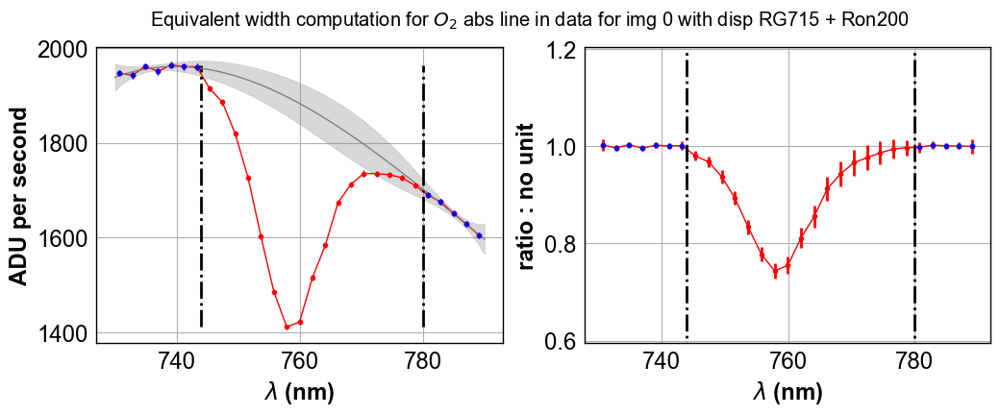

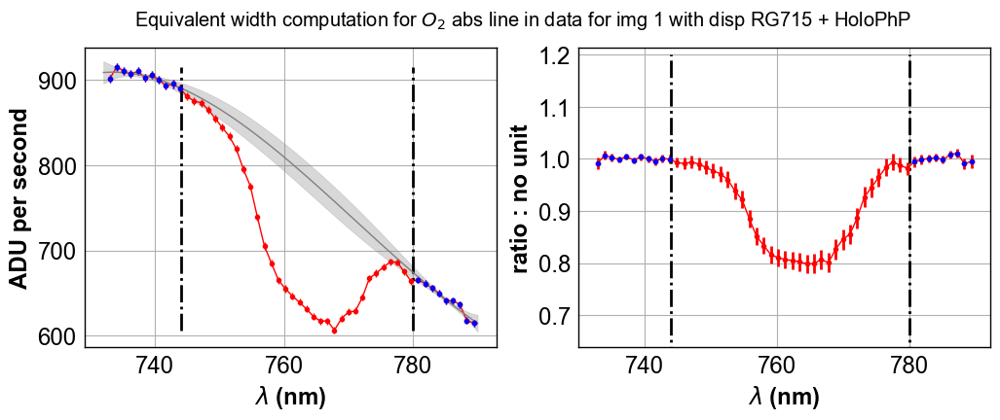

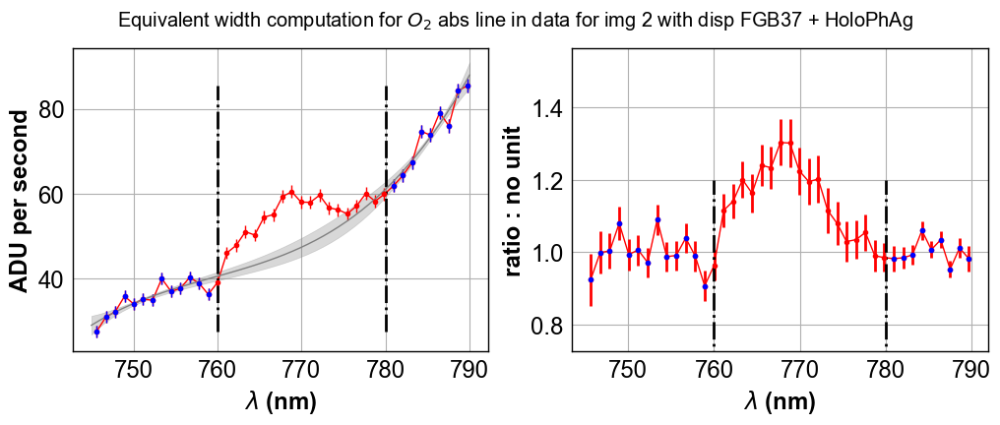

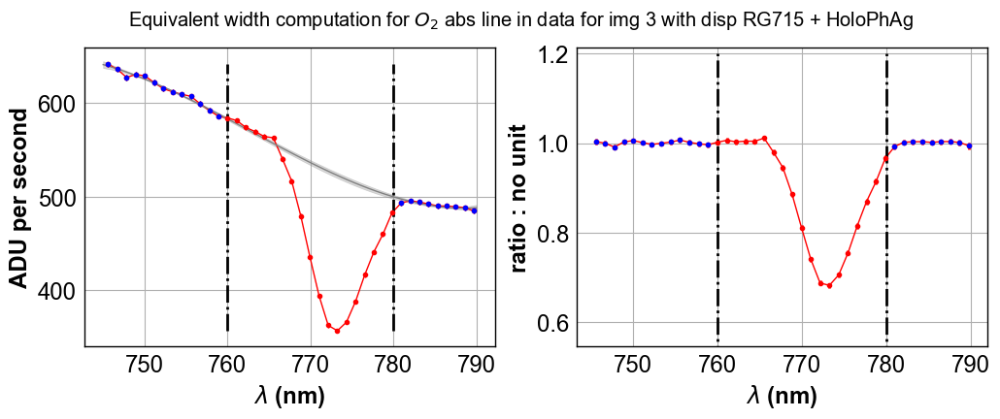

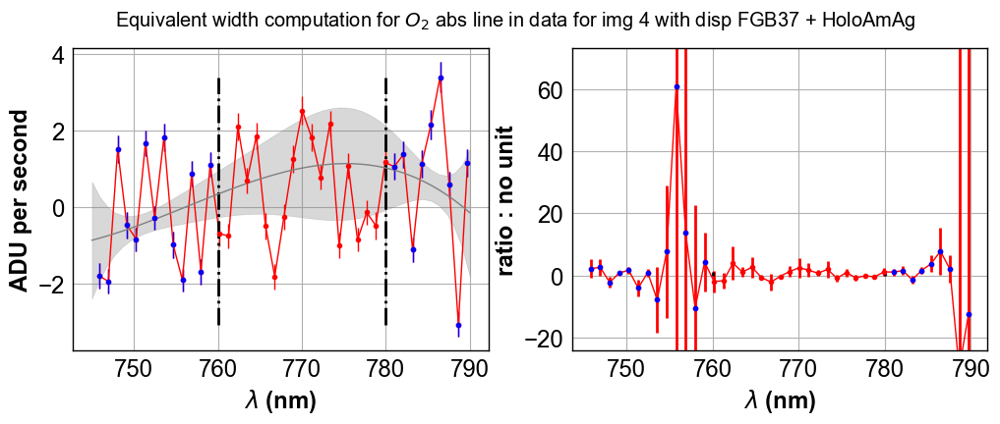

...

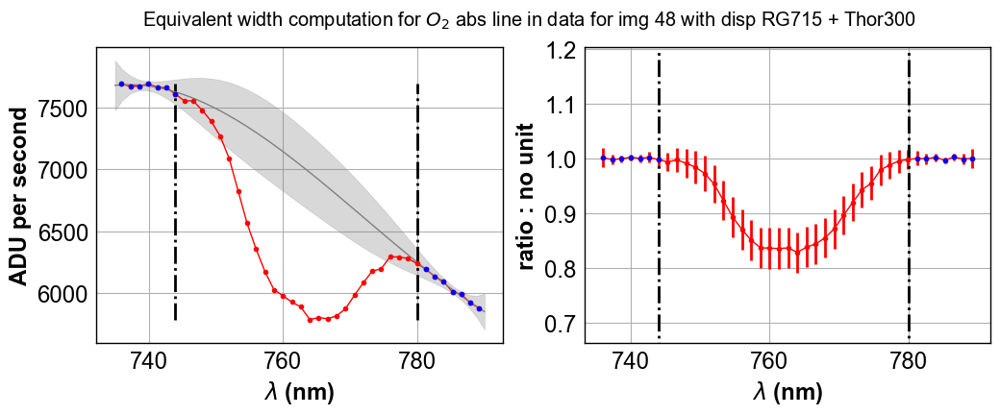

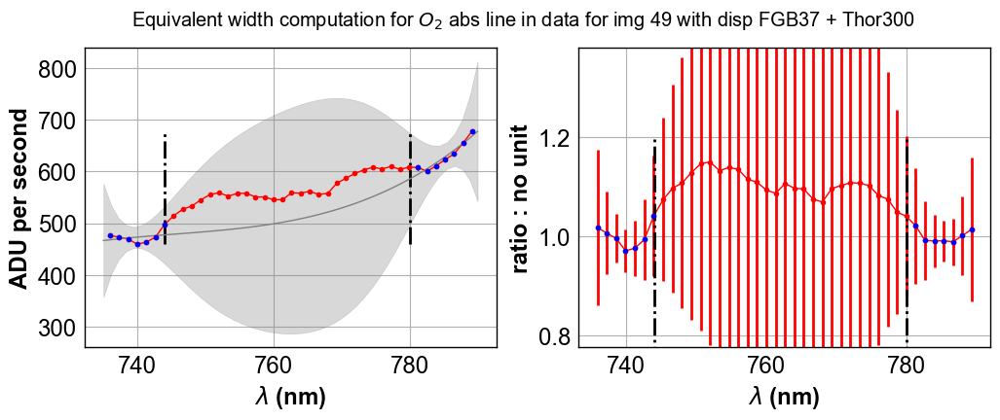

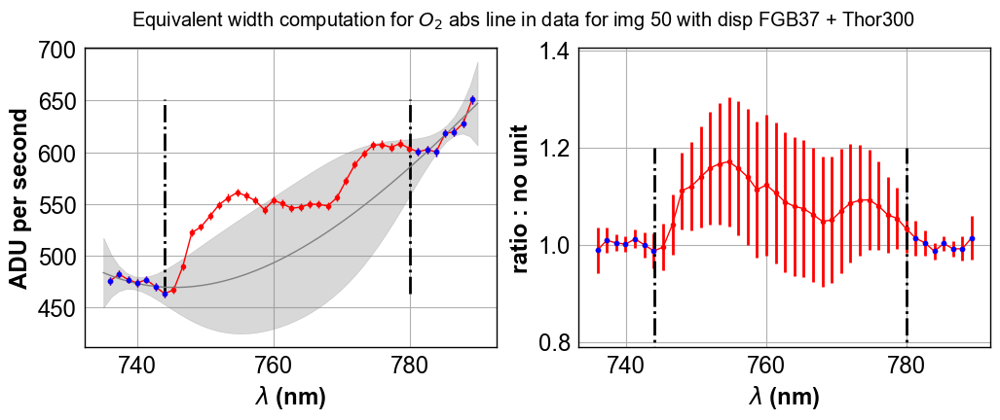

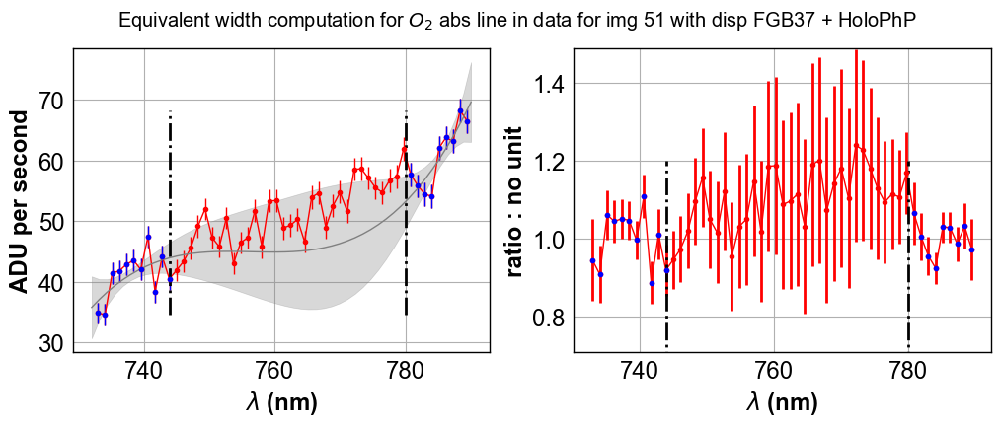

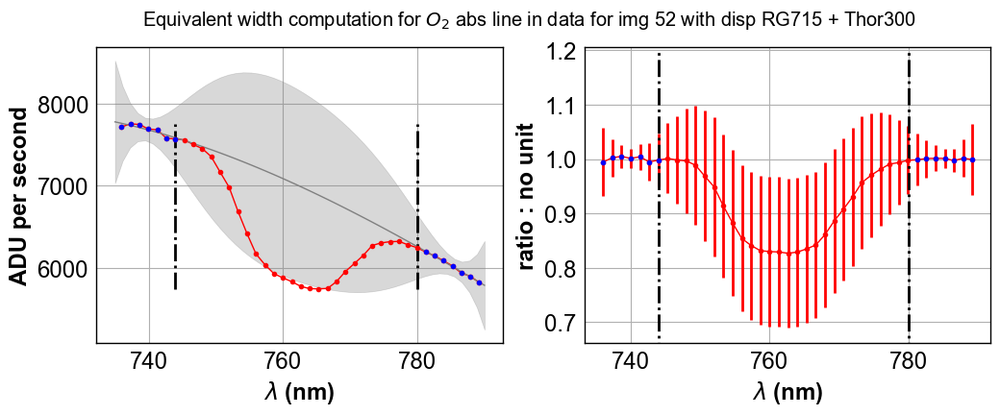

In [557]:
ShowAllEquivalentWidthNonLinearwthStatErr(all_rightspectra_wl,all_rightspectra_data,all_rightspectra_data_staterr,'$O_2$ abs line in data',ndeg=3,absline='O2')

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/li

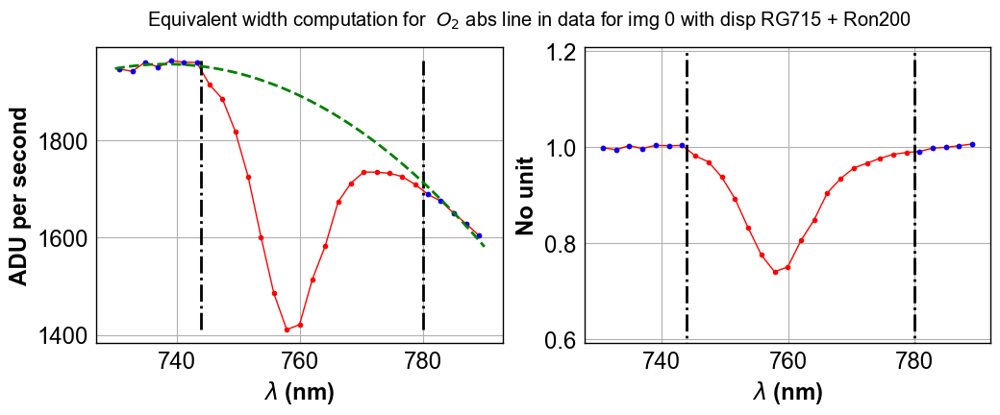

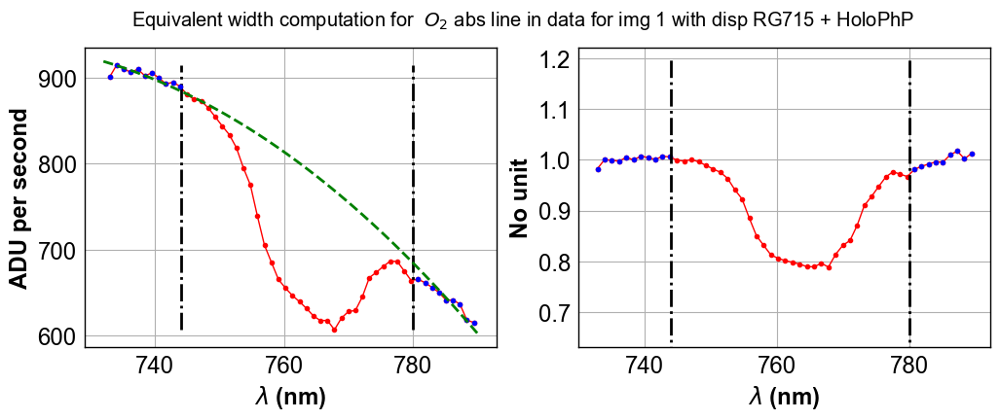

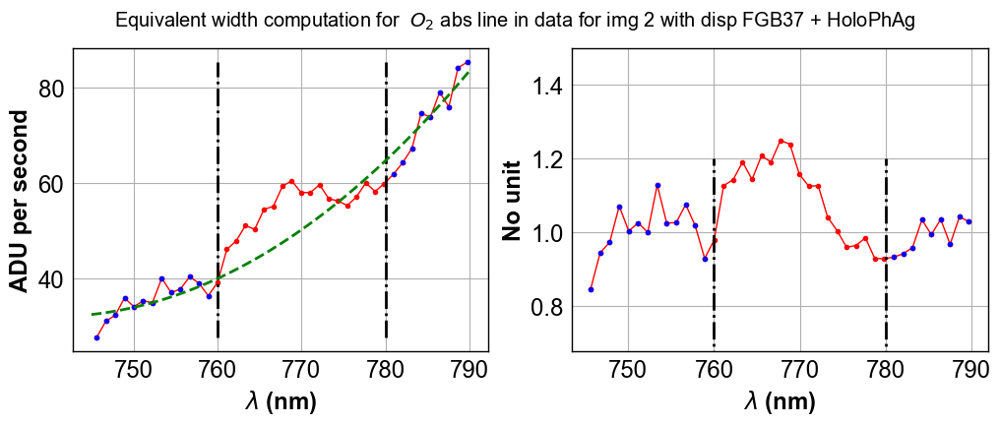

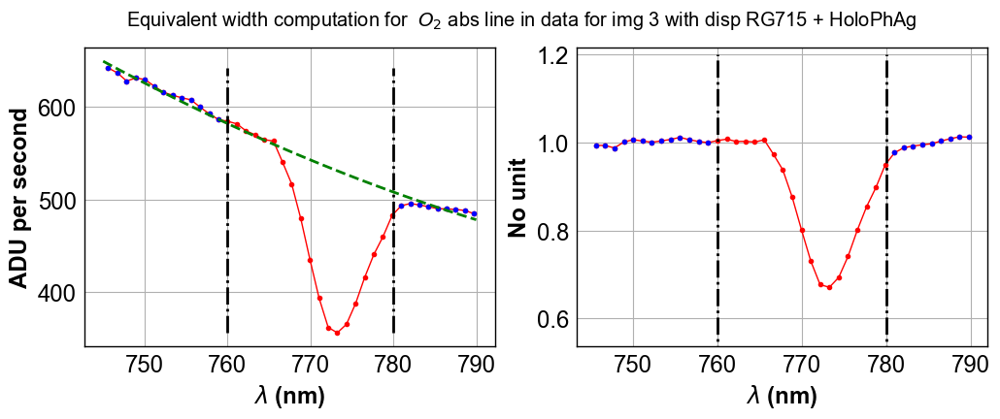

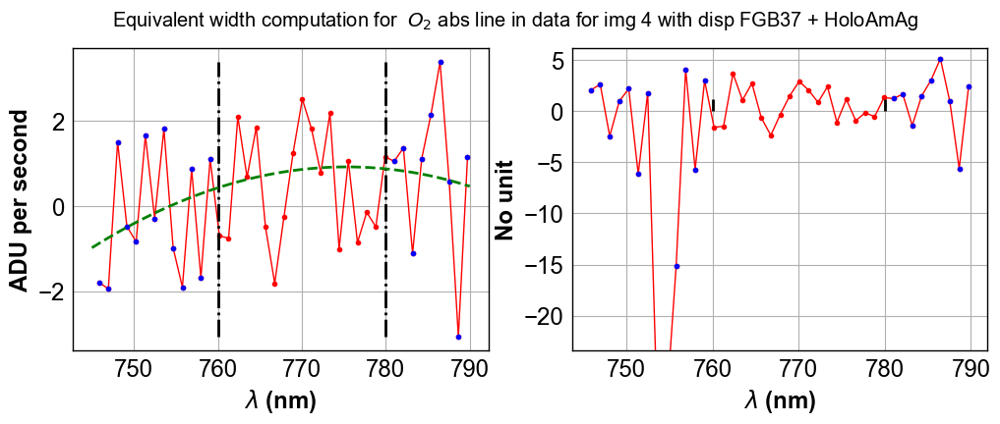

...

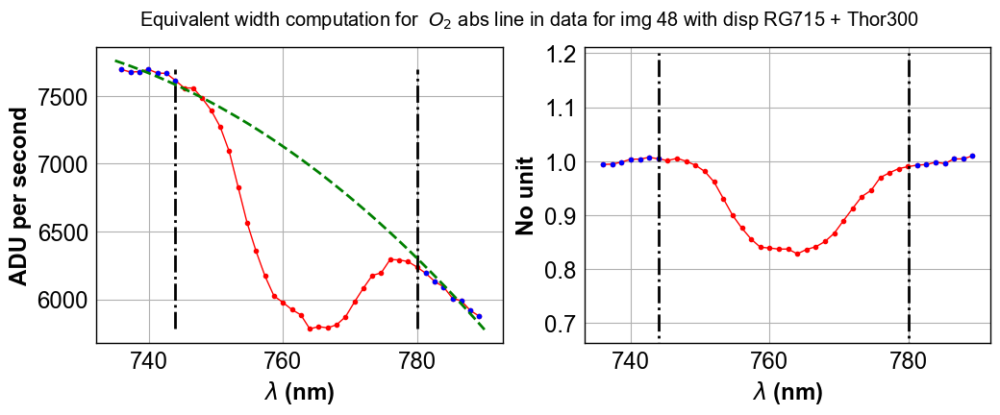

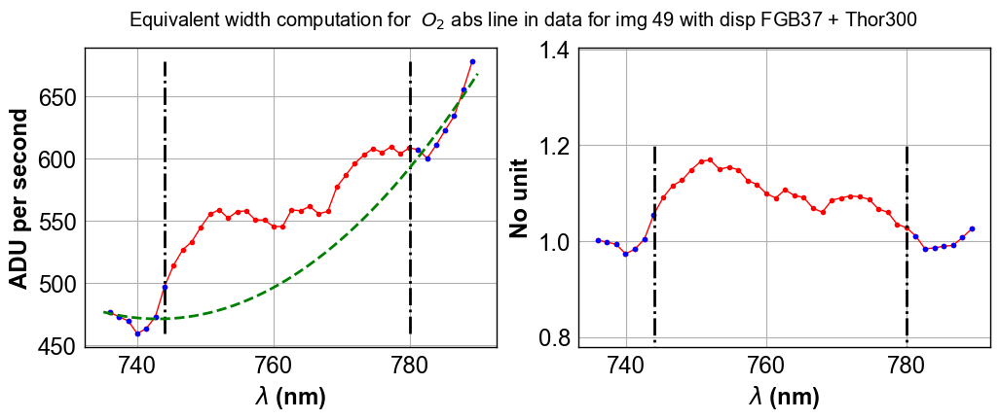

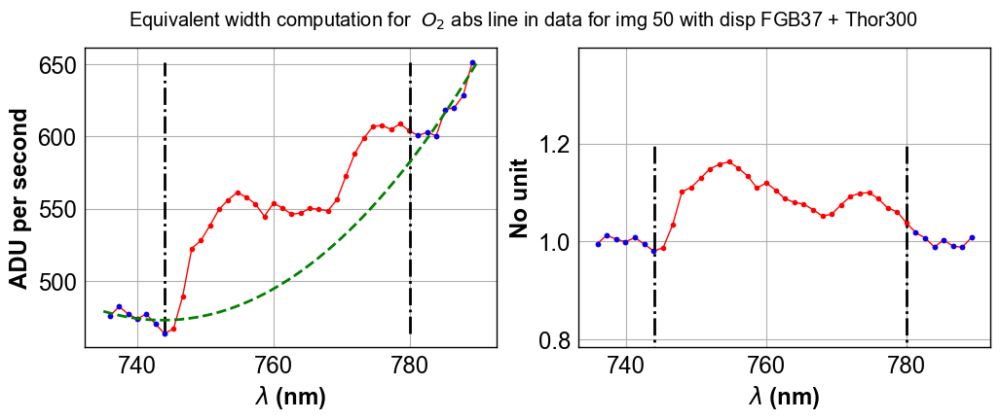

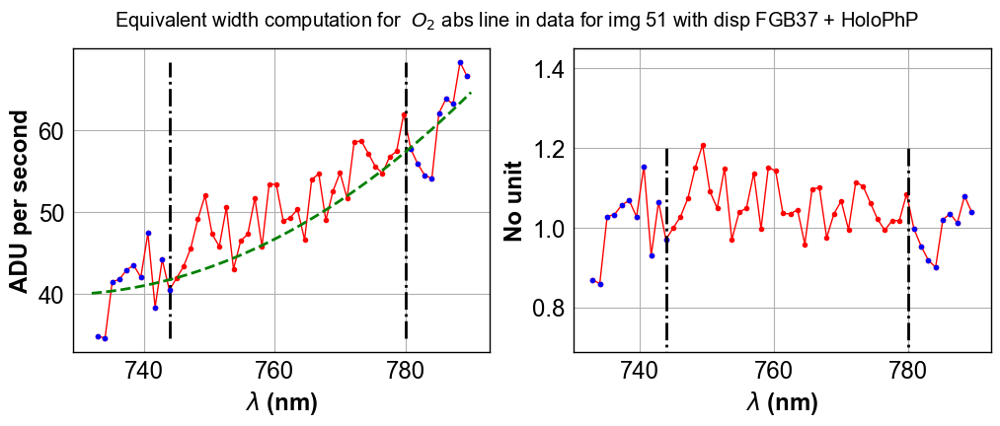

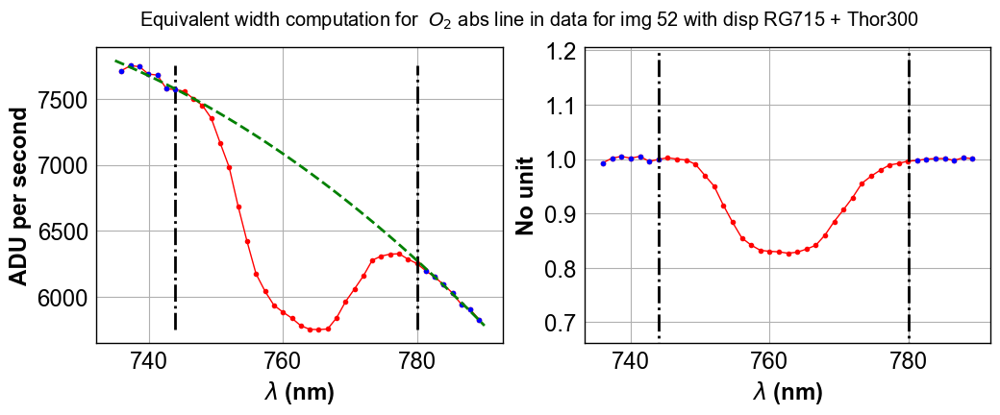

In [558]:
ShowAllEquivalentWidthNonLinear(all_rightspectra_wl,all_rightspectra_data,' $O_2$ abs line in data',ndeg=3,absline='O2')

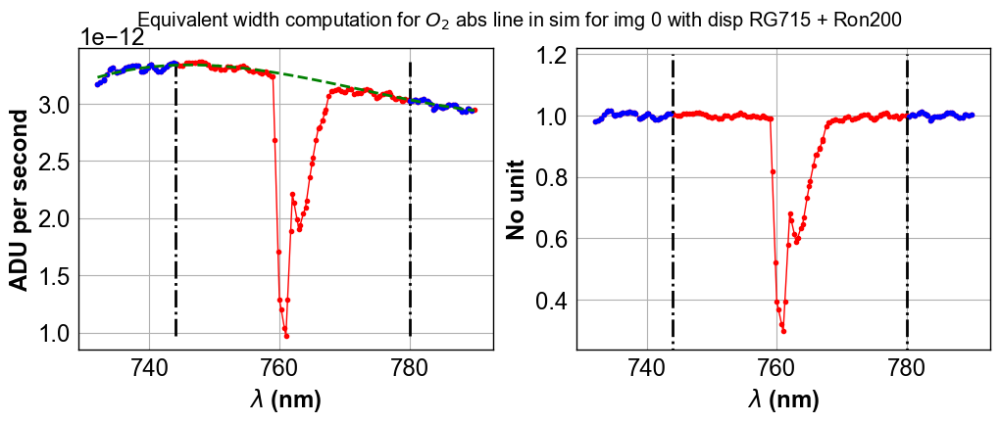

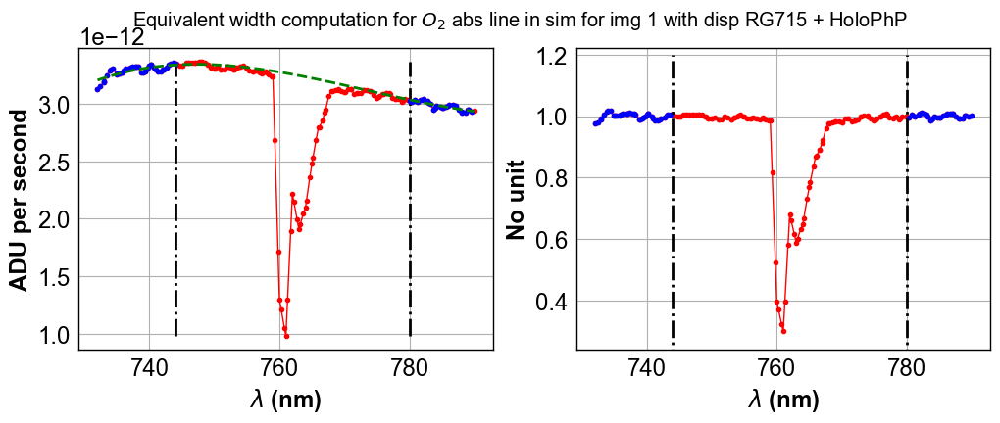

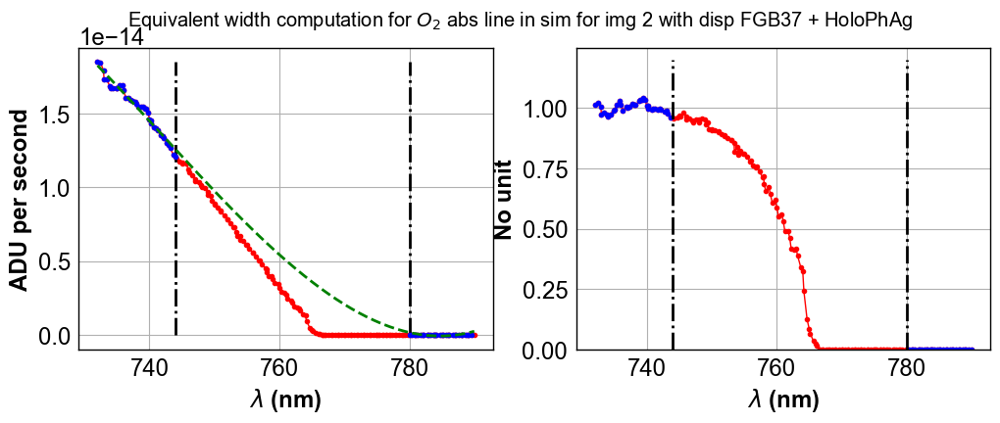

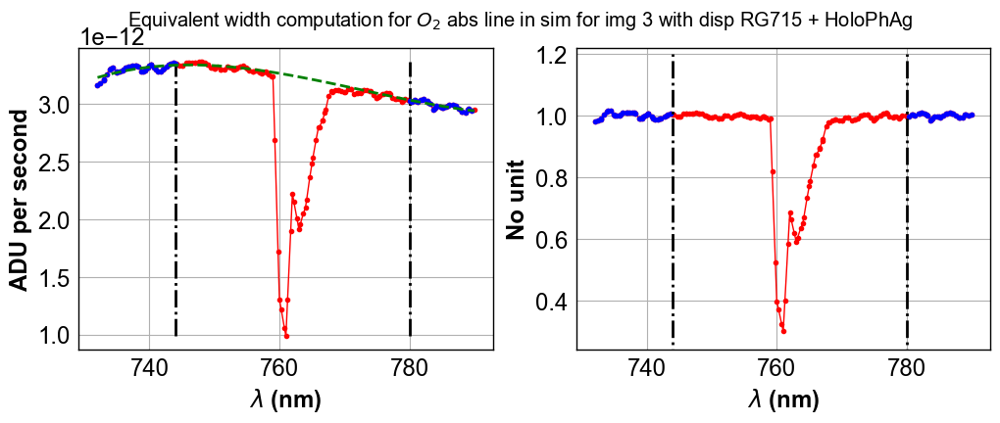

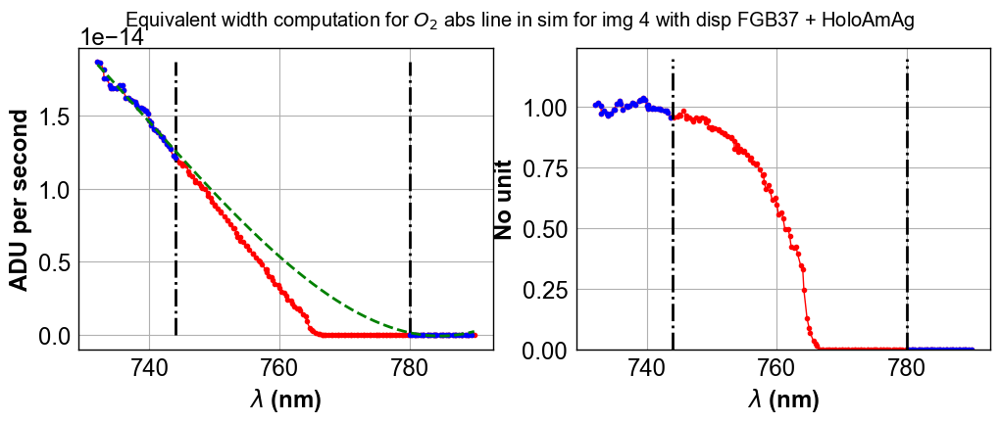

...

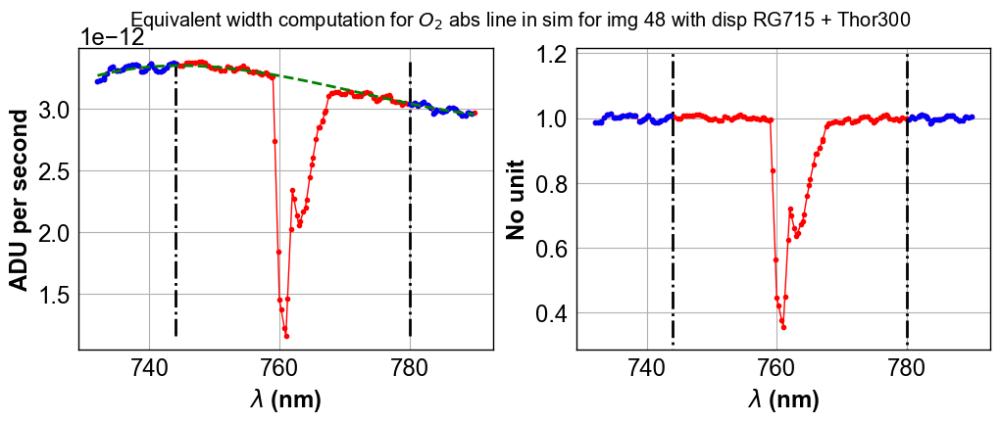

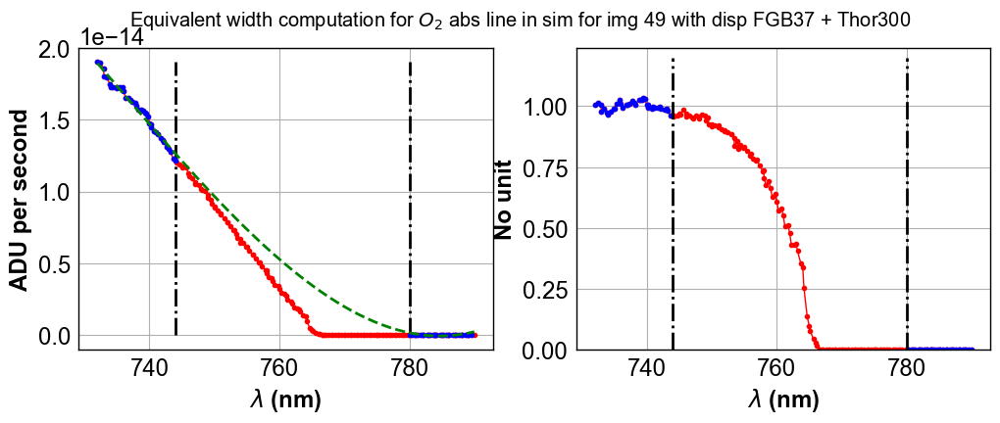

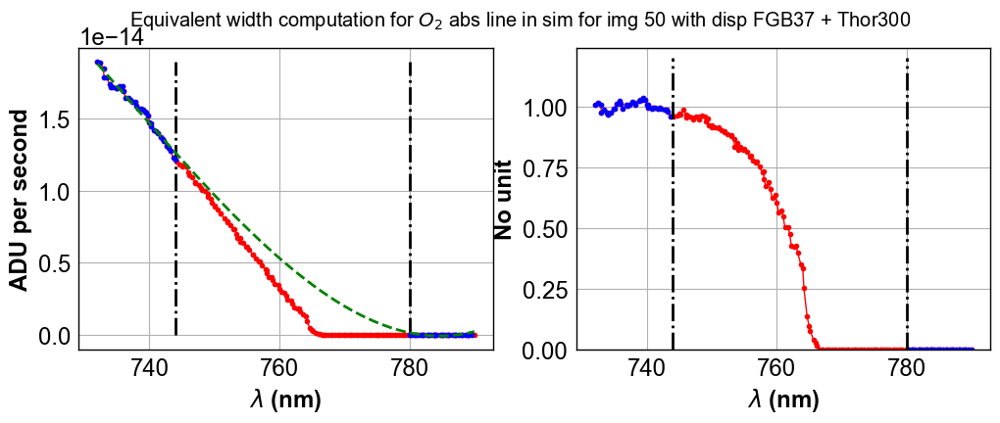

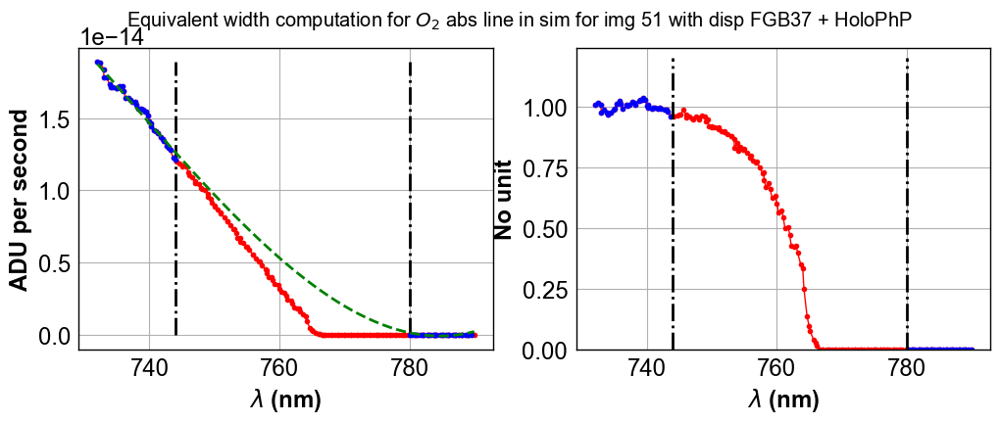

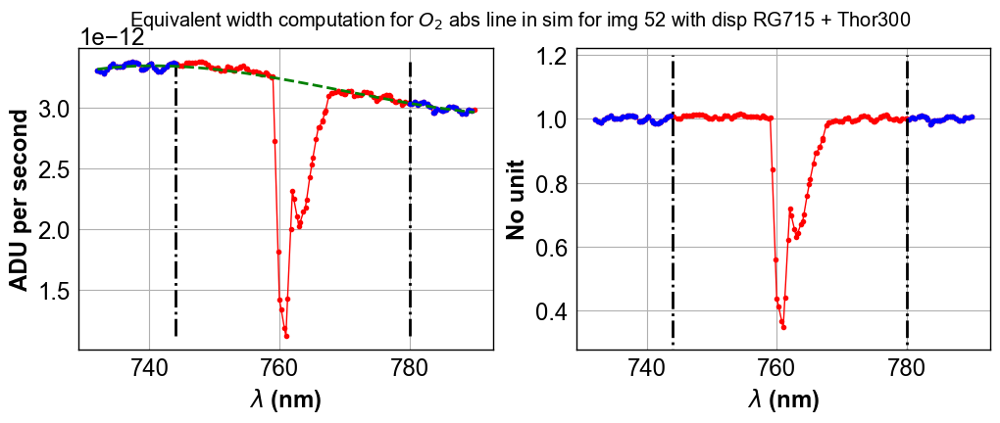

In [559]:
ShowAllEquivalentWidthNonLinear(allwl_sim,allspectra_sim,'$O_2$ abs line in sim',ndeg=3,absline='simO2')

In [560]:
All_eqw_O2_Data=ComputeAllEquivalentWidthNonLinear(all_rightspectra_wl,all_rightspectra_data,ndeg=3,absline='O2')

In [561]:
print All_eqw_O2_Data

[3.4923422, 3.5342259, -2.8608959, 2.4485416, 11.171565, 3.1526947, 3.7188487, 2.7053745, -1.3359153, 2.8656473, 3.5351853, 3.703954, -1.7021041, 2.8817105, -1.1554968, 3.4955201, -2.810607, 3.4193866, 2.8972566, 3.5330415, 2.4063871, -1.2351499, 2.3236196, 12.252554, 1.339927, -0.93971395, 3.1127574, 2.2459526, -12.949574, -1.0147281, -0.45855153, 11.576612, 2.8936648, -15.253029, 3.072854, -1.9044065, 2.8691578, -1.5162492, 3.3133247, -1.7551706, 3.3083987, 2.5525036, -5.8476448, -2.0448177, 3.4997771, 2.5938435, -24.926668, 2.6490028, 3.08569, -3.6110322, -3.3252931, -3.7276483, 3.0748549]


In [562]:
All_eqw_O2_Data,All_eqw_O2_Data_Err=ComputeAllEquivalentWidthNonLinearwthStatErr(all_rightspectra_wl,all_rightspectra_data,all_rightspectra_data_staterr,ndeg=3,absline='O2')

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/li

In [563]:
print All_eqw_O2_Data

[3.6534142, 3.7597852, -1.8756137, 2.6103935, 9.2855406, 3.4496927, 3.7248957, 2.9066617, -1.3586684, 3.0216174, 3.6900837, 3.9194136, -1.3106375, 3.0134392, -1.1534469, 3.5051427, -0.42339027, 3.6769679, 3.056813, 3.6915565, 2.5386808, -1.2658875, 2.4745924, 12.62631, -0.70144606, -0.9529382, 3.1171031, 2.3909869, -14.348646, -1.0180714, -0.57515895, 9.4378405, 3.0625277, -16.444469, 3.277647, -1.9212918, 3.0009928, -1.4961907, 3.46946, -1.7898731, 3.3154848, 1.6236376, 8.1652575, -1.7555578, 3.7264912, 2.6859703, -22.798542, 2.7675562, 3.0921853, -3.675868, -3.3069439, -2.139852, 3.076791]


In [564]:
print All_eqw_O2_Data_Err

[0.16550206077999455, 0.10063575975943757, 0.24693624946870105, 0.028058599445075941, 12.087881242396076, 0.47767599272706945, 0.43646186343056376, 0.056544812995061131, 0.19226755362377668, 0.034847560185612608, 0.27058067773852612, 0.12677816340566569, 0.20564629660919032, 0.037839053611130088, 0.60528477923356694, 0.39376598037760918, 1.2233061773947274, 0.085621794168156531, 0.049481401509093685, 0.2329183839110272, 0.043286702733345873, 1.2155381050240104, 0.034931041801418428, 1.9924522279598511, 15.911852347527965, 0.36914942864110284, 0.31801162848214753, 0.032481002752411503, 17.116800219151337, 0.89901757921985304, 1.1775510467629711, 1.8112270634703542, 0.03110448219713707, 5.946276846345337, 0.34822433471766157, 0.69778961795514716, 0.043195546924339238, 0.68829353158214956, 0.067622003540061634, 0.26834287583131061, 0.12709771744486467, 0.69395427357445361, 1.6346757728205221, 0.67530967604974435, 0.17736688511903248, 0.04876694782906326, 26.090835558674691, 0.046775767204

In [565]:
All_eqw_O2_Sim=ComputeAllEquivalentWidthNonLinear(allwl_sim,allspectra_sim,ndeg=3,absline='simO2')

In [566]:
print All_eqw_O2_Sim

[2.9298215451770568, 2.9942060578182601, 20.493087649380438, 2.9070915113610445, 20.373238064669984, 2.8781262549620816, 2.8642442921072782, 2.8375583757061857, 20.342968860014764, 2.7970965108135708, 2.790581465332616, 2.7743610817898672, 20.318616806179051, 2.7640462514784936, 20.312208915197257, 2.7414535256538768, 20.411743205225505, 2.7071505703532508, 2.6891300090687302, 2.6835671408977912, 2.6723160151845842, 20.275295427178783, 2.6441912006203485, 20.248188125627436, 20.246401513166724, 20.227133447930676, 2.6101869051997211, 2.6058934949861179, 20.204929555333692, 20.188750038680517, 20.188190165638794, 20.186509998986786, 2.5768091698852085, 20.201325522690055, 2.3818600019372602, 20.215437596213285, 2.5855612716727663, 20.22522693483532, 2.5732558160092291, 20.166812351218589, 2.5623394620996081, 20.166812351218589, 19.635823691331332, 20.168654395458962, 2.575452969730621, 2.5757350543622488, 20.170289306683479, 2.5808565346662329, 2.5804388505554883, 20.165205341260798, 20

In [567]:
All_eqw_O2_Data=np.array(All_eqw_O2_Data)
All_eqw_O2_Data_Err=np.array(All_eqw_O2_Data_Err)
All_eqw_O2_Sim=np.array(All_eqw_O2_Sim)

In [568]:
am=np.array(all_airmass)

In [569]:
ListOfDisperserNames=['Ron200', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg']

In [570]:
def PlotEquivalentWidthVsAirMass(all_eqw_width,all_eqw_err,all_eqw_width_sim,all_am,tagabsline,figname,all_filt1):
    """
    """
    am0 = []
    eqw0 = []
    eqw0_err = []
    
    am1 = []
    eqw1 = []
    eqw1_err = []
    
    am2 = []
    eqw2 = []
    eqw2_err = []
    
    am3 = []
    eqw3 = []
    eqw3_err = []
    
    am4 = []
    eqw4 = []
    eqw4_err = []
    
    amsim= []
    eqwsim= []
    
   
    
    
    for index,eqw in np.ndenumerate(all_eqw_width):
        idx=index[0]
       
        
        if all_filt1[idx]==u'FGB37':
            continue
        
        grating_name=all_filt[idx]
        am=all_am[idx]
        eqw_err=all_eqw_err[idx]
        
        amsim.append(am)
        eqwsim.append(all_eqw_width_sim[idx])
        
        if re.search(ListOfDisperserNames[0],grating_name):
            am0.append(am)
            eqw0.append(eqw)
            eqw0_err.append(eqw_err)
        elif re.search(ListOfDisperserNames[1],grating_name):
            am1.append(am)
            eqw1.append(eqw)
            eqw1_err.append(eqw_err)
        elif re.search(ListOfDisperserNames[2],grating_name):
            am2.append(am)
            eqw2.append(eqw)
            eqw2_err.append(eqw_err)
        elif re.search(ListOfDisperserNames[3],grating_name):
            am3.append(am)
            eqw3.append(eqw)
            eqw3_err.append(eqw_err)
        elif re.search(ListOfDisperserNames[4],grating_name):
            am4.append(am)
            eqw4.append(eqw)
            eqw4_err.append(eqw_err)
        else:
            print 'disperser ',grating_name,' not found'
            
    fig=plt.figure(figsize=(20,8))
    
    alleqw=np.concatenate([eqw0,eqw1,eqw2,eqw3,eqw4,eqwsim])

    max_y_to_plot=alleqw.max()*1.2
    min_y_to_plot=0.
    
    ax=fig.add_subplot(1,1,1)
    ax.plot(am0,eqw0,'-',color='red',lw=2)
    ax.errorbar(am0,eqw0,yerr=eqw0_err,fmt='o',markersize='10',color='red',lw=2,label=ListOfDisperserNames[0])
    ax.plot(am1,eqw1,'-',color='blue',lw=2)
    ax.errorbar(am1,eqw1,yerr=eqw1_err,fmt='o',markersize='10',color='blue',lw=2,label=ListOfDisperserNames[1])
    ax.plot(am2,eqw2,'-',color='green',lw=2)
    ax.errorbar(am2,eqw2,yerr=eqw2_err,marker='o',markersize='10',color='green',lw=2,label=ListOfDisperserNames[2])
    ax.plot(am3,eqw3,'-',color='cyan',lw=2)
    ax.errorbar(am3,eqw3,yerr=eqw3_err,marker='o',markersize='10',color='cyan',lw=2,label=ListOfDisperserNames[3])
    ax.plot(am4,eqw4,'-',color='magenta',lw=2)
    ax.errorbar(am4,eqw4,yerr=eqw4_err,marker='o',markersize='10',color='magenta',lw=2,label=ListOfDisperserNames[4])
    
    ax.plot(amsim,eqwsim,marker='o',color='black',markersize='10',lw=1,label='simulation')

    ax.get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())   
    ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())

    ax.grid(b=True, which='major', color='k', linewidth=2.0)
    ax.grid(b=True, which='minor', color='grey', linewidth=0.5)

    ax.set_ylabel('Equivalent width (nm)')
    ax.set_xlabel('AirMass')
    ax.set_ylim(min_y_to_plot,max_y_to_plot)
    


    title='Equivalent Width vs airmass for {} for object {}'.format(tagabsline,object_name)

    plt.title(title)
    plt.legend(loc='best')

    figfilename=os.path.join(dir_top_images,figname)
    fig.savefig(figfilename)
 

In [ ]:
PlotEquivalentWidthVsAirMass(All_eqw_O2_Data,All_eqw_O2_Data_Err,All_eqw_O2_Sim,am,'$O_2$ abs line','eqwvsam_O2.pdf',all_filt1)

In [572]:
def PlotEquivalentWidthVsTime(all_eqw_width,all_eqw_width_sim,all_am,all_dt,tagabsline,figname,all_filt1):
    """
    """
    am0 = []
    eqw0 = []
    tim0 = []
    
    am1 = []
    eqw1 = []
    tim1=[]
    
    am2 = []
    eqw2 = []
    tim2=[]
    
    am3 = []
    eqw3 = []
    tim3=[]
    
    am4 = []
    eqw4 = []
    tim4=[]
    
    timsim = []
    eqwsim = []
    
    date_range = all_dt[NDATA-1] - all_dt[0]
    
  
    
    
    for index,eqw in np.ndenumerate(all_eqw_width):
        idx=index[0]
        
        if all_filt1[idx]==u'FGB37':
            continue
            
            
        grating_name=all_filt[idx]
        am=all_am[idx]
        
        timsim.append(all_dt[idx])
        eqwsim.append(all_eqw_width_sim[idx])
        
        
        if re.search(ListOfDisperserNames[0],grating_name):
            am0.append(am)
            eqw0.append(eqw)
            tim0.append(all_dt[idx])
        elif re.search(ListOfDisperserNames[1],grating_name):
            am1.append(am)
            eqw1.append(eqw)
            tim1.append(all_dt[idx])
        elif re.search(ListOfDisperserNames[2],grating_name):
            am2.append(am)
            eqw2.append(eqw)
            tim2.append(all_dt[idx])
        elif re.search(ListOfDisperserNames[3],grating_name):
            am3.append(am)
            eqw3.append(eqw)
            tim3.append(all_dt[idx])
        elif re.search(ListOfDisperserNames[4],grating_name):
            am4.append(am)
            eqw4.append(eqw)
            tim4.append(all_dt[idx])
        else:
            print 'disperser ',grating_name,' not found'
            
    fig=plt.figure(figsize=(20,8))

    
   
    alleqw=np.concatenate([eqw0,eqw1,eqw2,eqw3,eqw4,eqwsim])

    max_y_to_plot=alleqw.max()*1.2
    min_y_to_plot=0.
    
    ax=fig.add_subplot(1,1,1)

    #ax.plot_date(tim0,eqw0,'-',marker='o',color='red',lw=1,label=ListOfDisperserNames[0])
    ax.plot_date(tim1,eqw1,'-',marker='o',markersize='10',color='blue',lw=1,label=ListOfDisperserNames[1])
    ax.plot_date(tim2,eqw2,'-',marker='o',markersize='10',color='green',lw=1,label=ListOfDisperserNames[2])
    ax.plot_date(tim3,eqw3,'-',marker='o',markersize='10',color='cyan',lw=1,label=ListOfDisperserNames[3])
    ax.plot_date(tim4,eqw4,'-',marker='o',markersize='10',color='magenta',lw=1,label=ListOfDisperserNames[4])
    
    ax.plot(timsim,eqwsim,marker='o',markersize='10',color='black',lw=1,label='simulation')
    
    date_range = all_dt[NDATA-1] - all_dt[0]

    if date_range > datetime.timedelta(days = 1):
        ax.xaxis.set_major_locator(mdates.DayLocator(bymonthday=range(1,32), interval=1))
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
        ax.get_xaxis().set_minor_locator(mdates.HourLocator(byhour=range(0,24,2)))
        #ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    else:
        ax.xaxis.set_major_locator(mdates.HourLocator(byhour=range(0,24,2)))
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
        #ax.get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
        ax.get_xaxis().set_minor_locator(mdates.MinuteLocator(byminute=range(0,60,5)))
    
    ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())

    ax.grid(b=True, which='major', color='k', linewidth=2.0)
    ax.grid(b=True, which='minor', color='grey', linewidth=0.5)
    ax.set_ylabel('Equivalent width (nm)')
    ax.set_xlabel('time')
#    ax.set_ylim(0.,5.)
    ax.set_ylim(min_y_to_plot,max_y_to_plot)


    title='Equivalent Width vs airmass for {} for object {}'.format(tagabsline,object_name)

    plt.title(title)
    plt.legend(loc='best')
    
    figfilename=os.path.join(dir_top_images,figname)
    fig.savefig(figfilename)
 

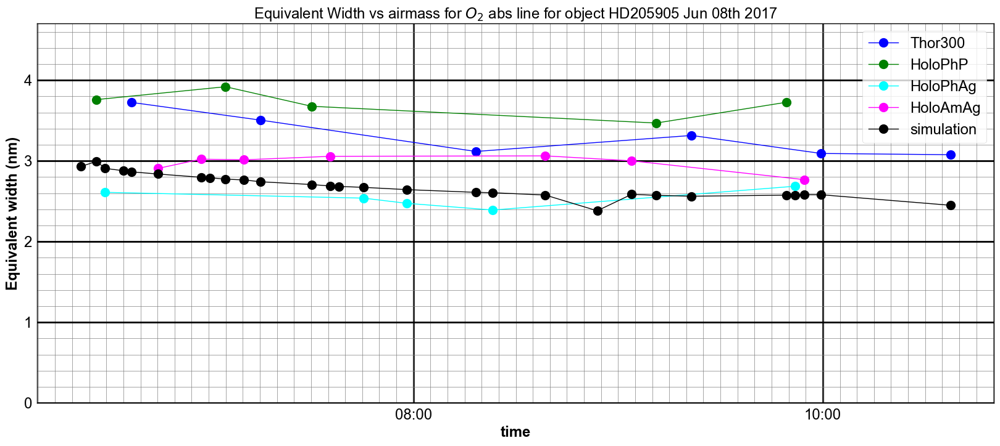

In [573]:
PlotEquivalentWidthVsTime(All_eqw_O2_Data,All_eqw_O2_Sim,am,all_dt,'$O_2$ abs line','eqwvstime_O2.pdf',all_filt1)

## Fit equivalent width

In [ ]:
def EqwModel(z,a,b):
    return np.exp(a*np.log(z))+b

In [576]:
def FitEquivalentWidthVsAirMass(all_eqw_width,all_eqw_width_sim,all_am,tagabsline,figname,all_filt1):
    """
    """
    am0 = []
    eqw0 = []
    
    am1 = []
    eqw1 = []
    
    am2 = []
    eqw2 = []
    
    am3 = []
    eqw3 = []
    
    am4 = []
    eqw4 = []
    
    amsim= []
    eqwsim= []
    
    max_y_to_plot=max(all_eqw_width)*1.2
    min_y_to_plot=0.
    
    zmin=1.
    zmax=2.
   
    # 1) Fill data
    
    for index,eqw in np.ndenumerate(all_eqw_width):
        idx=index[0]
        
        if all_filt1[idx]==u'FGB37':
            continue
            
            
        grating_name=all_filt[idx]
        am=all_am[idx]
        
        amsim.append(am)
        eqwsim.append(all_eqw_width_sim[idx])
        
        if re.search(ListOfDisperserNames[0],grating_name):
            am0.append(am)
            eqw0.append(eqw)
        elif re.search(ListOfDisperserNames[1],grating_name):
            am1.append(am)
            eqw1.append(eqw)
        elif re.search(ListOfDisperserNames[2],grating_name):
            am2.append(am)
            eqw2.append(eqw)
        elif re.search(ListOfDisperserNames[3],grating_name):
            am3.append(am)
            eqw3.append(eqw)
        elif re.search(ListOfDisperserNames[4],grating_name):
            am4.append(am)
            eqw4.append(eqw)
        else:
            print 'disperser ',grating_name,' not found'
    
    
    # 2) Fit and plot
    fig=plt.figure(figsize=(20,8))
    allz=np.linspace(zmin,zmax,50)
    ax=fig.add_subplot(1,1,1)

    am0=np.array(am0)
    eqw0=np.array(eqw0)
    popt0, pcov0 = curve_fit(EqwModel, am0, eqw0)
    print popt0
    labelfit0='fit : eqw=z^{:2.2f}+ {:2.2f}'.format(popt0[0],popt0[1])    
    ax.plot(am0,eqw0,marker='o',markersize='10',color='red',lw=0,label=ListOfDisperserNames[0])
    ax.plot(allz, EqwModel(allz, *popt0),'red', label=labelfit0)
    
    
    
    am1=np.array(am1)
    eqw1=np.array(eqw1)
    popt1, pcov1 = curve_fit(EqwModel, am1, eqw1)
    print popt1
    labelfit1='fit : eqw=z^{:2.2f}+ {:2.2f}'.format(popt1[0],popt1[1])
    ax.plot(am1,eqw1,marker='o',markersize='10',color='blue',lw=0,label=ListOfDisperserNames[1])
    ax.plot(allz, EqwModel(allz, *popt1),'blue', label=labelfit1)
    
    am2=np.array(am2)
    eqw2=np.array(eqw2)
    popt2, pcov2 = curve_fit(EqwModel, am2, eqw2)
    print popt2
    labelfit2='fit : eqw=z^{:2.2f}+ {:2.2f}'.format(popt2[0],popt2[1])   
    ax.plot(am2,eqw2,marker='o',markersize='10',color='green',lw=0,label=ListOfDisperserNames[2])
    ax.plot(allz, EqwModel(allz, *popt2),'green', label=labelfit2)
    
    
    am3=np.array(am3)
    eqw3=np.array(eqw3)
    popt3, pcov3 = curve_fit(EqwModel, am3, eqw3)
    print popt3
    labelfit3='fit : eqw=z^{:2.2f}+ {:2.2f}'.format(popt3[0],popt3[1])   
    ax.plot(am3,eqw3,marker='o',markersize='10',color='cyan',lw=0,label=ListOfDisperserNames[3])
    ax.plot(allz, EqwModel(allz, *popt3),'cyan', label=labelfit3)
    
    am4=np.array(am4)
    eqw4=np.array(eqw4)
    popt4, pcov4 = curve_fit(EqwModel, am4, eqw4)
    print popt4
    labelfit4='fit : eqw=z^{:2.2f}+ {:2.2f}'.format(popt4[0],popt4[1])   
    ax.plot(am4,eqw4,marker='o',markersize='10',color='magenta',lw=0,label=ListOfDisperserNames[4])
    ax.plot(allz, EqwModel(allz, *popt4),'magenta', label=labelfit4)
    
    
    amsim=np.array(amsim)
    eqwsim=np.array(eqwsim)
    poptsim, pcovsim = curve_fit(EqwModel, amsim, eqwsim)
    print poptsim
    labelfitsim='fit : eqw=z^{:2.2f}+ {:2.2f}'.format(poptsim[0],poptsim[1]) 
    ax.plot(amsim,eqwsim,marker='o',markersize='10',color='black',lw=0,label='sim')
    ax.plot(allz, EqwModel(allz, *poptsim),'black', label=labelfitsim)
    
    
    
    
    # Final
    ax.get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())   
    ax.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())

    ax.grid(b=True, which='major', color='k', linewidth=2.0)
    ax.grid(b=True, which='minor', color='grey', linewidth=0.5)

    ax.set_ylabel('Equivalent width (nm)')
    ax.set_xlabel('AirMass')
    ax.set_ylim(min_y_to_plot,max_y_to_plot)
    ax.set_xlim(0.92*zmin,zmax)


    title='Fit Equivalent Width vs airmass for {} for object {}'.format(tagabsline,object_name)

    plt.title(title)
    plt.legend(loc=2)

    figfilename=os.path.join(dir_top_images,figname)
    fig.savefig(figfilename)
 

[ 0.7850664   2.44840096]
[ 2.57913198  2.10809597]
[ 0.95994821  2.62220307]
[ 0.41213578  1.51171142]
[ 0.0920773  1.9688694]
[ 1.56206353  1.54733132]


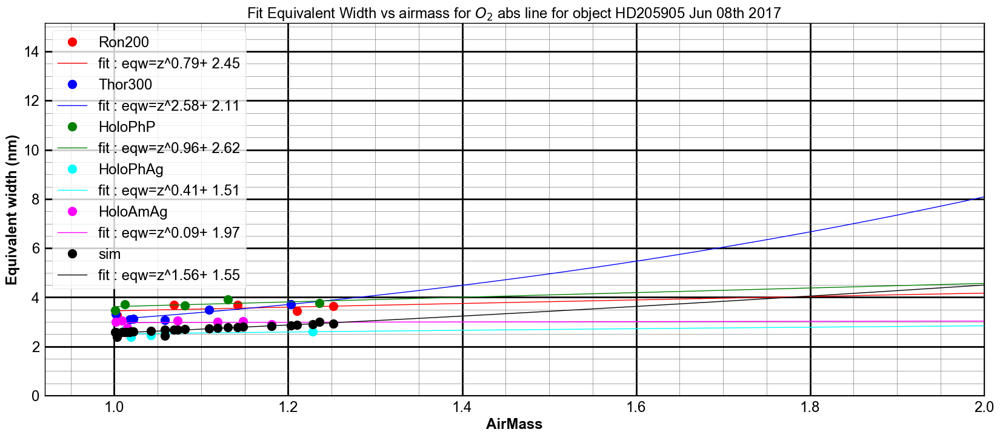

In [577]:
FitEquivalentWidthVsAirMass(All_eqw_O2_Data,All_eqw_O2_Sim,am,'$O_2$ abs line','fiteqwvsam_O2.pdf',all_filt1)

## B) H2O absorption line
-------------------------------

In [578]:
WL1_H2O_DATA=850
WL2_H2O_DATA=880
WL3_H2O_DATA=990
WL4_H2O_DATA=1000

In [579]:
WL1_H2O_SIM=WL1_H2O_DATA
WL2_H2O_SIM=WL2_H2O_DATA
WL3_H2O_SIM=WL3_H2O_DATA
WL4_H2O_SIM=WL4_H2O_DATA

In [580]:
sel=5
thespectrum,thewl,thelabel,thespecstaterr,wl_sim,spectrum_sim=SelectTheSpectrum(sel)
thetitle='$H_2O$ abs line (data) for {}'.format(thelabel)

EQW_H2O_DATA =  18.8798  nm


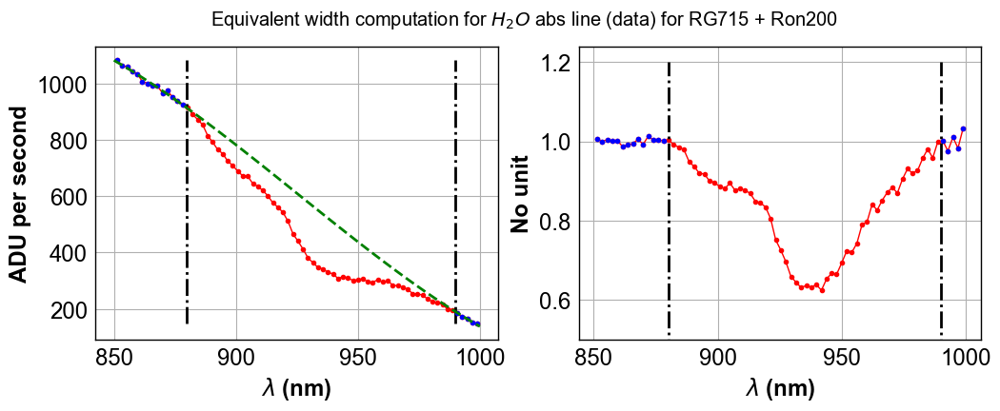

In [581]:
EQW_H2O_DATA = ShowEquivalentWidth2NonLinear(thewl,thespectrum,WL1_H2O_DATA,WL2_H2O_DATA,WL3_H2O_DATA,WL4_H2O_DATA,thetitle,ndeg=3)
print 'EQW_H2O_DATA = ',EQW_H2O_DATA, ' nm'

EQW_H2O_DATA =  17.7066  +/- 2.36277548422  nm


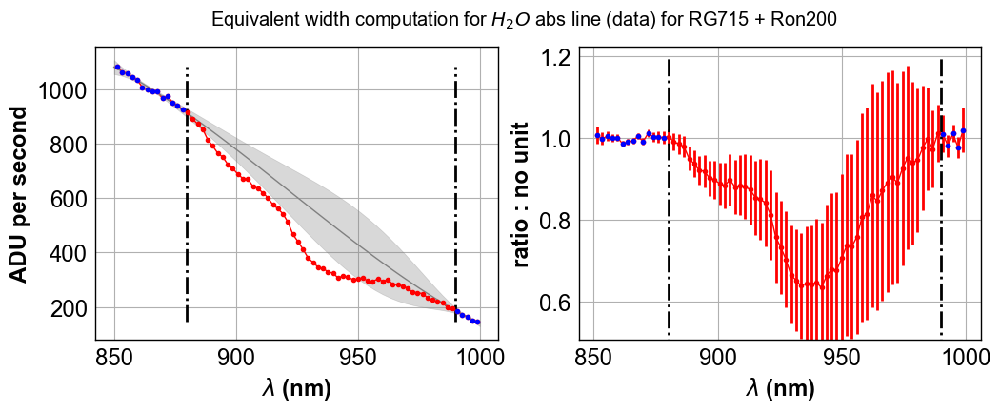

In [582]:
EQW_H2O_DATA, EQW_H2O_DATA_Err = ShowEquivalentWidth2NonLinearwthStatErr(thewl,thespectrum,thespecstaterr,WL1_H2O_DATA,WL2_H2O_DATA,WL3_H2O_DATA,WL4_H2O_DATA,thetitle,ndeg=3)
print 'EQW_H2O_DATA = ',EQW_H2O_DATA, ' +/-', EQW_H2O_DATA_Err,' nm'

EQW_H2O_SIM =   14.4678427641  nm


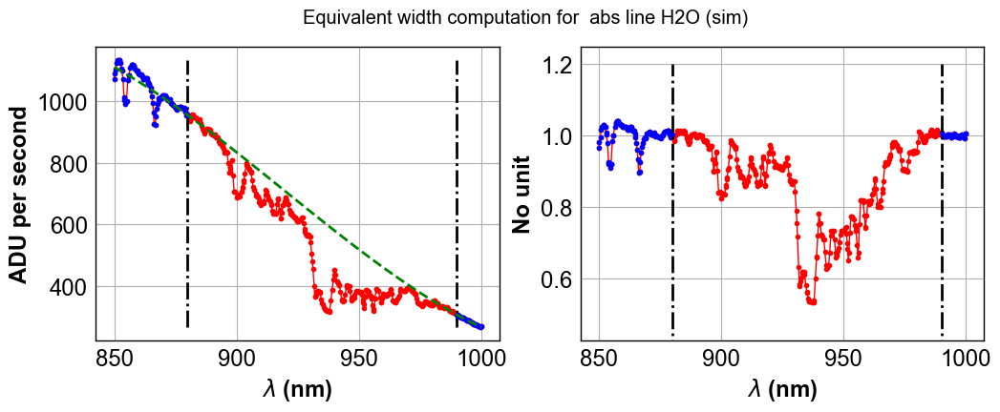

In [583]:
EQW_H2O_SIM = ShowEquivalentWidth2NonLinear(wl_sim,spectrum_sim,WL1_H2O_SIM,WL2_H2O_SIM,WL3_H2O_SIM,WL4_H2O_SIM,' abs line H2O (sim)',ndeg=3)
print 'EQW_H2O_SIM =  ' ,EQW_H2O_SIM, ' nm'

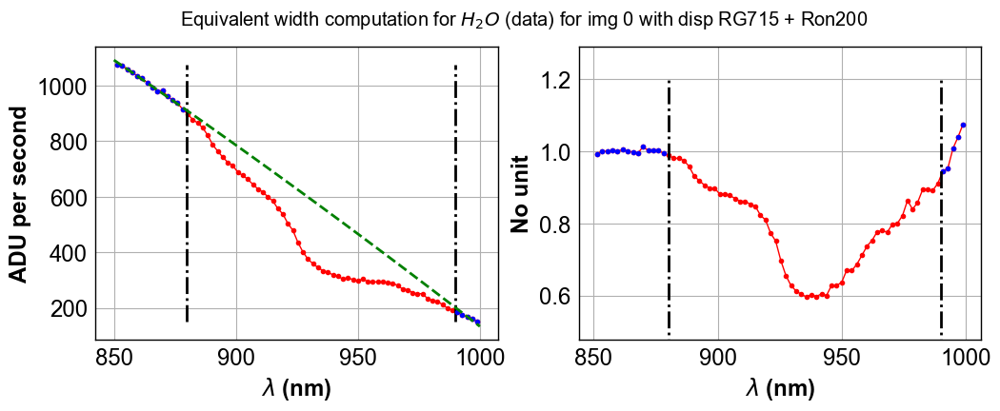

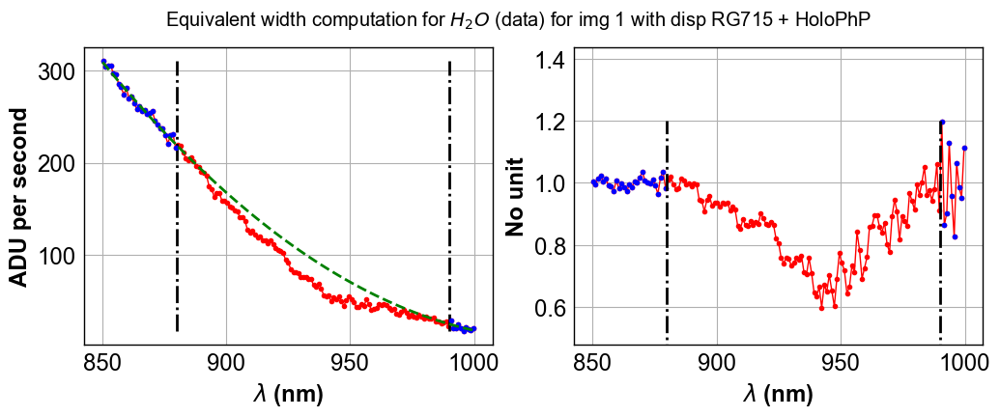

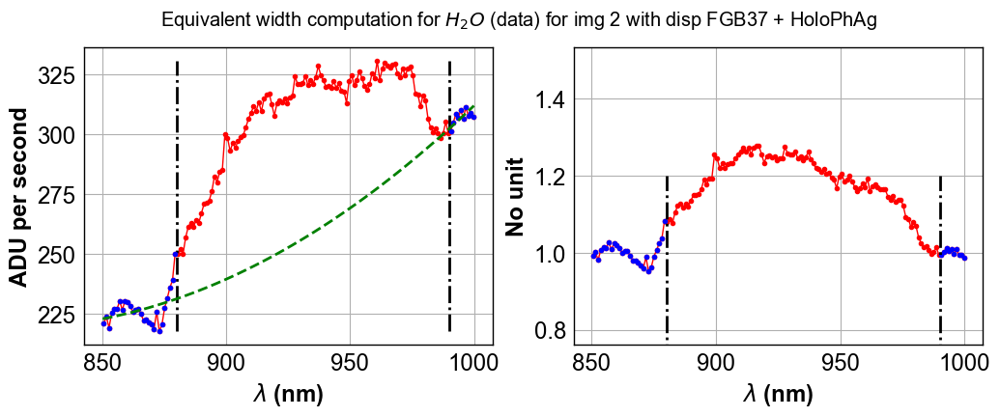

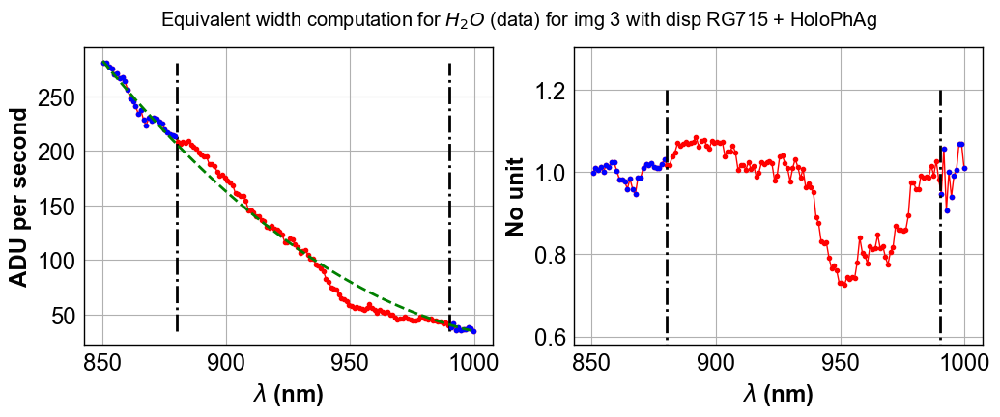

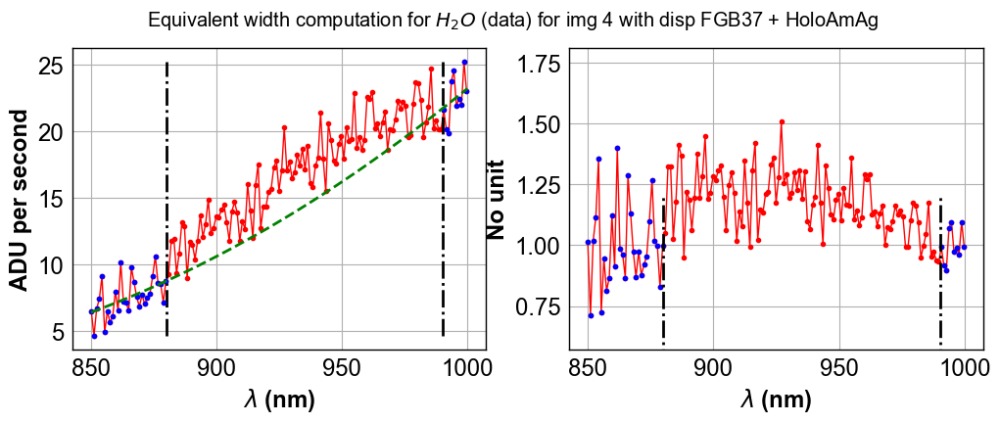

...

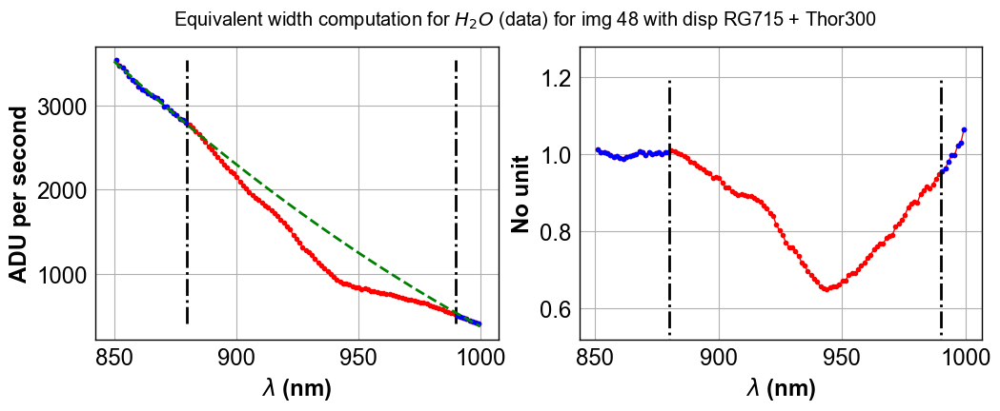

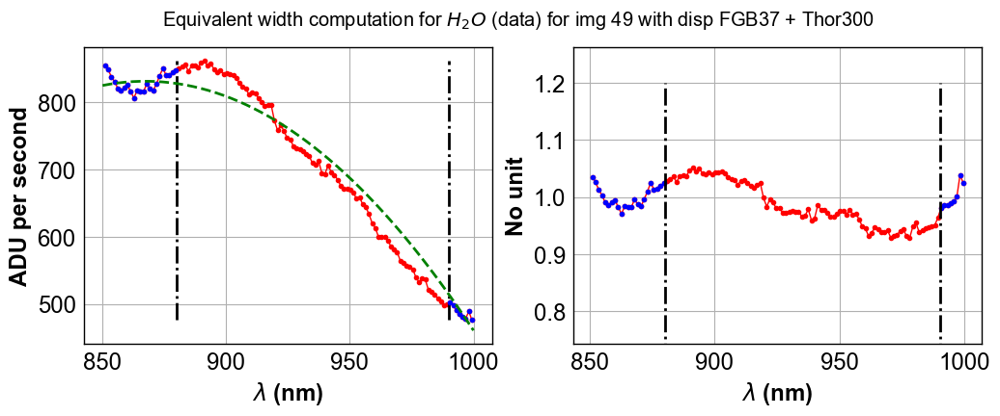

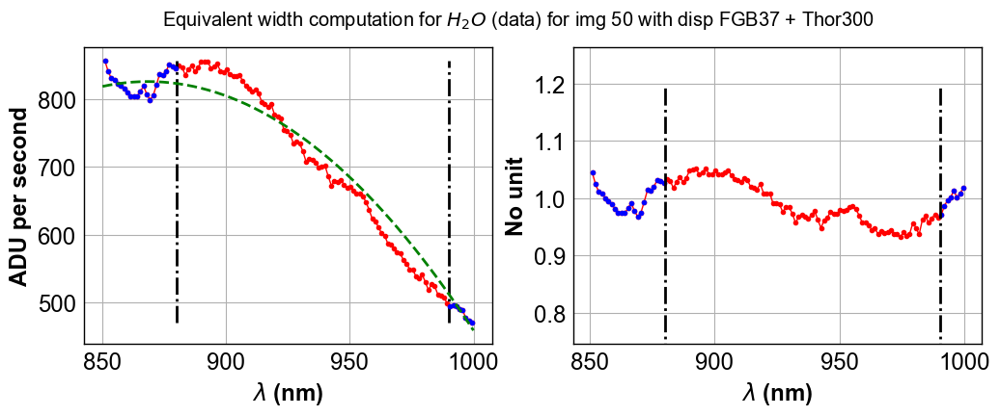

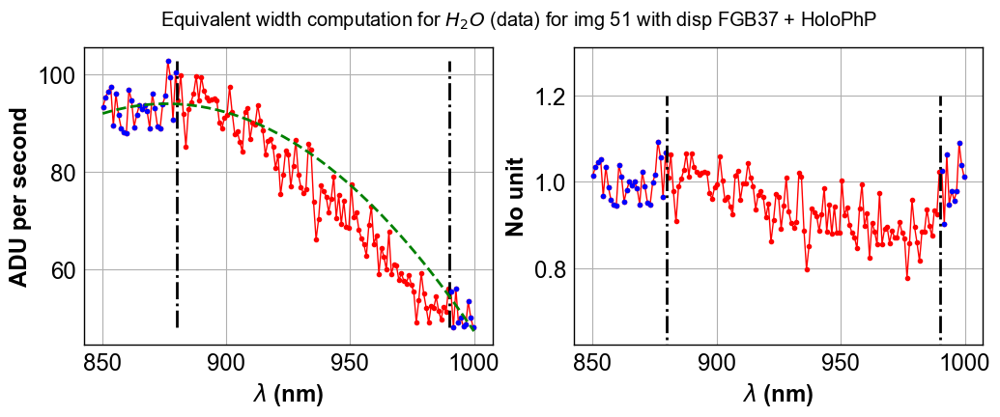

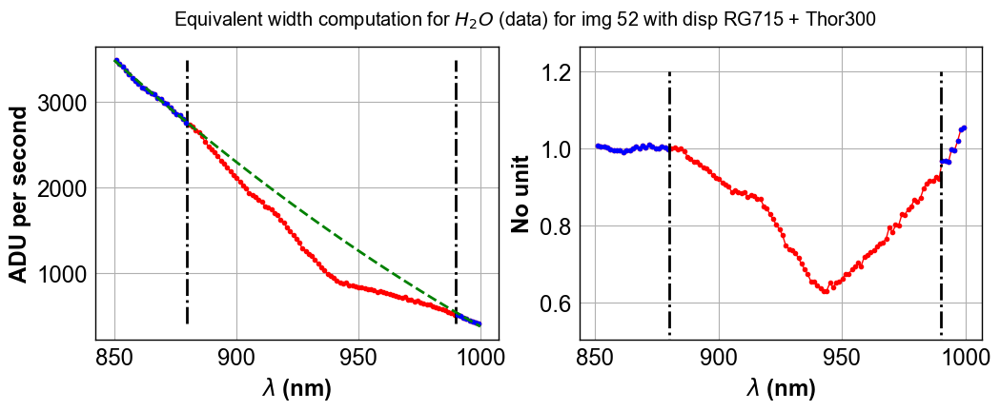

In [584]:
ShowAllEquivalentWidthNonLinear(all_rightspectra_wl,all_rightspectra_data,'$H_2O$ (data)',ndeg=2,absline='H2O')

21.414  nm 1.77292543778  nm
16.1887  nm 0.822140516368  nm
-19.8968  nm 0.659945030885  nm
4.59476  nm 0.918352977898  nm
-18.9771  nm 0.671406621482  nm
22.0187  nm 1.83042262784  nm
20.8268  nm 1.59185167061  nm
14.5622  nm 0.389021153722  nm
2.60402  nm 2.04141240496  nm
11.6718  nm 0.271601630201  nm
21.3945  nm 3.11707100506  nm
18.851  nm 0.818695246907  nm
-19.7068  nm 0.684695581737  nm
10.3497  nm 0.408549507133  nm
2.29068  nm 2.05875821584  nm
20.304  nm 1.76277806854  nm
3.60905  nm 0.909471172551  nm
15.9754  nm 0.547460323529  nm
11.9884  nm 0.361778477084  nm
21.8649  nm 1.75043036834  nm
7.21949  nm 0.703434844684  nm
1.8215  nm 1.77021892117  nm
7.09673  nm 0.331309597564  nm
-12.5764  nm 0.564677937731  nm
7.71598  nm 3.01023183175  nm
2.0811  nm 1.36869122758  nm
19.3657  nm 0.995184841146  nm
8.38877  nm 0.54335673127  nm
6.29368  nm 3.90678170075  nm
1.95937  nm 1.70982713975  nm
-0.947568  nm 1.40424214344  nm
-16.9603  nm 0.471746851418  nm
12.5108  nm 0.2296327

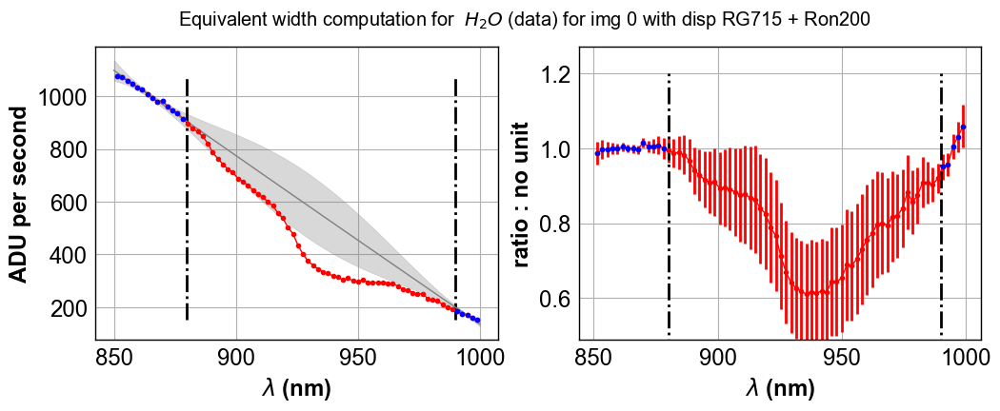

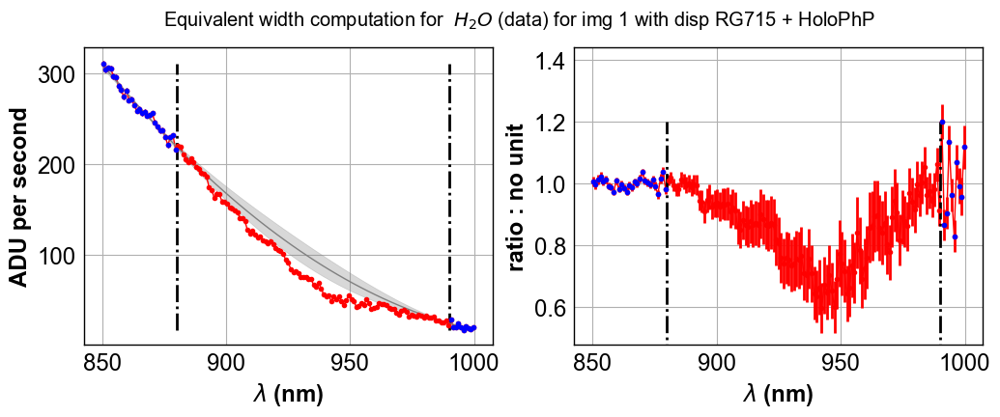

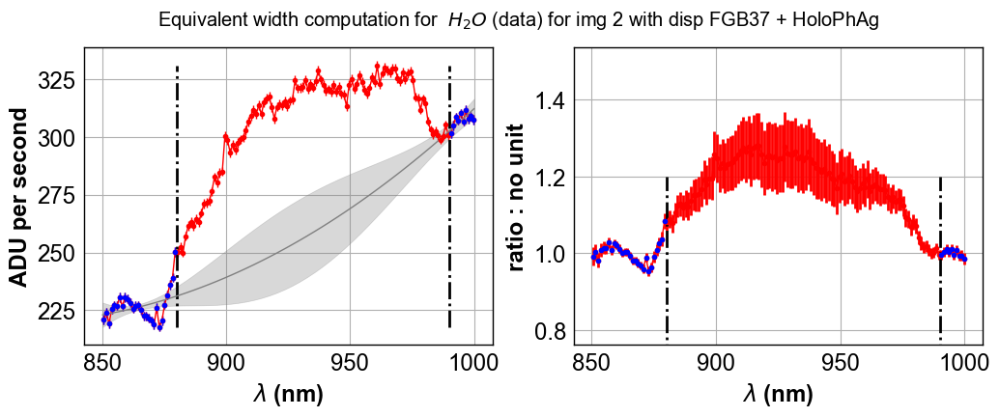

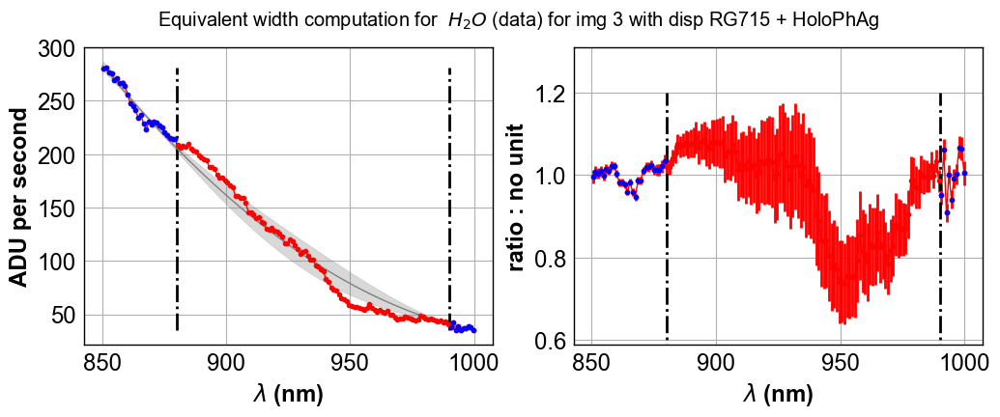

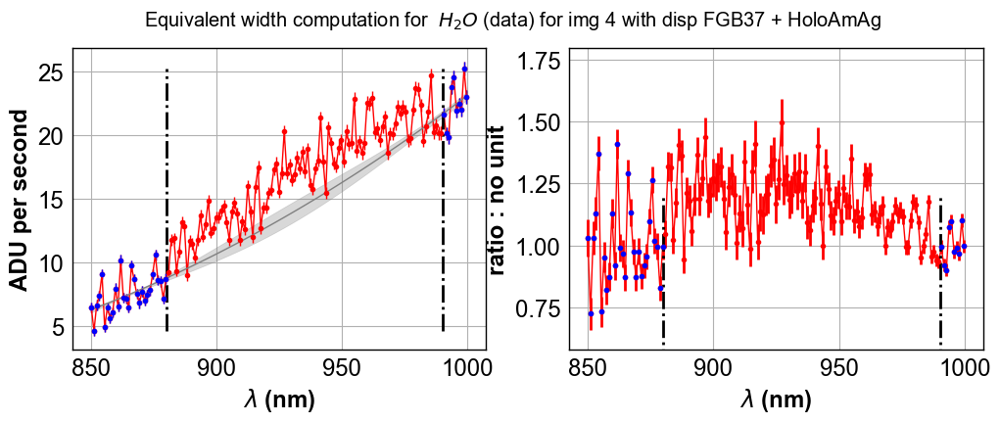

...

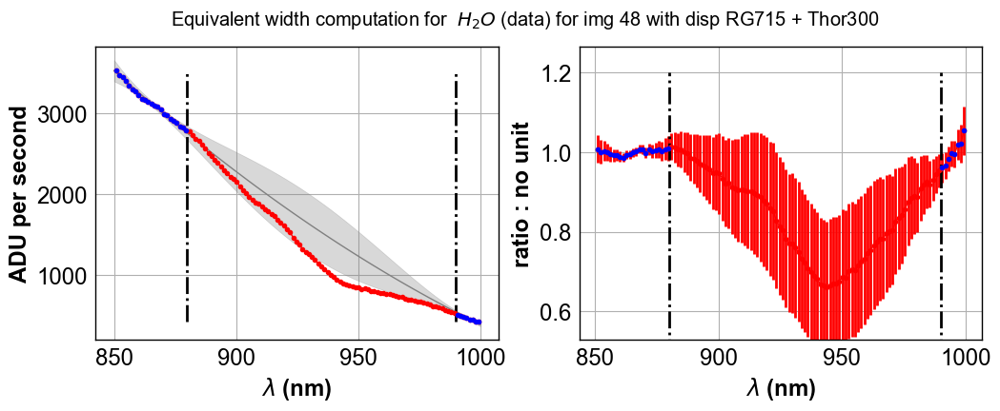

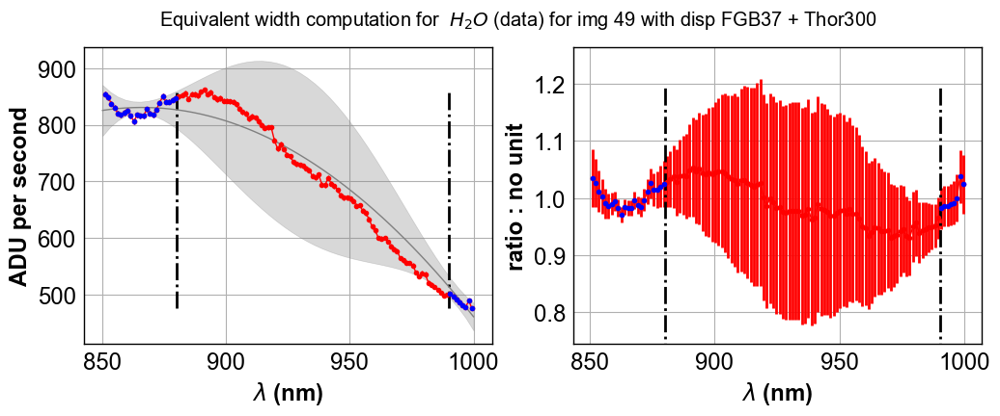

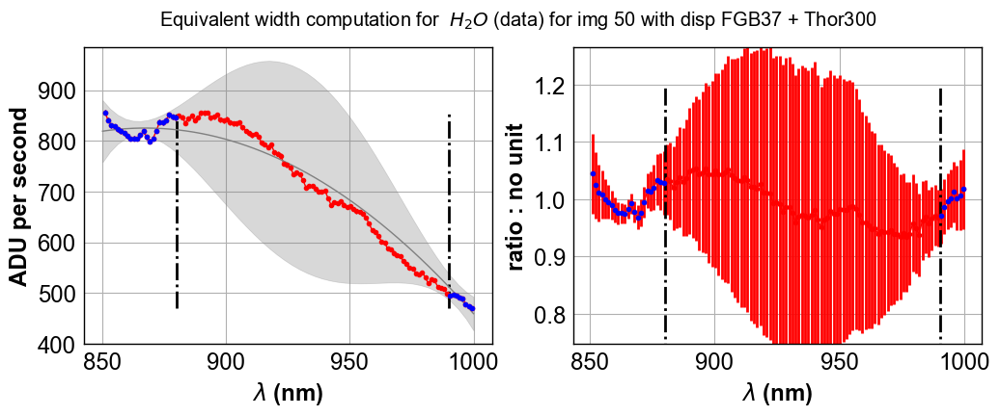

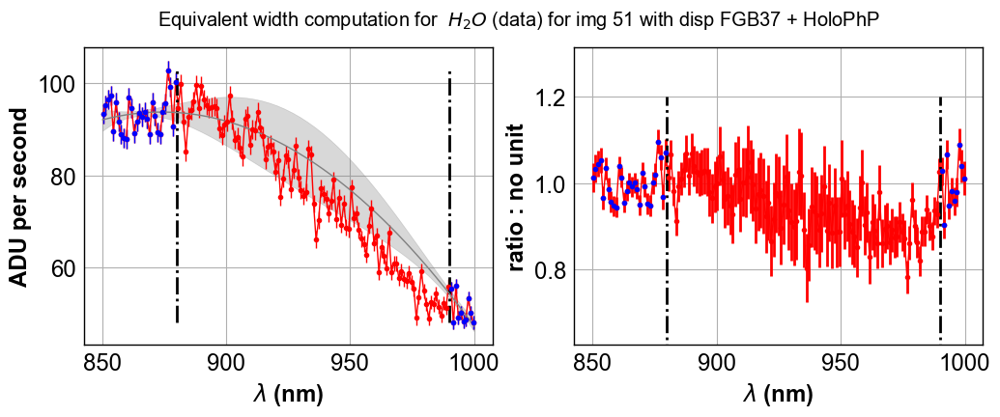

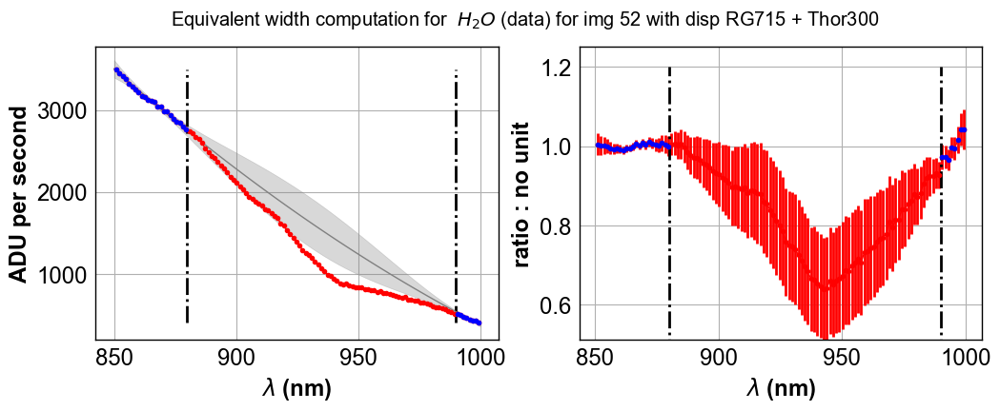

In [585]:
ShowAllEquivalentWidthNonLinearwthStatErr(all_rightspectra_wl,all_rightspectra_data,all_rightspectra_data_staterr,' $H_2O$ (data)',ndeg=2,absline='H2O')

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:43: RuntimeWarning: invalid value encountered in divide


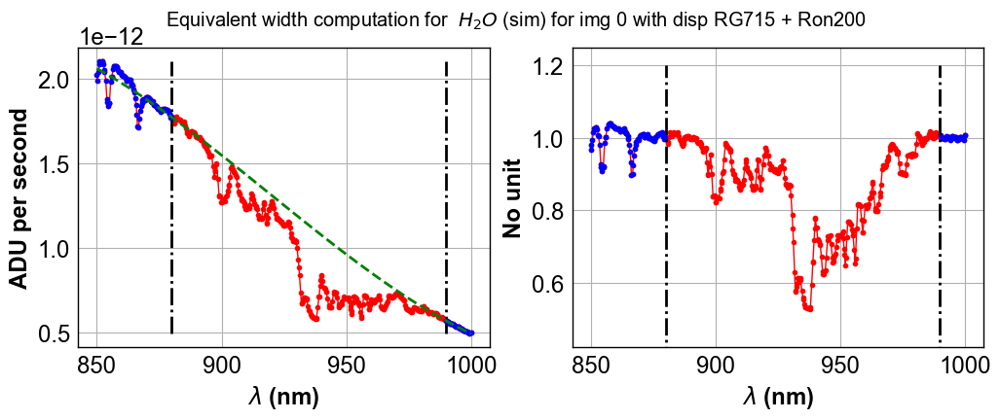

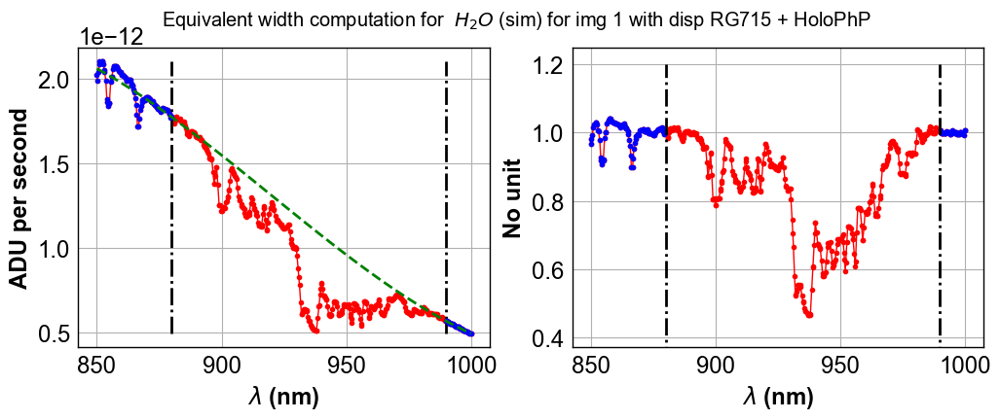

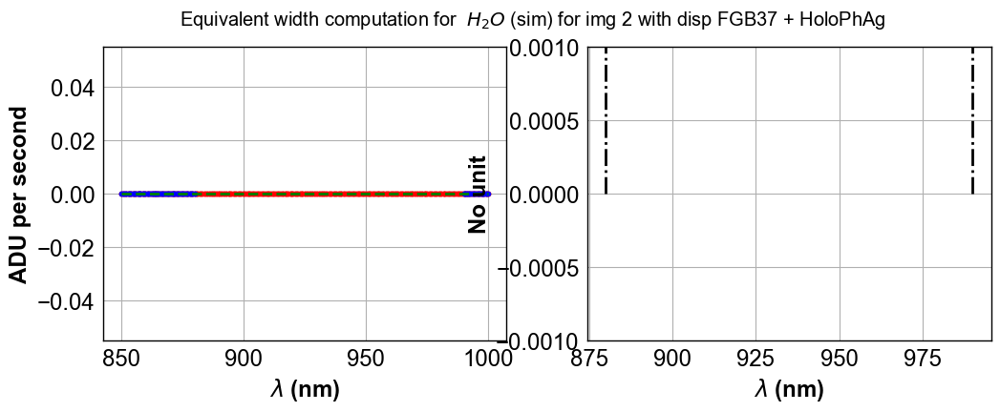

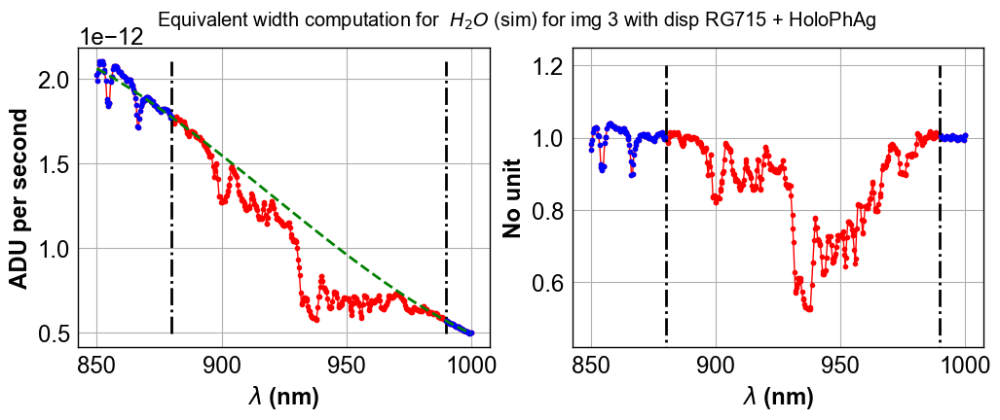

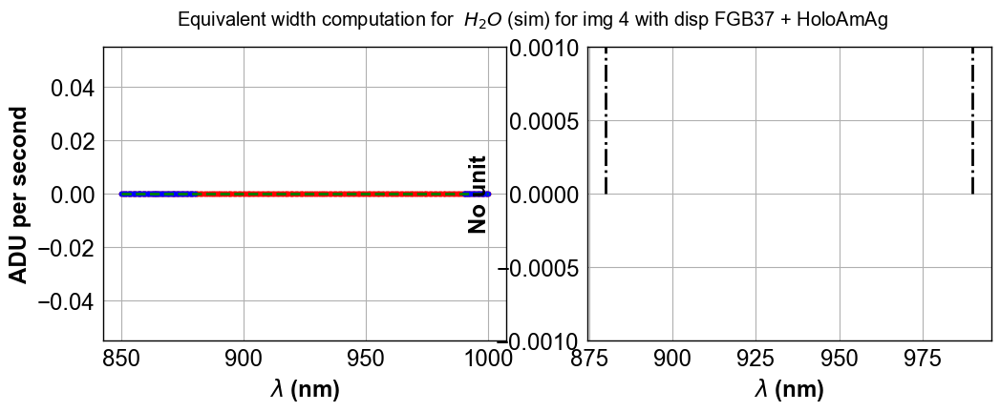

...

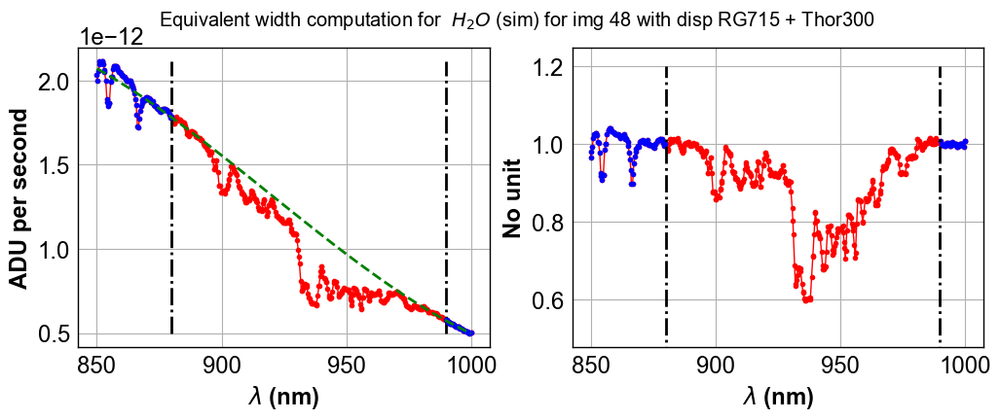

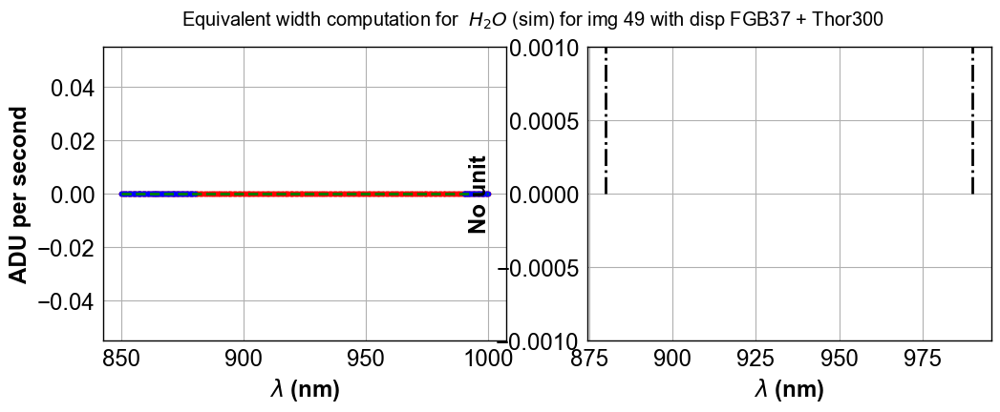

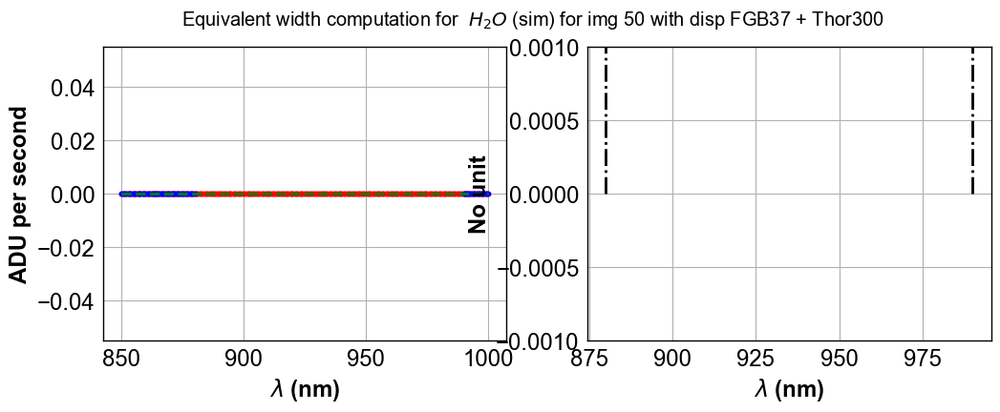

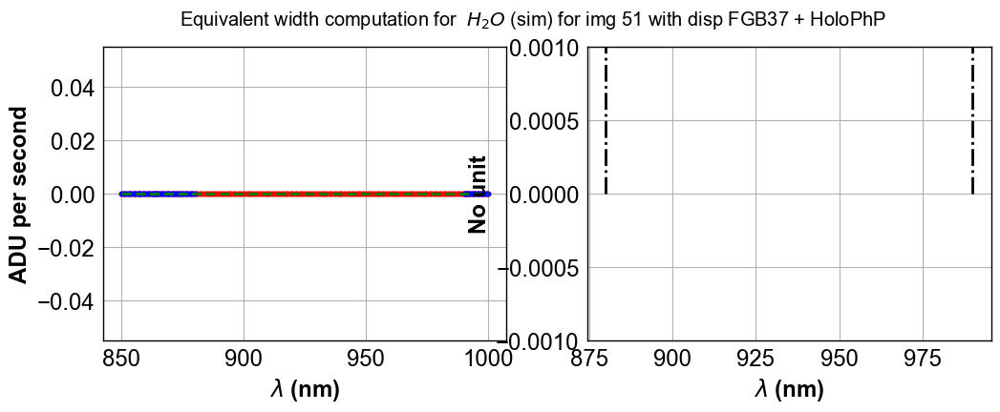

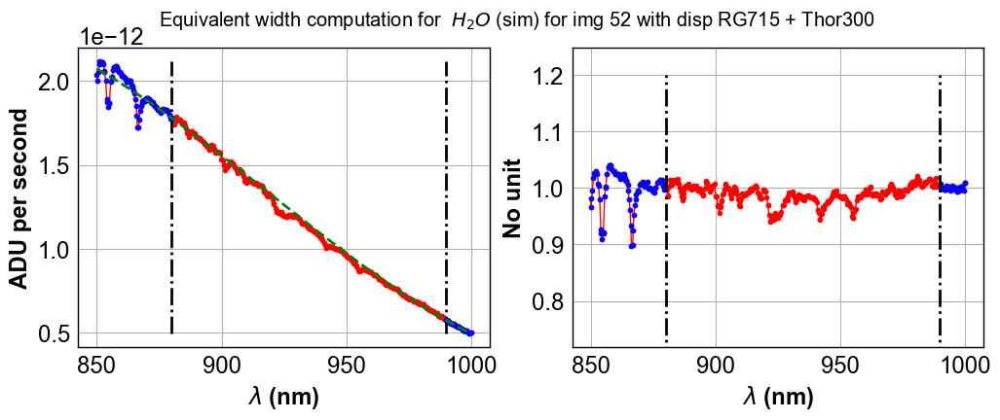

In [586]:
ShowAllEquivalentWidthNonLinear(allwl_sim,allspectra_sim,' $H_2O$ (sim)',ndeg=3,absline='simH2O')

In [587]:
#ShowAllEquivalentWidth(allwl_sim,allspectra_sim,WL1_H2O_SIM,WL2_H2O_SIM,WL3_H2O_SIM,WL4_H2O_SIM,' H2O (sim)')

In [588]:
All_eqw_H2O_Data=ComputeAllEquivalentWidthNonLinear(all_rightspectra_wl,all_rightspectra_data,ndeg=3,absline='H2O')

In [589]:
print All_eqw_H2O_Data

[15.817543, 19.41103, -15.38888, 7.5238247, -40.507435, 18.879761, 18.542336, 11.255991, 2.7893376, 13.45186, 15.028692, 21.882072, -16.902605, 9.1138678, 1.6188319, 17.995354, 1.9787661, 21.045086, 10.699093, 17.470886, 15.177782, 3.1563365, 11.790811, -20.057981, 8.0552807, 1.8855894, 17.176777, 14.477922, -98.131454, 3.586133, -6.4145012, -12.260172, 13.721657, -0.65076292, 14.364166, 0.15545377, 14.232599, 1.8583218, 19.6619, 2.4807372, 14.890355, 14.434099, 2.8773022, 1.2770534, 23.431576, 17.426798, -19.838491, 15.323567, 16.211191, 0.54578483, 2.5220761, 7.1288004, 17.10532]


In [590]:
All_eqw_H2O_Data,All_eqw_H2O_Data_Err=ComputeAllEquivalentWidthNonLinearwthStatErr(all_rightspectra_wl,all_rightspectra_data,all_rightspectra_data_staterr,ndeg=3,absline='H2O')

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:35: RankWarning: Polyfit may be poorly conditioned
/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/li

In [591]:
print All_eqw_H2O_Data

[15.817543, 14.659481, -19.843422, 4.6028929, -19.989185, 18.879761, 18.542336, 16.439098, 2.7893376, 11.592224, 15.028692, 16.802483, -19.665909, 11.791817, 1.6188319, 17.995354, 4.8680735, 13.595947, 13.370573, 17.470886, 4.9155698, 3.1563365, 5.8179359, -12.081818, 8.0552807, 1.8855894, 17.176777, 7.2720289, -98.131454, 3.586133, 0.48541808, -16.924295, 12.284279, -0.65076292, 14.364166, 0.15545377, 12.299783, 1.8583218, 15.882186, 2.4807372, 14.890355, -4.8941445, -11.759871, 2.1076272, 17.245152, 10.088243, -13.639234, 14.772345, 16.211191, 0.54578483, 2.5220761, 7.077477, 17.10532]


In [592]:
All_eqw_H2O_Sim=ComputeAllEquivalentWidthNonLinear(allwl_sim,allspectra_sim,ndeg=3,absline='simH2O')

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:26: RuntimeWarning: invalid value encountered in divide


In [593]:
print All_eqw_H2O_Sim

[14.700146234789509, 17.323165782580162, nan, 14.798982021888762, nan, 14.467842764078423, 14.359626186271278, 14.158132771075786, nan, 14.032740678436193, 14.043213307480997, 13.911175993987509, nan, 14.036553179259, nan, 13.751851022470705, nan, 13.698813503641095, 13.385487273888899, 13.35608328446785, 13.42820249745569, nan, 13.101423193353583, nan, nan, nan, 12.741130887082445, 12.718875075290937, nan, nan, nan, nan, 12.065507491968029, nan, 1.2370296279875437, nan, 12.751723394217736, nan, 12.322039745169992, nan, 11.835713770535868, nan, nan, nan, 11.860387035509804, 11.821278082732709, nan, 11.927889831293438, 11.759740686723017, nan, nan, nan, 1.2366925179908732]


In [594]:
All_eqw_H2O_Data=np.array(All_eqw_H2O_Data)
All_eqw_H2O_Sim=np.array(All_eqw_H2O_Sim)

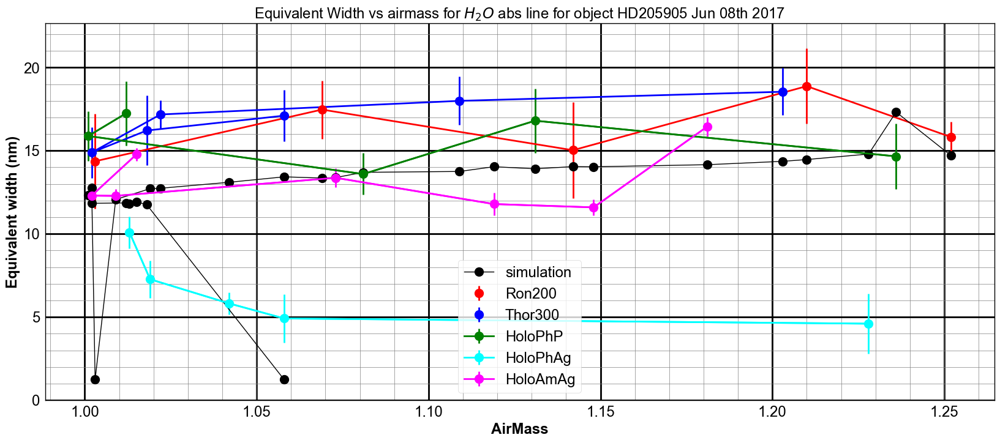

In [595]:
PlotEquivalentWidthVsAirMass(All_eqw_H2O_Data,All_eqw_H2O_Data_Err,All_eqw_H2O_Sim,am,'$H_2O$ abs line','eqwvsam_H2O.pdf',all_filt1)

[  4.207616    14.53426097]
[  6.90109814  15.25272468]
[-27.56096091  15.26784331]
[-22.93436474   6.12619151]
[  5.63924062  11.61331362]
[  8.08386515  10.19787089]


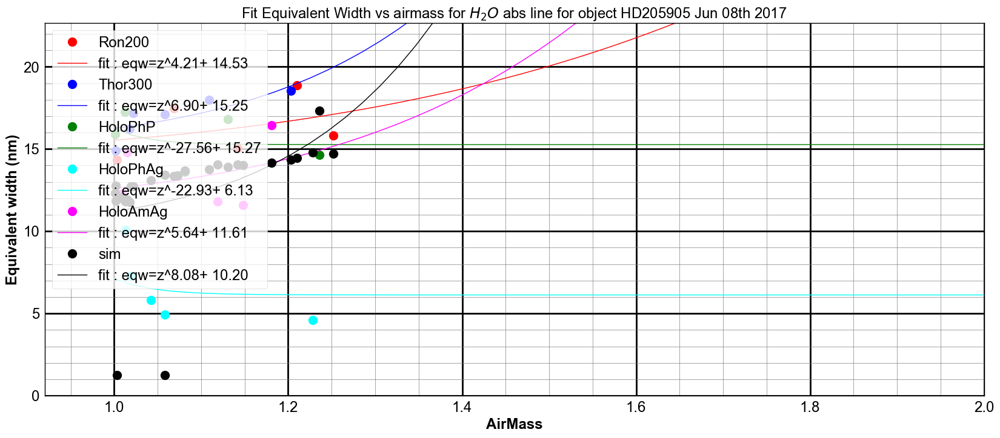

In [596]:
FitEquivalentWidthVsAirMass(All_eqw_H2O_Data,All_eqw_H2O_Sim,am,'$H_2O$ abs line','fiteqwvsam_H2O.pdf',all_filt1)

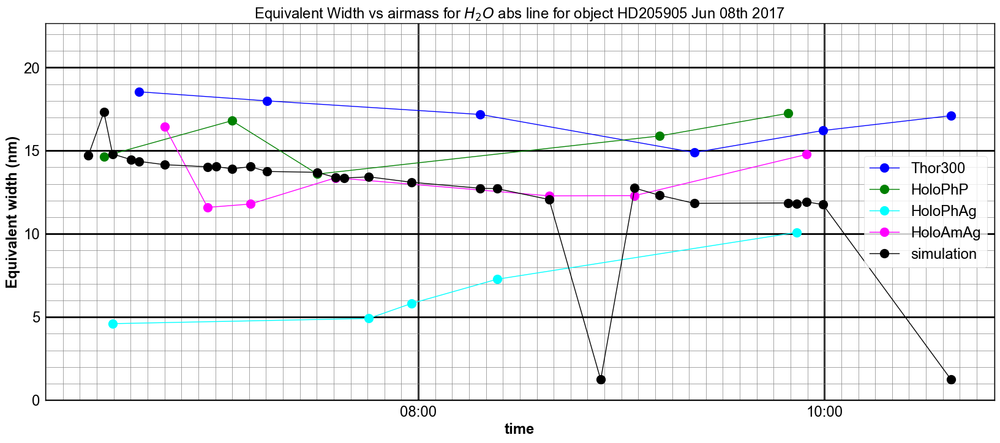

In [597]:
PlotEquivalentWidthVsTime(All_eqw_H2O_Data,All_eqw_H2O_Sim,am,all_dt,'$H_2O$ abs line','eqwvstime_H20.pdf',all_filt1)

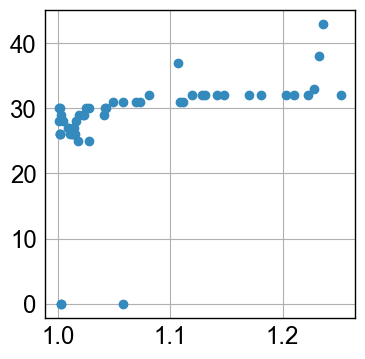

In [598]:
plt.plot(am,all_hum,'o')

In [599]:
X=All_eqw_H2O_Sim/All_eqw_O2_Sim

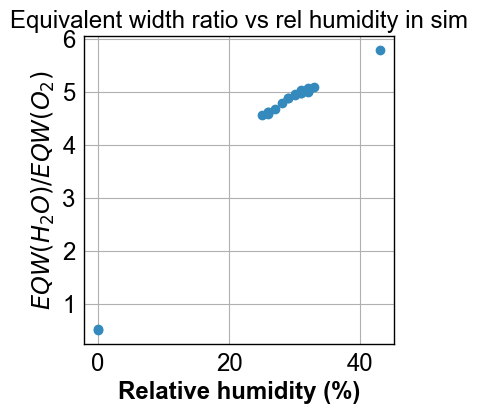

In [600]:
plt.plot(all_hum,X,'o')
plt.xlabel("Relative humidity (%)")
plt.ylabel("$EQW(H_2O)/EQW(O_2)$")
plt.title("Equivalent width ratio vs rel humidity in sim")

In [601]:
print Thor300_index
print Ron400_index
print Ron200_index
print HoloPhP_index
print HoloPhAg_index
print HoloAmAg_index

[ 6  8 14 15 21 25 26 29 35 37 39 40 48 49 50 52]
[]
[ 0  5 10 19 24 28 33 34]
[ 1 11 16 17 30 38 41 43 44 51]
[ 2  3 12 20 22 27 45]
[ 4  7  9 13 18 23 31 32 36 42 46 47]


In [602]:
X_Thor=All_eqw_H2O_Sim[Thor300_index]/All_eqw_O2_Sim[Thor300_index]
Y_Thor=All_eqw_H2O_Data[Thor300_index]/All_eqw_O2_Data[Thor300_index]

In [603]:
X_R200=All_eqw_H2O_Sim[Ron200_index]/All_eqw_O2_Sim[Ron200_index]
Y_R200=All_eqw_H2O_Data[Ron200_index]/All_eqw_O2_Data[Ron200_index]

In [604]:
X_HoloPhP=All_eqw_H2O_Sim[HoloPhP_index]/All_eqw_O2_Sim[HoloPhP_index]
Y_HoloPhP=All_eqw_H2O_Data[HoloPhP_index]/All_eqw_O2_Data[HoloPhP_index]

In [605]:
X_HoloPhAg=All_eqw_H2O_Sim[HoloPhAg_index]/All_eqw_O2_Sim[HoloPhAg_index]
Y_HoloPhAg=All_eqw_H2O_Data[HoloPhAg_index]/All_eqw_O2_Data[HoloPhAg_index]

In [606]:
X_HoloAmAg=All_eqw_H2O_Sim[HoloAmAg_index]/All_eqw_O2_Sim[HoloAmAg_index]
Y_HoloAmAg=All_eqw_H2O_Data[HoloAmAg_index]/All_eqw_O2_Data[HoloAmAg_index]

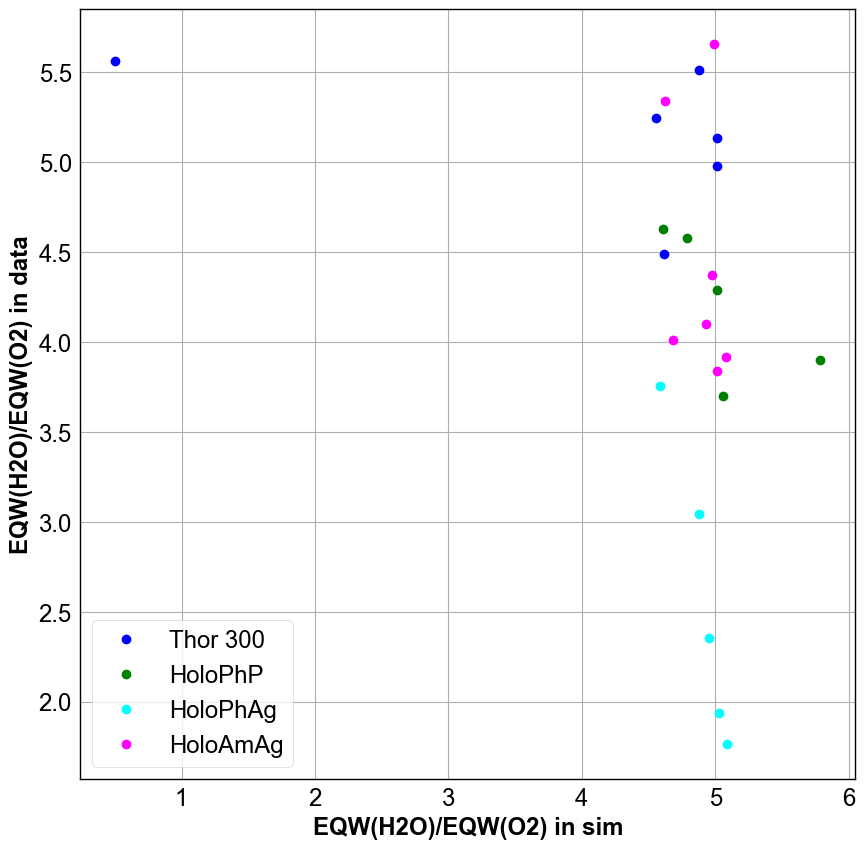

In [607]:
plt.figure(figsize=(10,10))
plt.plot(X_Thor,Y_Thor,'bo',label='Thor 300')
plt.plot(X_HoloPhP,Y_HoloPhP,'go',label='HoloPhP')
plt.plot(X_HoloPhAg,Y_HoloPhAg,'o',color="cyan",label='HoloPhAg')
plt.plot(X_HoloAmAg,Y_HoloAmAg,'o',color="magenta",label='HoloAmAg')
plt.xlabel('EQW(H2O)/EQW(O2) in sim')
plt.ylabel('EQW(H2O)/EQW(O2) in data')
plt.legend()

## Save pandas file

In [608]:
df=pd.DataFrame()

In [609]:
df["airmass"]=all_airmass
df["time"]=all_dates
df["filter"]=all_filt1
df["disperser"]=all_filt2
df["humidity"]=all_hum
df["EQW_O2_DATA"]= All_eqw_O2_Data
df["EQW_H2O_DATA"]= All_eqw_H2O_Data
df["EQW_O2_DATA_ERR"]= All_eqw_O2_Data_Err
df["EQW_H2O_DATA_ERR"]= All_eqw_H2O_Data_Err
df["EQW_O2_SIM"]= All_eqw_O2_Sim
df["EQW_H2O_SIM"]= All_eqw_H2O_Sim

In [610]:
df

,airmass,time,filter,disperser,humidity,EQW_O2_DATA,EQW_H2O_DATA,EQW_O2_DATA_ERR,EQW_H2O_DATA_ERR,EQW_O2_SIM,EQW_H2O_SIM
0,1.252,2017-06-09T06:22:28.198,RG715,Ron200,32.0,3.653414,15.817543,0.165502,0.927898,2.929822,14.700146
1,1.236,2017-06-09T06:27:05.648,RG715,HoloPhP,43.0,3.759785,14.659481,0.100636,1.979650,2.994206,17.323166
2,1.232,2017-06-09T06:28:15.158,FGB37,HoloPhAg,38.0,-1.875614,-19.843422,0.246936,4.168240,20.493088,NaN
3,1.228,2017-06-09T06:29:39.401,RG715,HoloPhAg,33.0,2.610394,4.602893,0.028059,1.808472,2.907092,14.798982
4,1.223,2017-06-09T06:31:05.855,FGB37,HoloAmAg,32.0,9.285541,-19.989185,12.087881,5.327651,20.373238,NaN
5,1.210,2017-06-09T06:35:02.806,RG715,Ron200,32.0,3.449693,18.879761,0.477676,2.269740,2.878126,14.467843
6,1.203,2017-06-09T06:37:23.602,RG715,Thor300,32.0,3.724896,18.542336,0.436462,1.416517,2.864244,14.359626
7,1.181,2017-06-09T06:45:05.197,RG715,HoloAmAg,32.0,2.906662,16.439098,0.056545,0.594445,2.837558,14.158133
8,1.170,2017-06-09T06:48:51.355,FGB37,Thor300,32.0,-1.358668,2.789338,0.192268,11.035624,20.342969,NaN
9,1.148,2017-06-09T06:57:44.001,RG715,HoloAmAg,32.0,3.021617,11.592224,0.034848,0.489505,2.797097,14.032741


In [611]:
fulloutput=os.path.join(outputdir,output_file)

In [612]:
fulloutput

'./spectrum_eqwana/AnaEqWdtFromSpectra_HD205905_Jun_08th.csv'

In [613]:
df.to_csv(fulloutput)